## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'spaceNet-full' 
TRANSFORM = 'learned'
CHANNEL = ''

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
learned_full_spaceNet.ipynb


In [3]:
import git
from pathlib import Path
import os

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/spaceNet/full/learned'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))
nonskewed_df = pd.read_csv(os.path.join(ROOT_DIR, 'learned-filters', 'nonskewed_filter_idxs_df.csv')).set_index(['dataset', 'num_images', 'num_bootstrap'])
nonskewed_filter_idxs = eval(nonskewed_df.loc[DATA_NAME].sort_values('num_images', ascending=False)['nonskewed_filter_idxs'].iloc[0])
filter_group_map = pd.read_pickle(os.path.join(ROOT_DIR, 'learned-filters', 'filter_group_map.pickle'))

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 480000000,
 1: 480000000,
 2: 480000000,
 3: 480000000,
 4: 480000000,
 5: 480000000,
 6: 480000000,
 7: 480000000,
 8: 480000000,
 9: 480000000,
 10: 480000000,
 11: 480000000,
 12: 480000000,
 13: 480000000,
 14: 480000000,
 15: 480000000,
 16: 480000000,
 17: 480000000,
 18: 480000000,
 19: 480000000,
 20: 480000000,
 21: 480000000,
 22: 480000000,
 23: 480000000,
 24: 480000000,
 25: 480000000,
 26: 480000000,
 27: 480000000,
 28: 480000000,
 29: 480000000,
 30: 480000000,
 31: 480000000,
 32: 480000000,
 33: 480000000,
 34: 480000000,
 35: 480000000,
 36: 480000000,
 37: 480000000,
 38: 480000000,
 39: 480000000,
 40: 480000000,
 41: 480000000,
 42: 480000000,
 43: 480000000,
 44: 480000000,
 45: 480000000,
 46: 480000000,
 47: 480000000,
 48: 480000000,
 49: 480000000,
 50: 480000000,
 51: 480000000,
 52: 480000000,
 53: 480000000,
 54: 480000000,
 55: 480000000,
 56: 480000000,
 57: 480000000,
 58: 480000000,
 59: 480000000,
 60: 480000000,
 61: 480000000,
 62: 480000000,
 6

Running 12760 CDFs


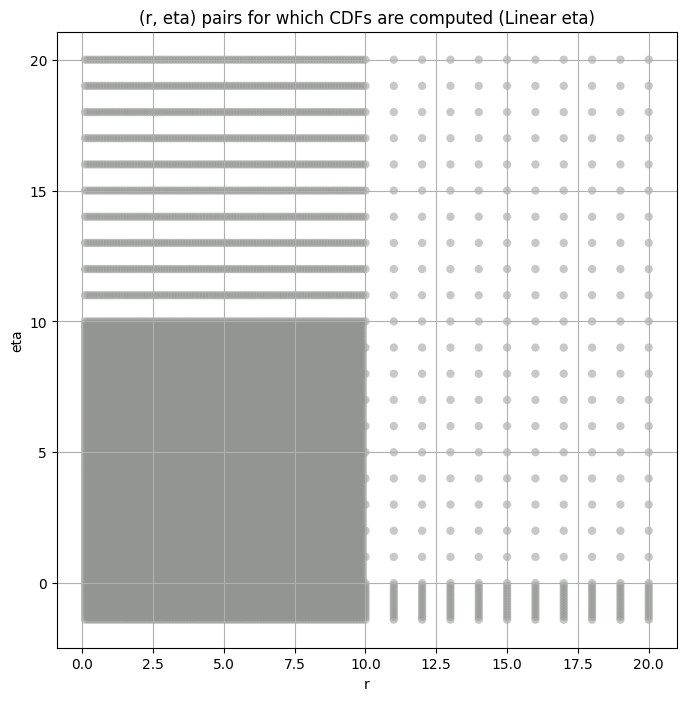

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = filter_group_map[group]

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 42


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 43


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 44


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 45


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 46


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 47


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 48


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 49


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 50


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 52


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 54


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 55


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 56


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 57


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 58


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 59


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 60


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 61


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 62


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 63


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,57.214930,36.411798,123.231320,41.285444,8.164086,290.107658,480000000.0,dual_color
2,82.084655,53.717774,153.965127,37.569183,8.917034,238.811972,480000000.0,dual_color
3,22.611322,14.994184,56.104513,71.905866,6.891111,399.202547,480000000.0,single_edge
4,94.077089,65.025735,156.865921,21.475630,7.446571,115.107643,480000000.0,dual_color
5,57.483240,41.660774,87.700814,15.550781,5.322732,125.788486,480000000.0,dual_color
6,43.728233,28.124144,96.209185,43.878386,6.806653,310.438016,480000000.0,single_edge
7,24.626245,18.353888,40.167357,15.670190,3.287687,146.797712,480000000.0,inside_out
8,1.924674,1.357594,6.607376,122.928559,3.710739,541.449082,480000000.0,misc
9,9.369960,5.267412,83.557988,993.476242,6.442853,796.346524,480000000.0,multi_edge


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,57.214930,57.214930,50.193220,47.067690,42.799264
2,82.084655,82.084655,72.355173,67.828178,61.498054
3,22.611322,22.611322,19.578486,18.411745,16.819467
4,94.077089,94.077089,85.687383,81.287691,74.850920
5,57.483240,57.483240,53.189323,50.966374,47.706244
6,43.728233,43.728233,38.498728,36.190036,33.020688
7,24.626245,24.626245,22.788769,21.916147,20.675570
8,1.924674,1.924674,1.680118,1.605894,1.504162
9,9.369960,9.369960,7.065595,6.618074,6.036023


####
Filter_idx  0


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.027061358860066054 57.21493021594356


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.026880174232892795 50.19321977097515


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.027295782563021342 47.067689970479776


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.027207647889689546 42.79926424752924
Number of samples: 100000, Without approximation : 480000000.0


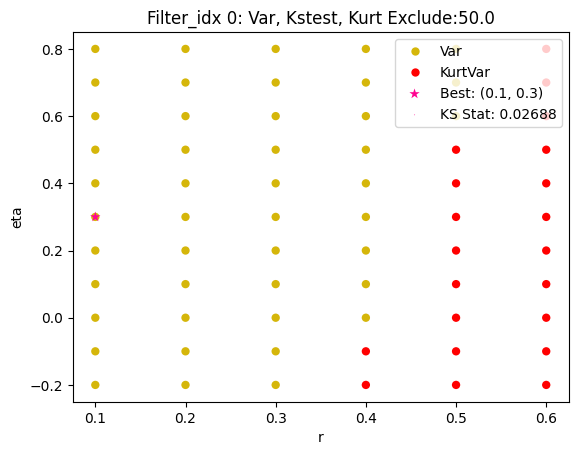

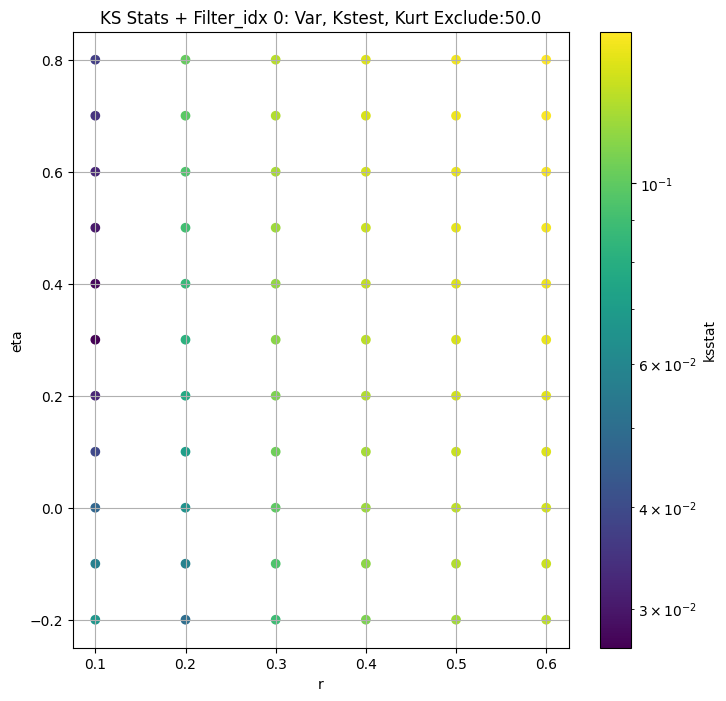

####
Filter_idx  2


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.011517185838413851 82.08465452392318


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.013593292689188297 72.3551732517906


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.014179214873450752 67.8281779722381


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.01515989884011193 61.49805419494295
Number of samples: 100000, Without approximation : 480000000.0


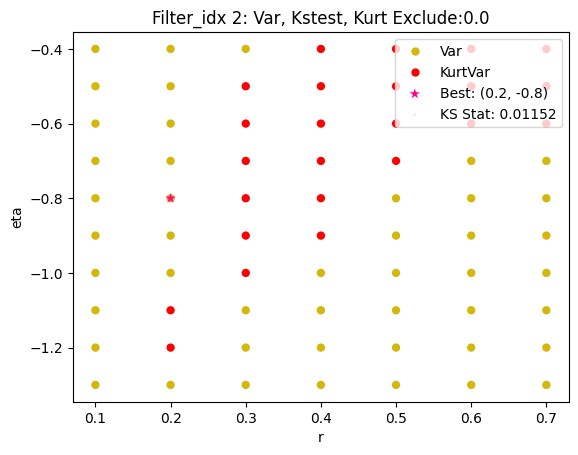

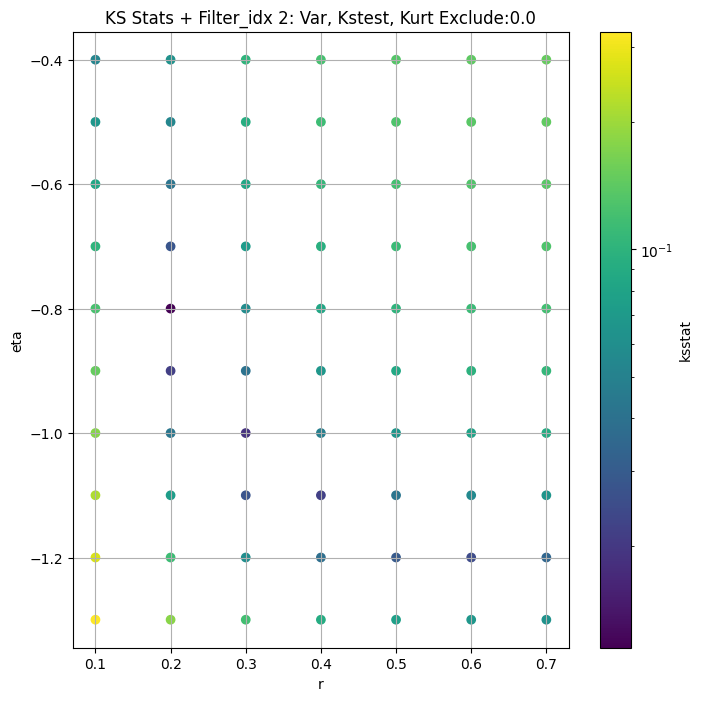

####
Filter_idx  3


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.00799023325023529 22.61132184256137


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.009228595321006283 19.57848558955904


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.010703946234074002 18.41174502169789


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.008886854099212527 16.8194670265946
Number of samples: 100000, Without approximation : 480000000.0


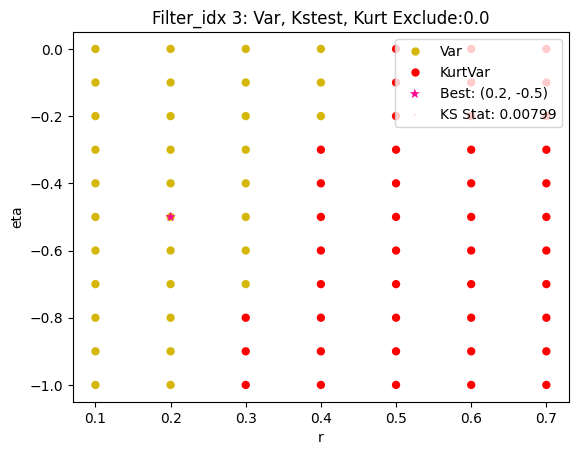

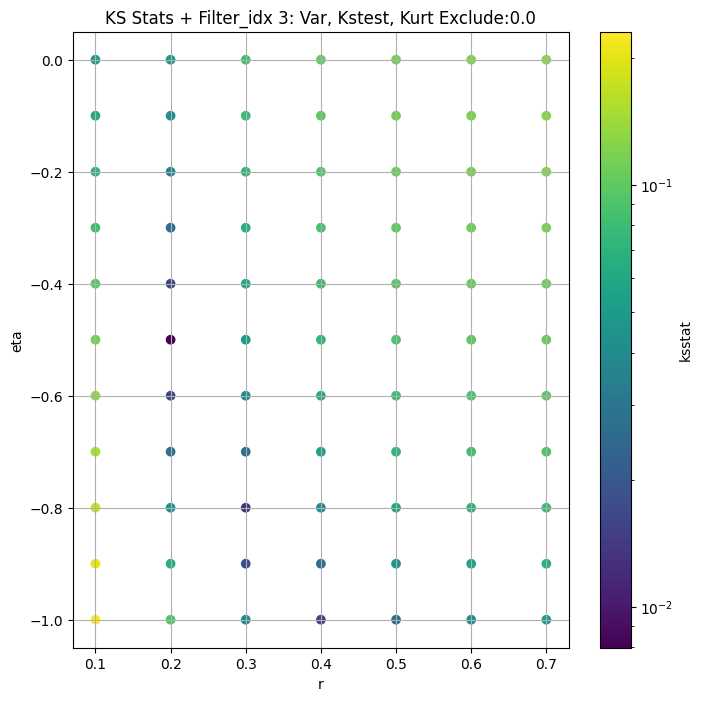

####
Filter_idx  4


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.018557120175638944 94.07708921865792


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.016102217329200308 85.68738289968486


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.014987236543378815 81.28769149552619


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.0176994100171608 74.85091958529381
Number of samples: 100000, Without approximation : 480000000.0


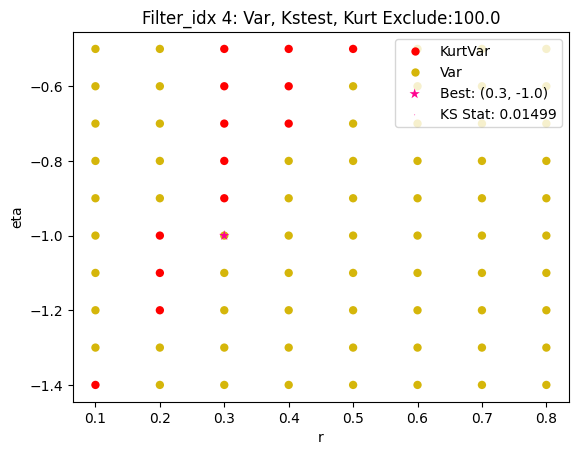

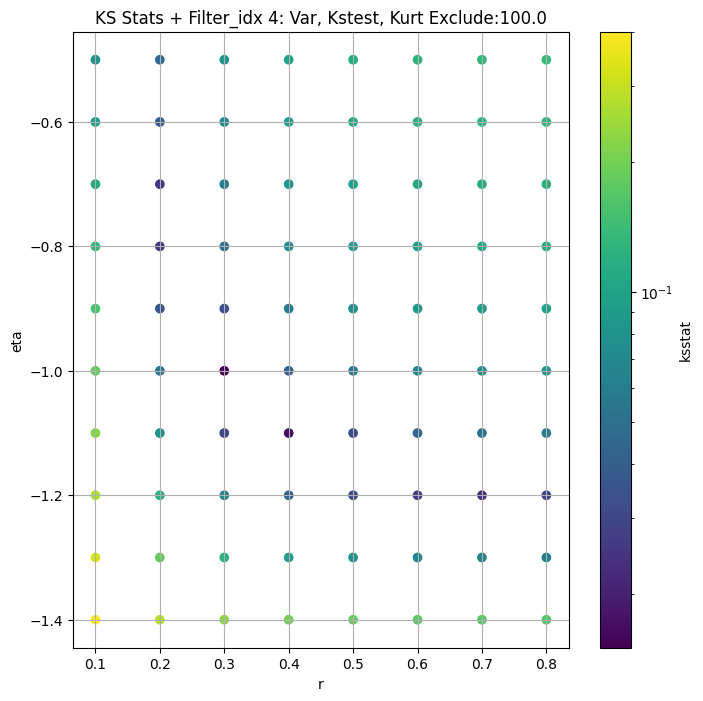

####
Filter_idx  5


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.02682777380019291 57.48323999942135


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.02612156786485126 53.189322625969


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.026245881394305726 50.966374475118855


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.02767137619928145 47.7062438952731
Number of samples: 100000, Without approximation : 480000000.0


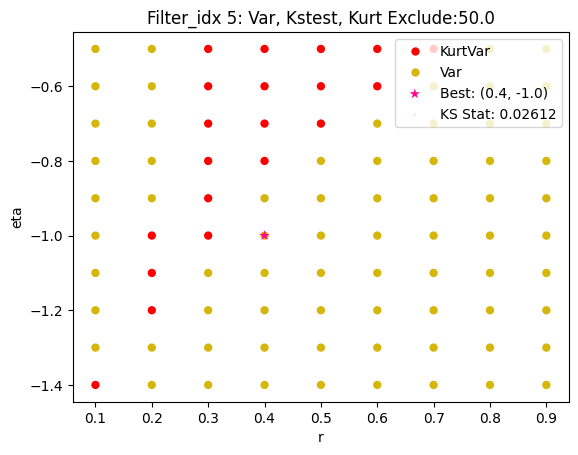

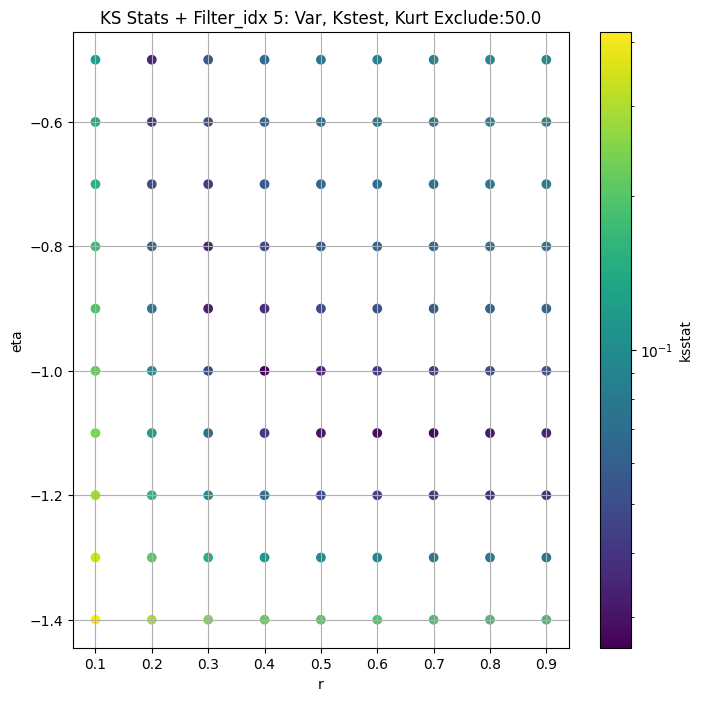

####
Filter_idx  6


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.01895935589905945 43.7282332401113


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.01783773614083284 38.4987279239758


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.018325008526207553 36.190036171595565


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.018242069545430062 33.02068773730918
Number of samples: 100000, Without approximation : 480000000.0


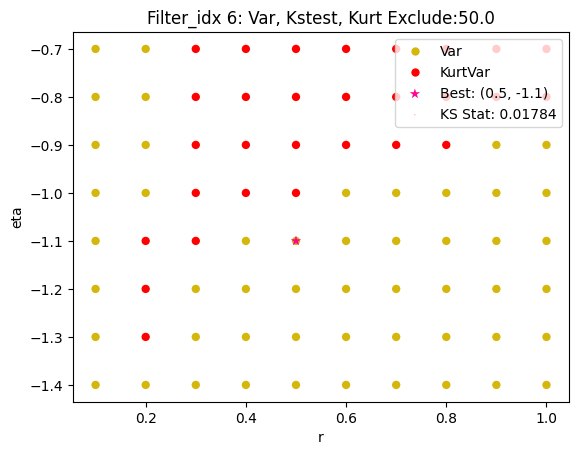

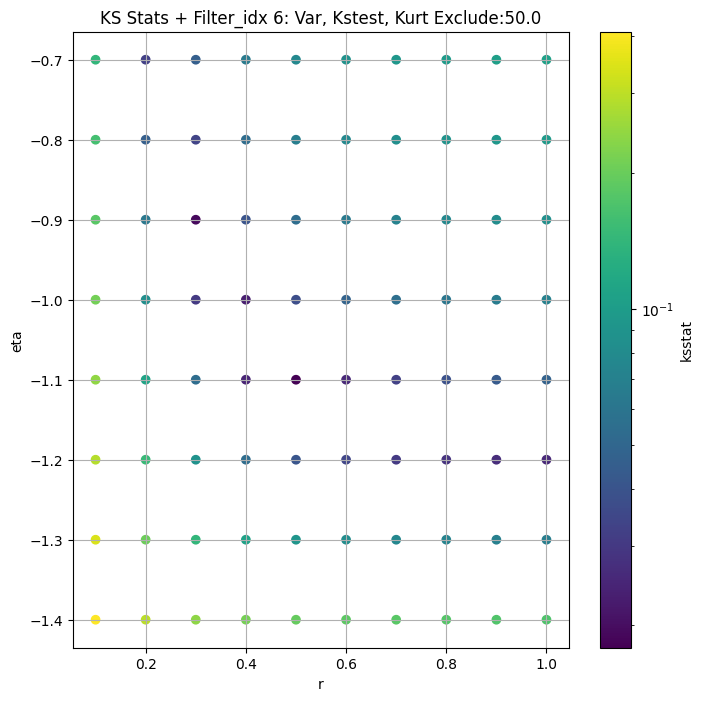

####
Filter_idx  7


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.042038779094559664 24.626245413153047


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.04213383496559142 22.788769183608455


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.04197350527443 21.916147153552544


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.041995348827781664 20.67557048411248
Number of samples: 100000, Without approximation : 480000000.0


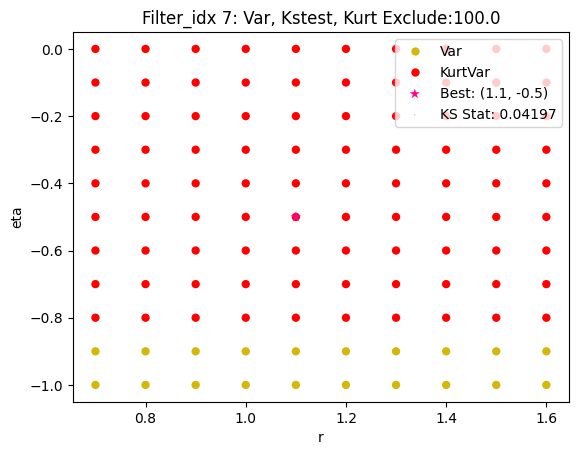

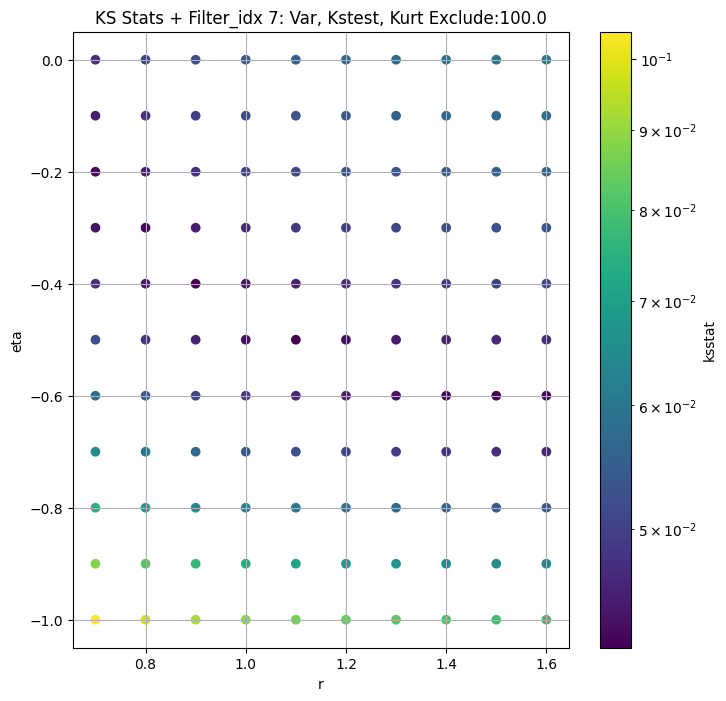

####
Filter_idx  8


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.018556564250043817 1.9246735623647266


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.018555584216111143 1.6801180148886026


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.01855715643664152 1.605893818522322


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.018559620772273855 1.5041617439794275
Number of samples: 100000, Without approximation : 480000000.0


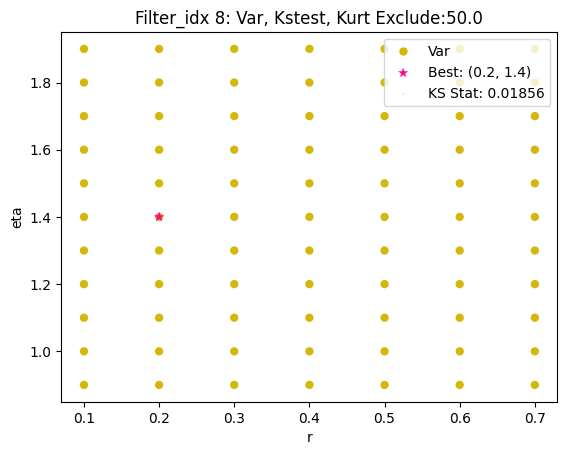

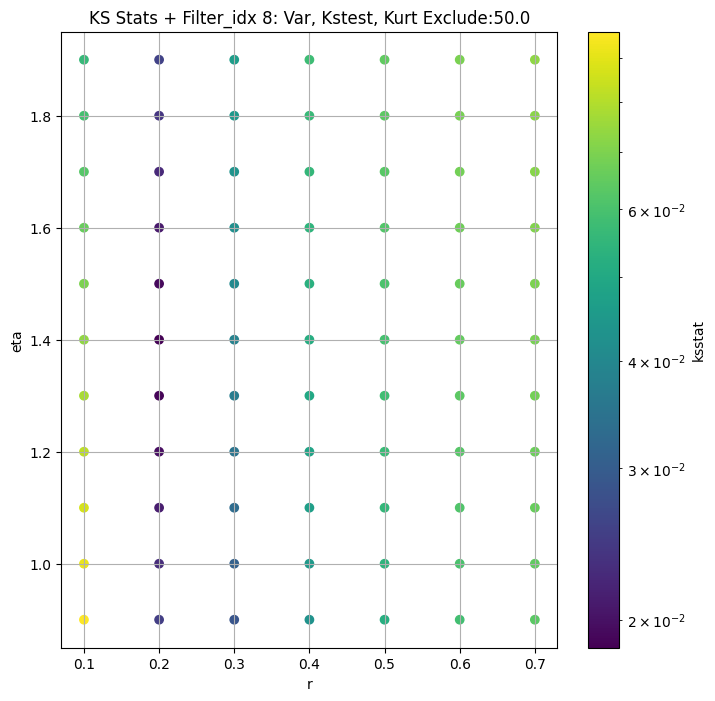

####
Filter_idx  9


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.0053154989358712434 9.369960484917575


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.0035583116989656993 7.065595153195351


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.005045533271062608 6.61807403858368


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.005136801012910468 6.036023280111542
Number of samples: 100000, Without approximation : 480000000.0


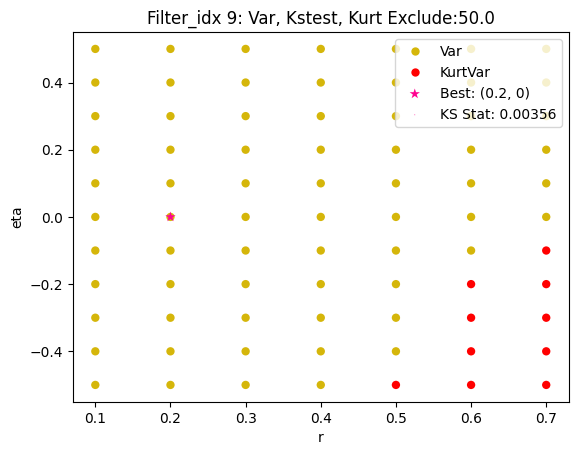

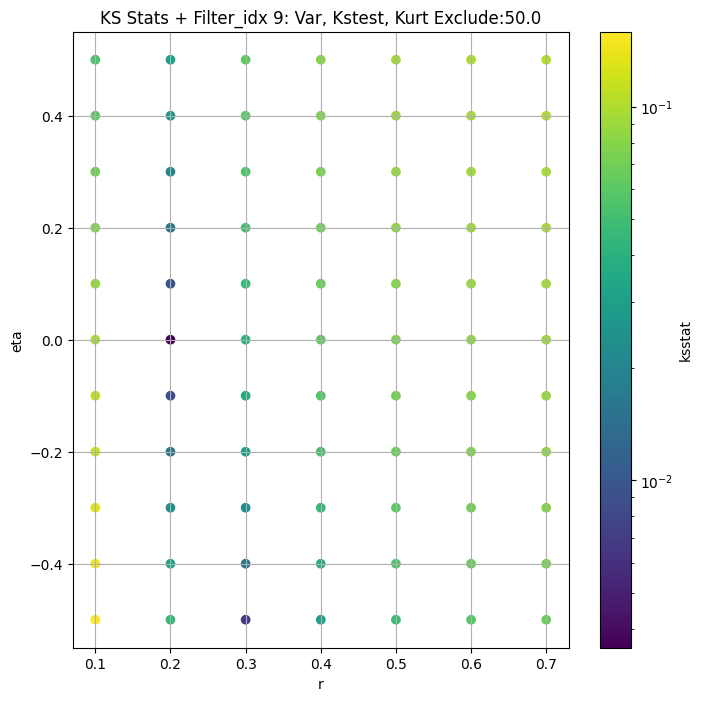

####
Filter_idx  10


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.013572380844802778 35.86590116801386


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.014666331170957614 31.712401866716583


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.013523854596625307 29.932773568730685


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.017076908295830306 27.482504929664756
Number of samples: 100000, Without approximation : 480000000.0


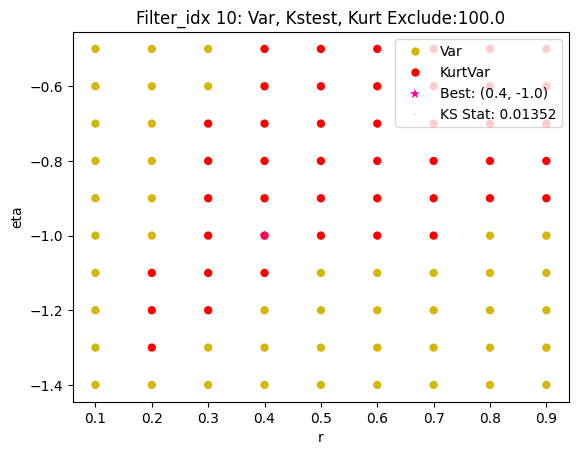

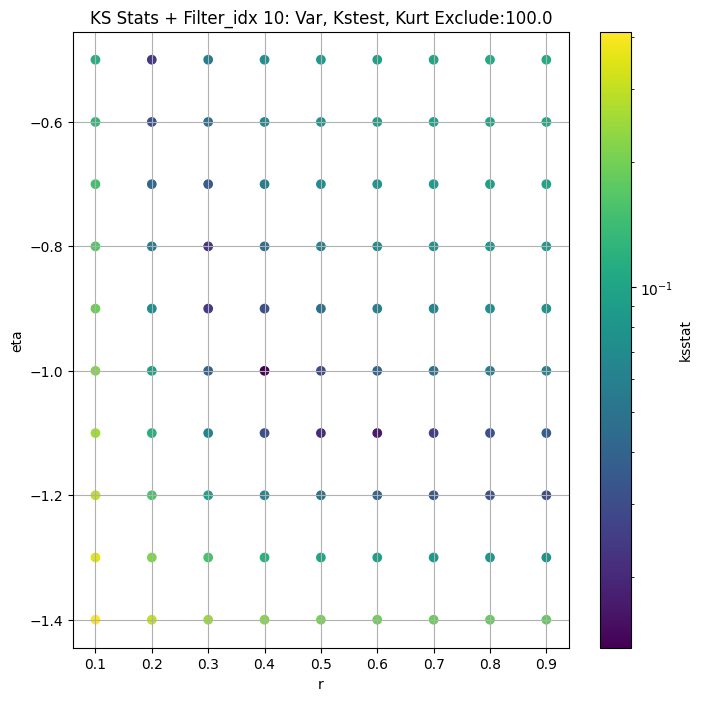

####
Filter_idx  11


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.016647856429231583 39.66937730091172


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.014268012808258373 34.14246844691742


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.018102137855653025 31.7734053744688


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.01619343969515763 28.586005984677524
Number of samples: 100000, Without approximation : 480000000.0


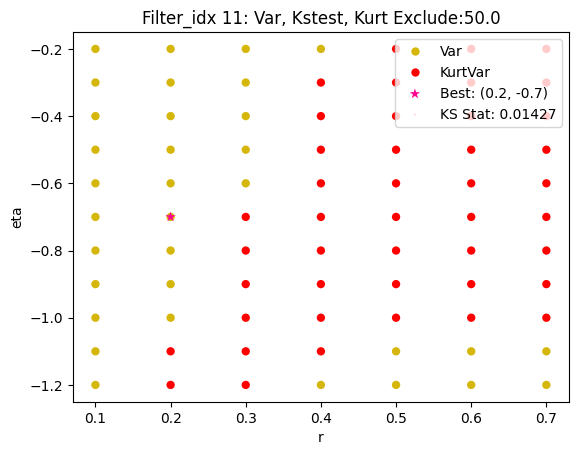

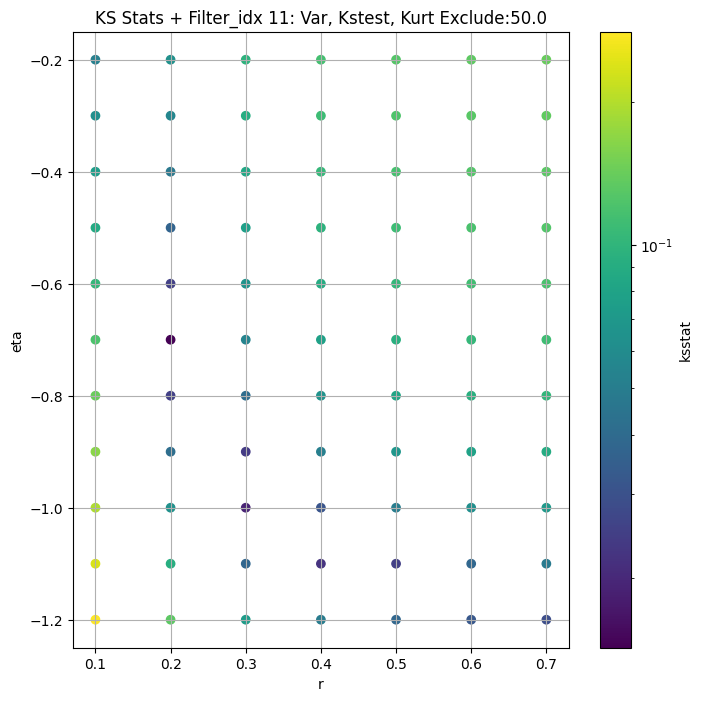

####
Filter_idx  12


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.00865905030734182 48.07721821441986


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.010642973076729123 40.90306290185188


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.011732368837158336 38.261213603058636


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.01292843095616679 34.74462730505629
Number of samples: 100000, Without approximation : 480000000.0


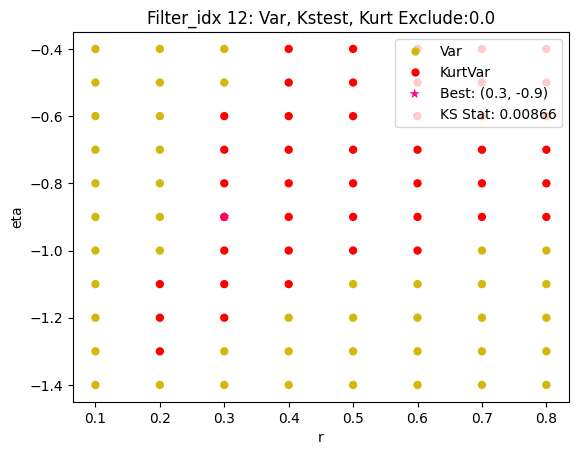

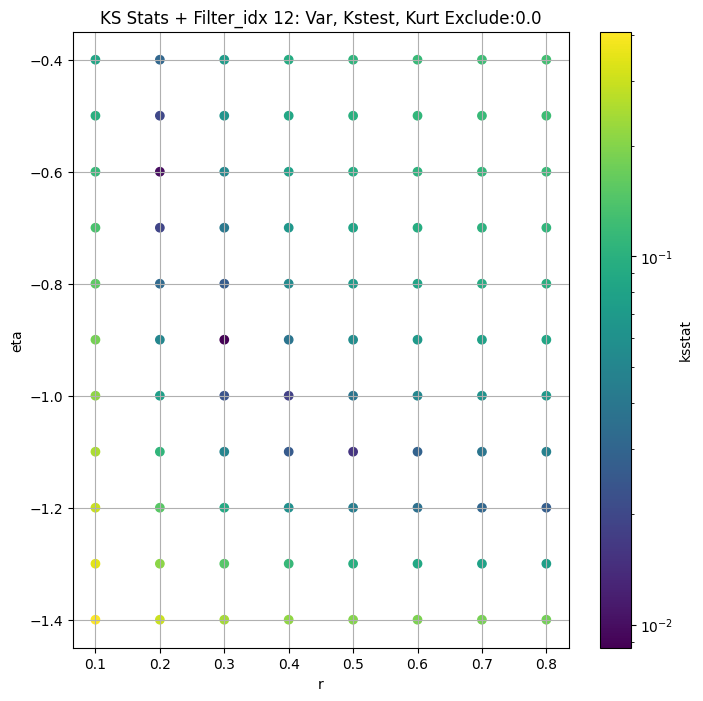

####
Filter_idx  13


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.010764410519316536 29.448136531036162


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.012540724535958114 25.307361531485864


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.011149531342519725 23.689188293672366


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.0140139829371774 21.53558884098918
Number of samples: 100000, Without approximation : 480000000.0


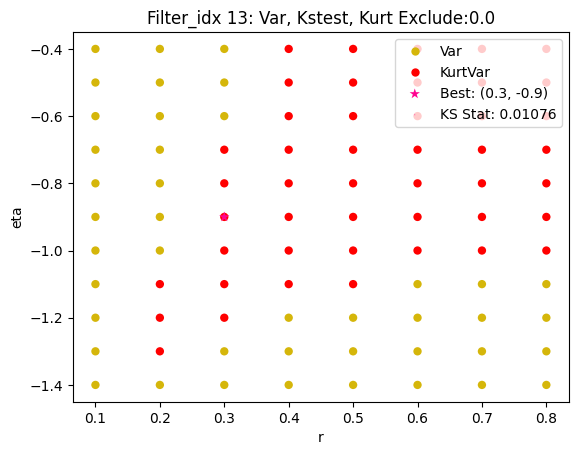

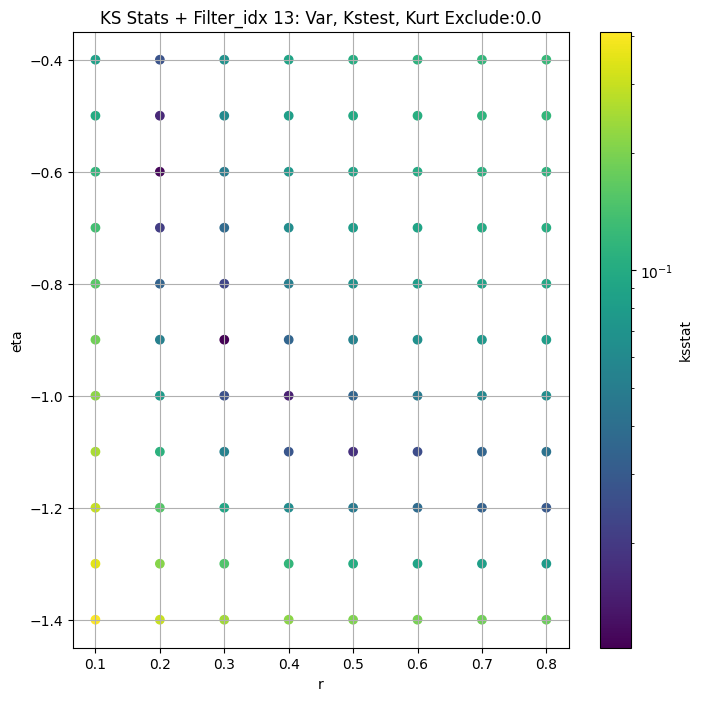

####
Filter_idx  14


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.019933594679899524 38.76253774457407


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.020249321320775837 33.97698887388504


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.019314599879155958 31.915292414415465


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.02022544390904546 29.11581156381431
Number of samples: 100000, Without approximation : 480000000.0


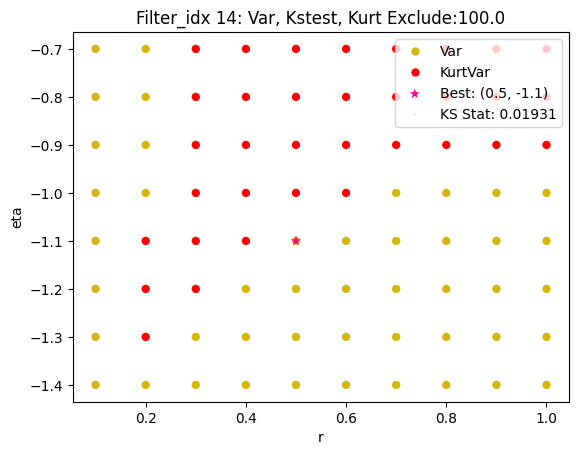

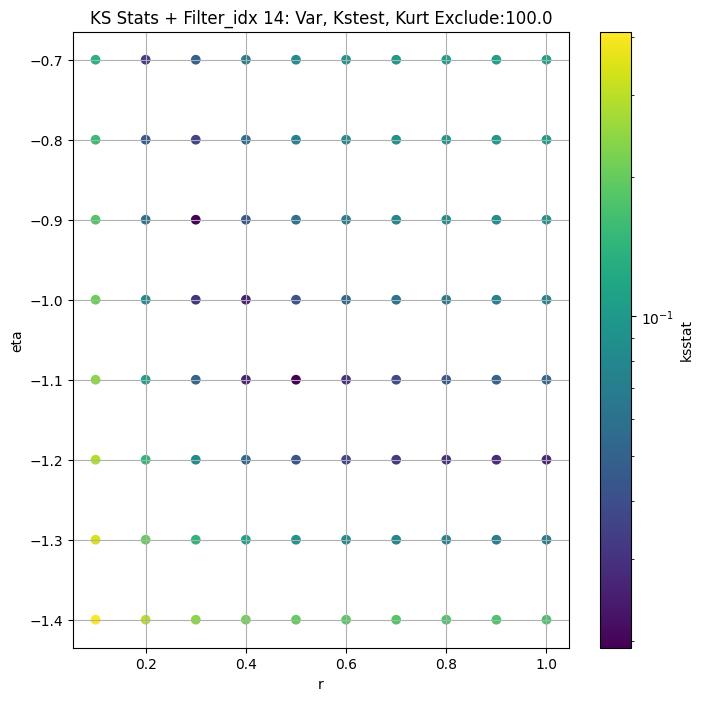

####
Filter_idx  15


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.028406002466494107 42.579443702992165


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.028404824625497815 39.866976839076806


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.028404662723780894 38.492437453746305


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.028404627232743562 36.54929624462547
Number of samples: 100000, Without approximation : 480000000.0


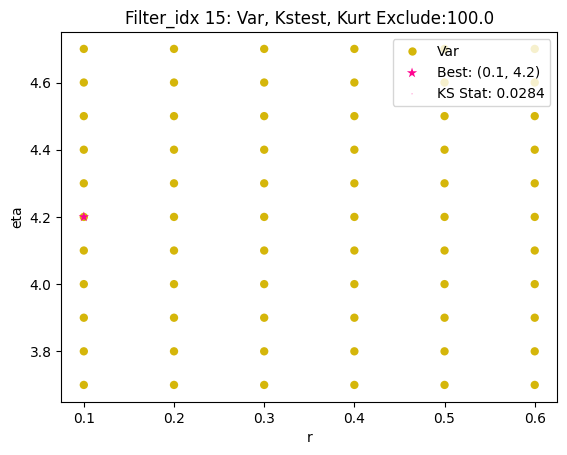

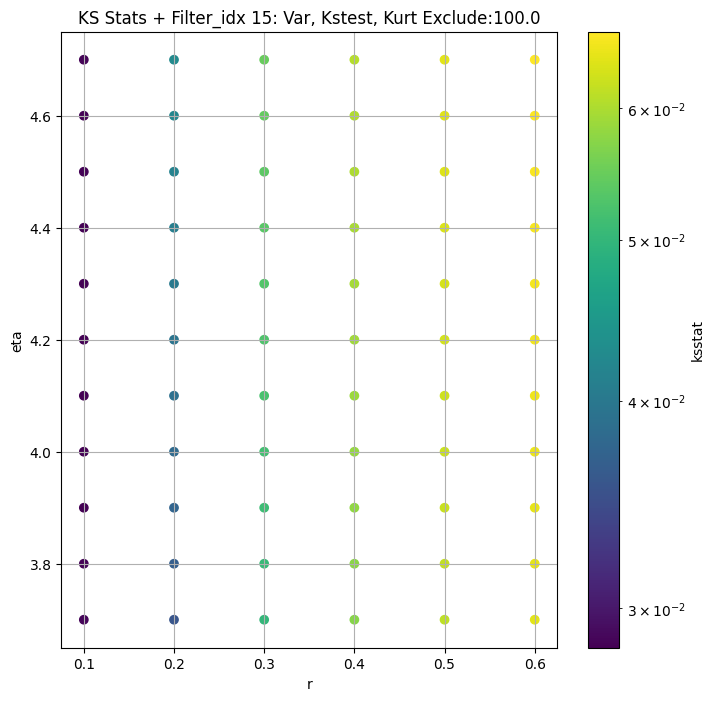

####
Filter_idx  16


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.005778458640254391 61.30564812928164


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.0058065744990709045 52.335528448099744


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.008183153233785045 48.94177295612733


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.009779668537909014 44.47710094833785
Number of samples: 100000, Without approximation : 480000000.0


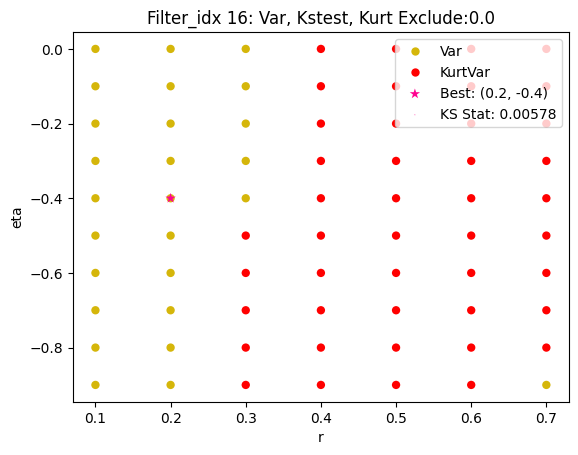

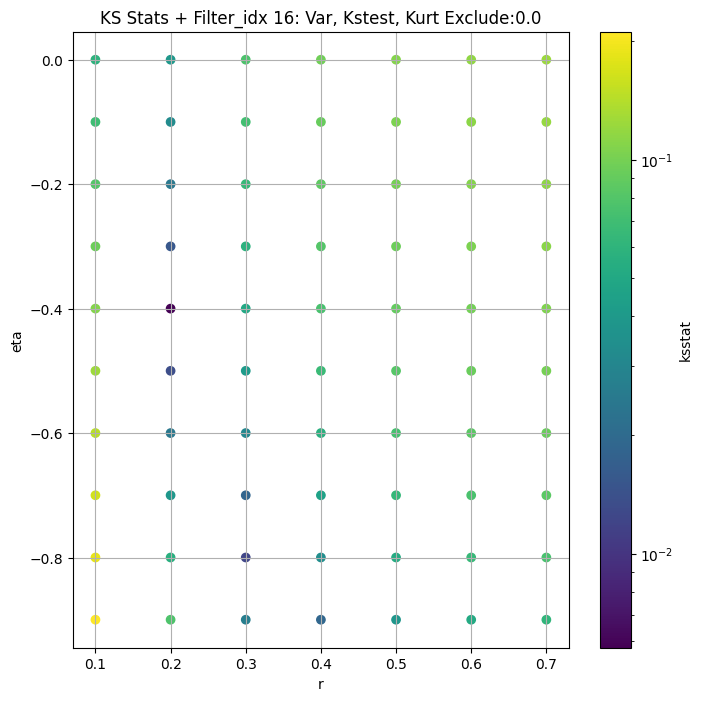

####
Filter_idx  17


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.02318858960444503 57.50033373791151


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.024957163564187312 52.113096673887995


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.02545261205313687 49.43280728626987


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.025392732415725705 45.62001103906395
Number of samples: 100000, Without approximation : 480000000.0


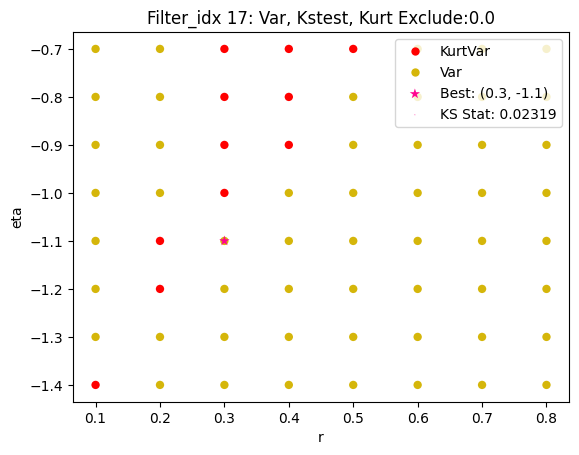

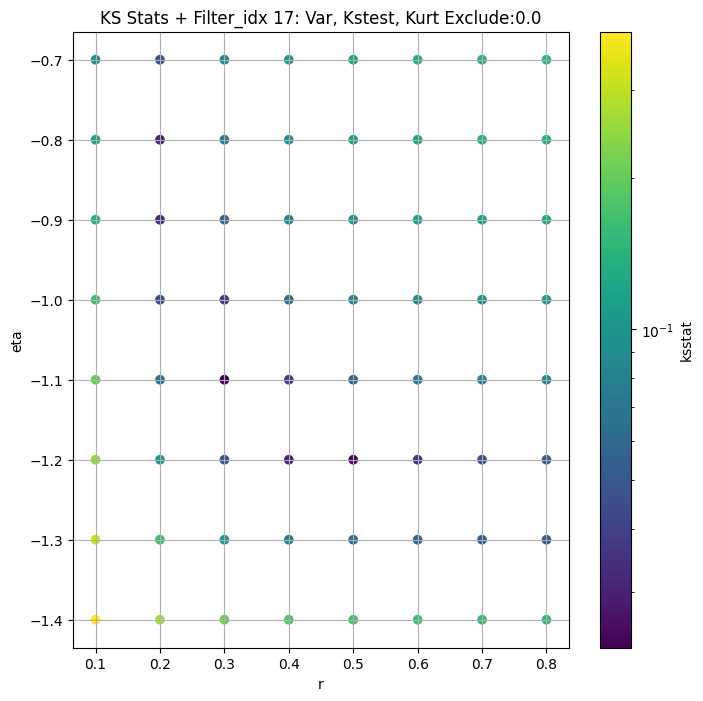

####
Filter_idx  18


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.008282691108303597 48.14403630452585


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.007915762818452188 40.10951632306938


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.009526565646690799 37.28630965226747


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.009207657021584603 33.642596241647574
Number of samples: 100000, Without approximation : 480000000.0


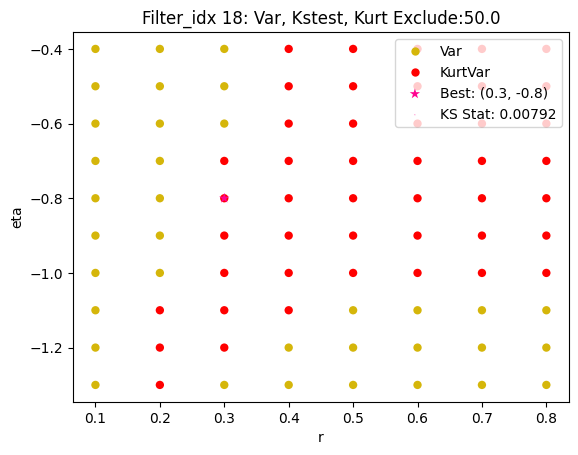

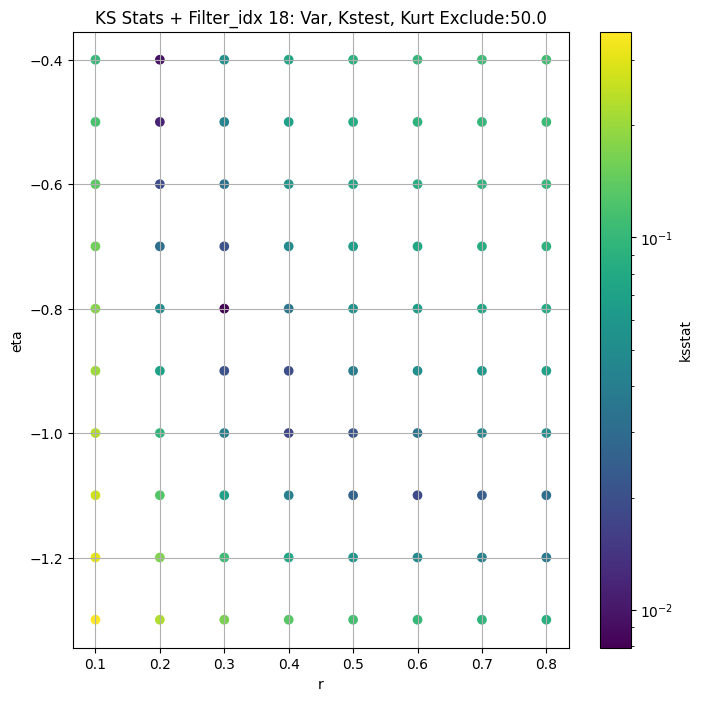

####
Filter_idx  20


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.009432783584246818 37.67740202972317


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.012703880686694924 32.84474319152455


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.012680308306872112 30.737480409155108


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.011846985377496067 27.881235303373963
Number of samples: 100000, Without approximation : 480000000.0


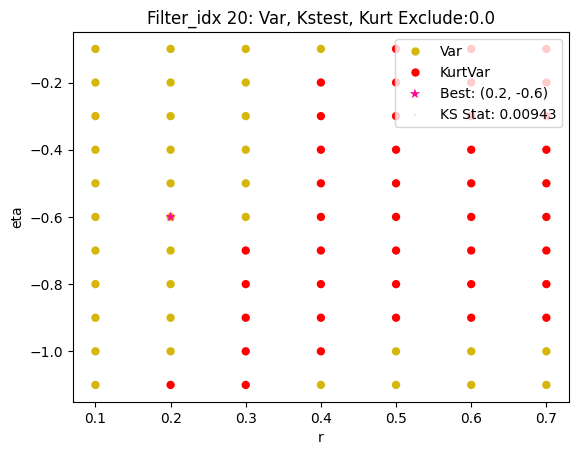

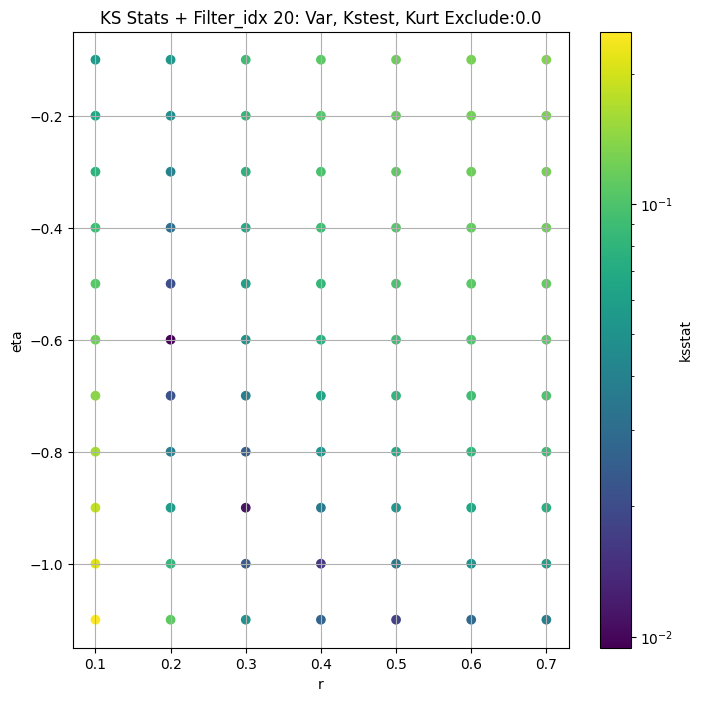

####
Filter_idx  22


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.01031268601313129 18.166951988151826


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.012117631636162252 15.90949039116975


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.01161805043642683 15.01642901858553


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.010629570922608092 13.799132321850166
Number of samples: 100000, Without approximation : 480000000.0


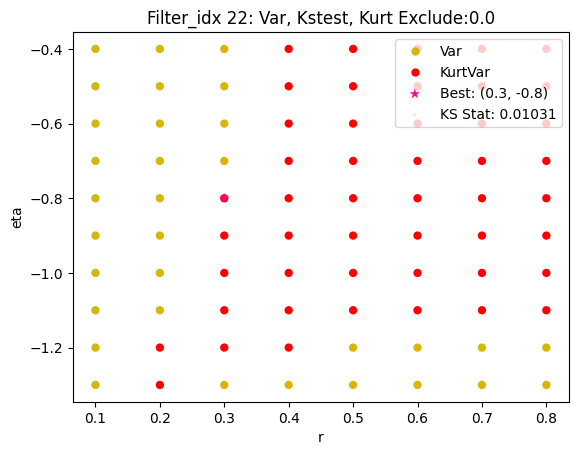

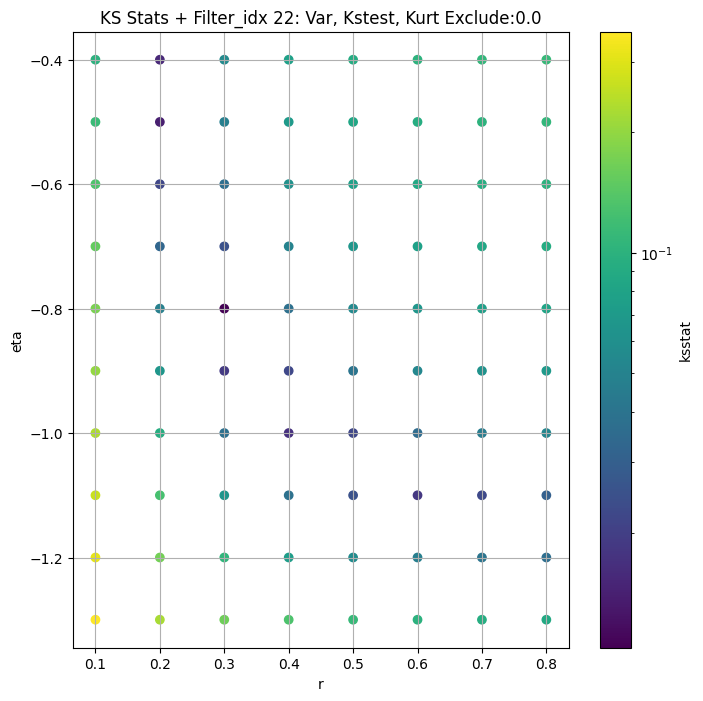

####
Filter_idx  23


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.01510218881045744 31.440153510876385


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.011157272841070043 28.179399146823975


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.013330381478274561 26.707079172249603


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.01677633102719317 24.64791512716881
Number of samples: 100000, Without approximation : 480000000.0


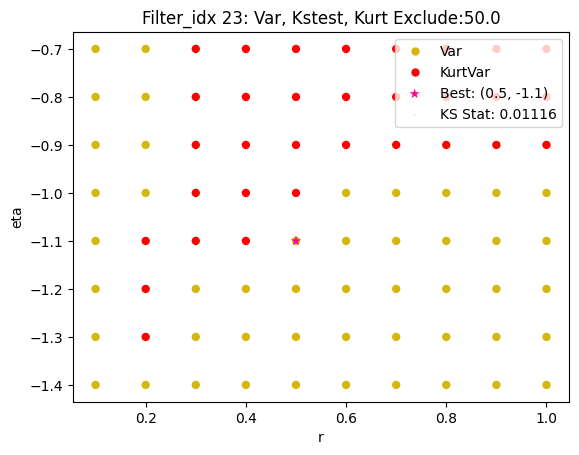

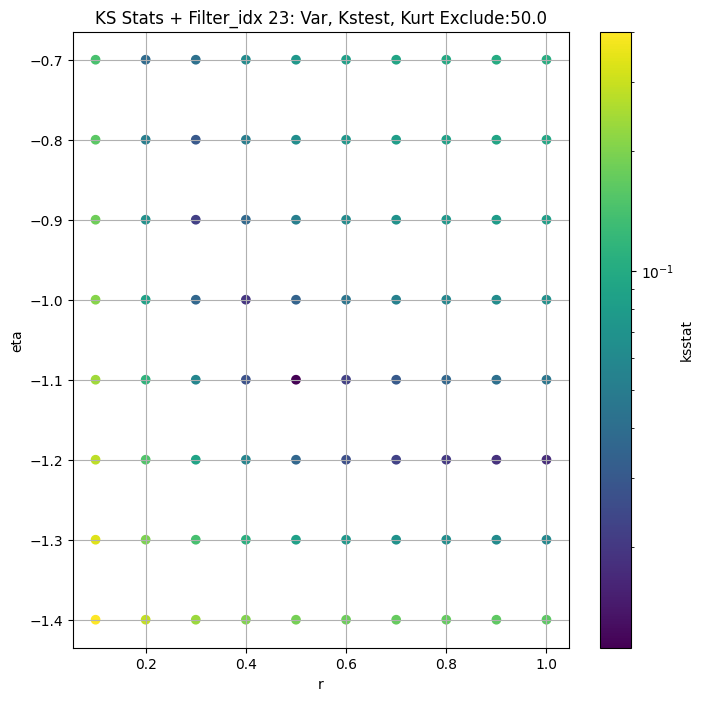

####
Filter_idx  24


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.0083461265591529 21.173402754686595


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.009605471845545721 17.539528359916847


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.010413867352336292 16.399008747861757


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.010797976075651194 14.8684898126006
Number of samples: 100000, Without approximation : 480000000.0


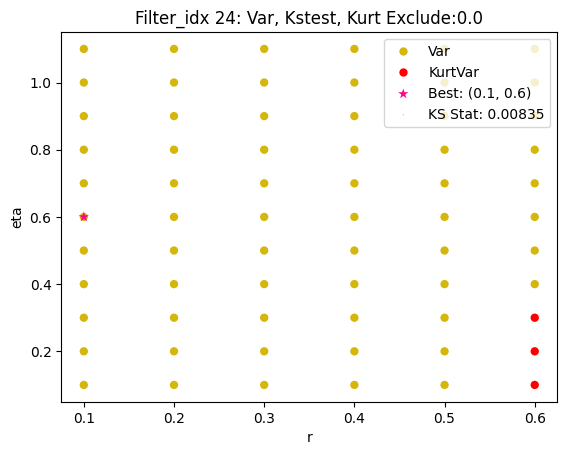

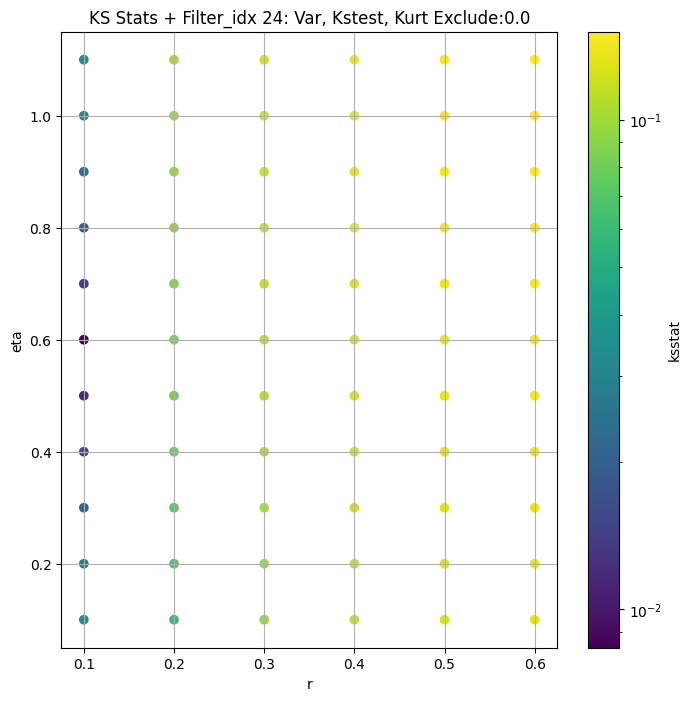

####
Filter_idx  25


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.0038826128974168705 9.03464644015979


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.0038496136515406287 7.557163681470767


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.0051487381909569585 7.118591665106626


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.006301126350181319 6.5337333796192185
Number of samples: 100000, Without approximation : 480000000.0


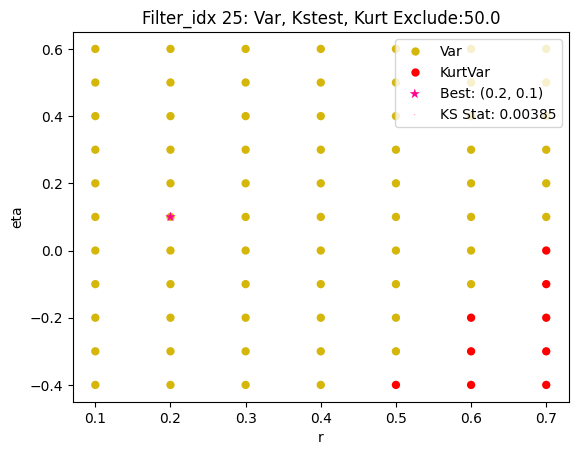

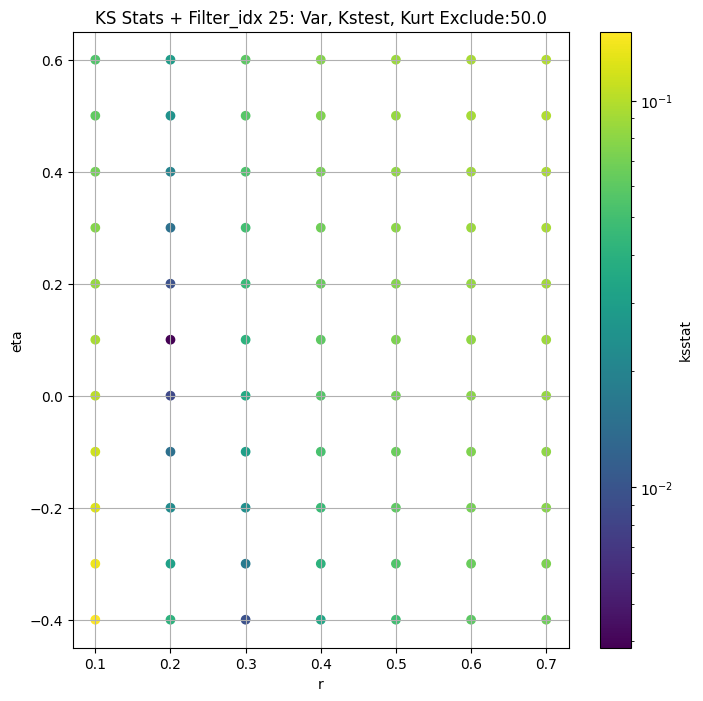

####
Filter_idx  26


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.024483819302462073 43.14164174756185


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.023796735153089665 38.67531002999891


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.024228662013535684 36.63374236191197


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.023647562452535853 33.799637316055396
Number of samples: 100000, Without approximation : 480000000.0


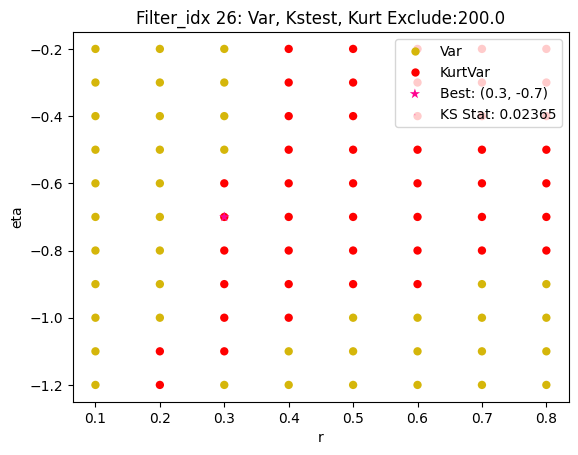

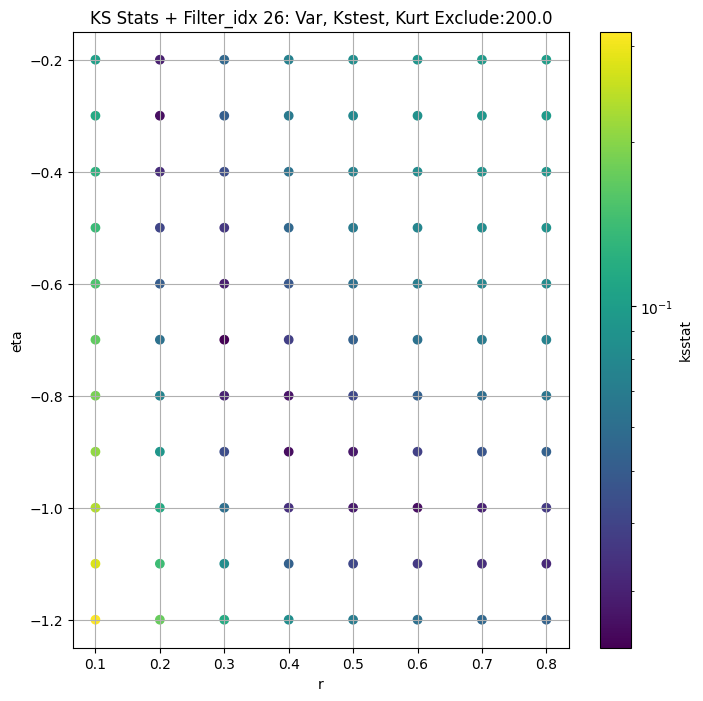

####
Filter_idx  27


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.005154200663948727 10.058828841830875


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.004846000283891372 7.3001651291630845


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.0038681140952685836 6.82486008027471


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.006915756780110943 6.203818190126612
Number of samples: 100000, Without approximation : 480000000.0


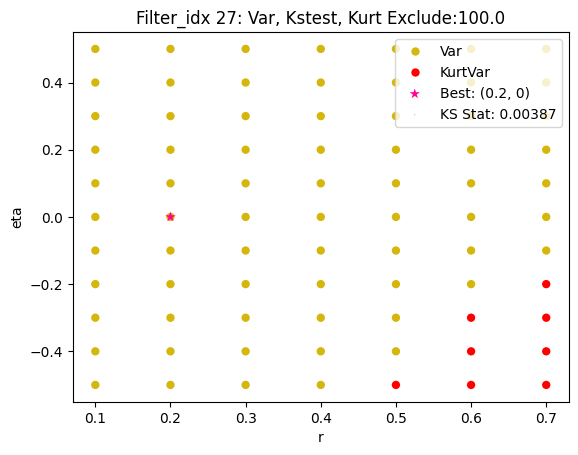

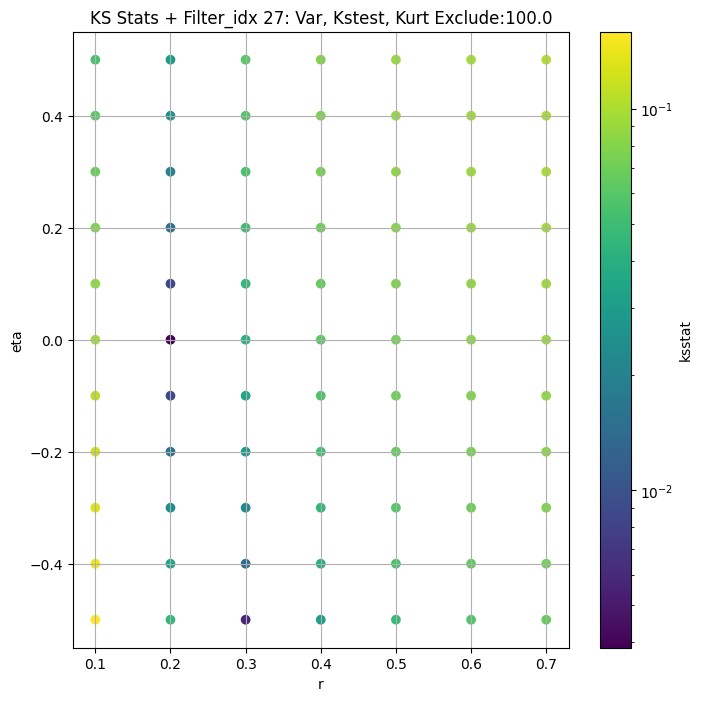

####
Filter_idx  28


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.011684327735103306 29.010986266093816


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.012433921612619248 24.750712732720004


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.009381555167221833 23.267721173334316


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.013924438056045152 21.255674182735305
Number of samples: 100000, Without approximation : 480000000.0


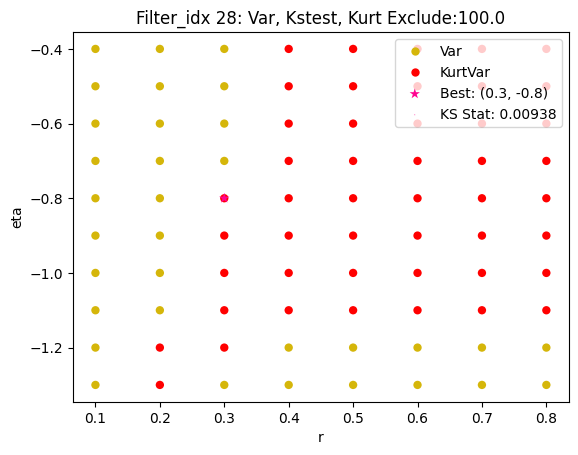

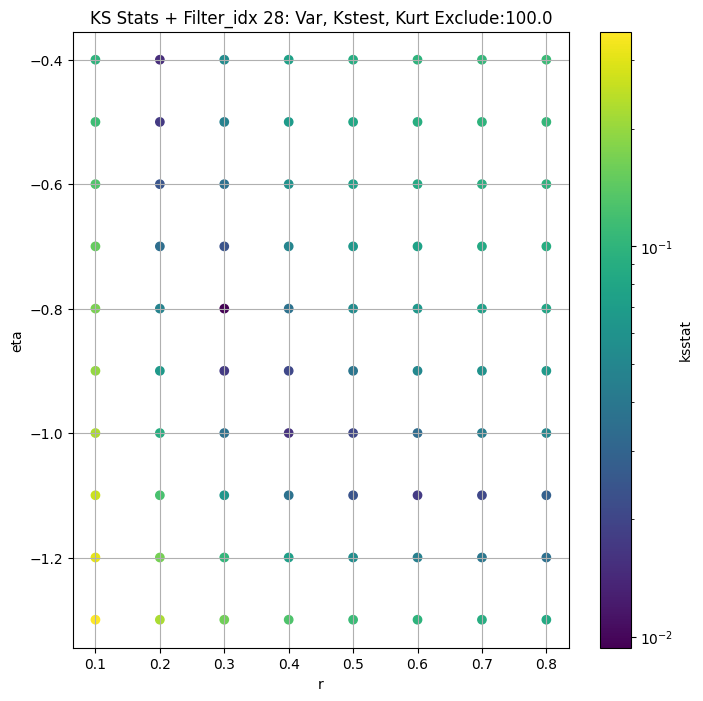

####
Filter_idx  29


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.038889382746807144 20.822995669521006


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.038880638579470383 18.31049560637869


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.03897604769828372 17.20045567790839


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.038880532975393456 15.662892572161223
Number of samples: 100000, Without approximation : 480000000.0


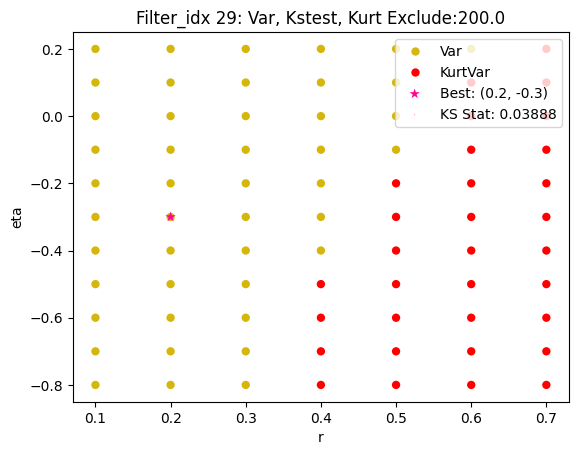

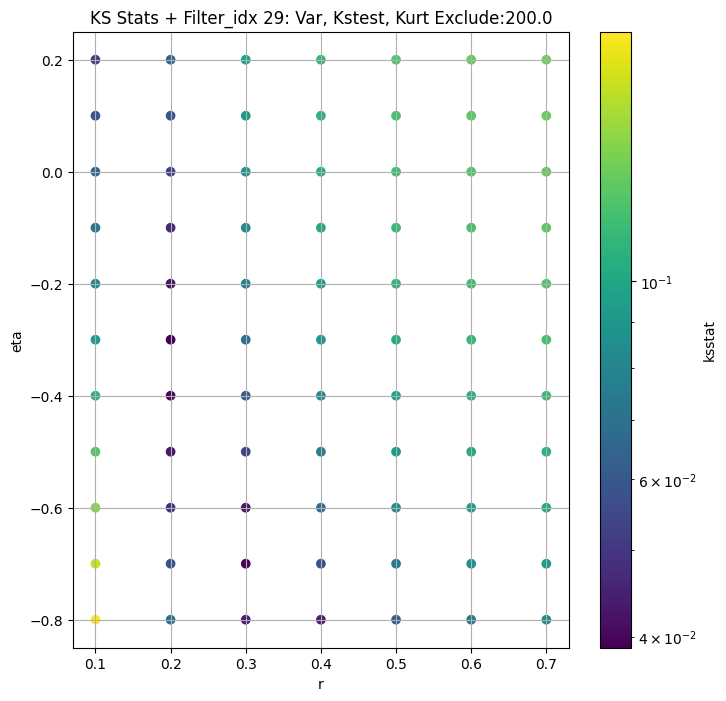

####
Filter_idx  30


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.00921299488021643 19.45063610611612


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.007095288006096212 16.19721540175718


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.009116683062159292 15.082302174213018


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.010779506793144267 13.59497659872708
Number of samples: 100000, Without approximation : 480000000.0


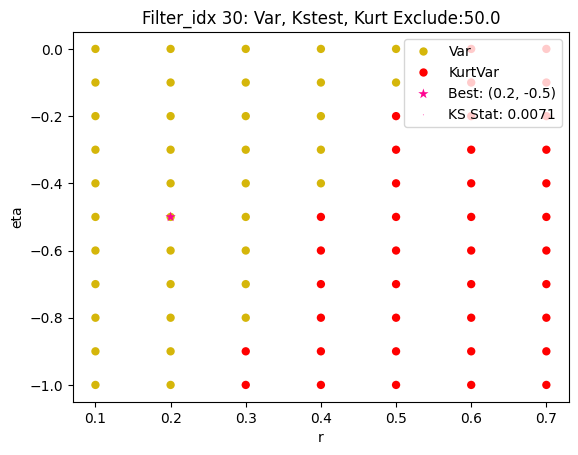

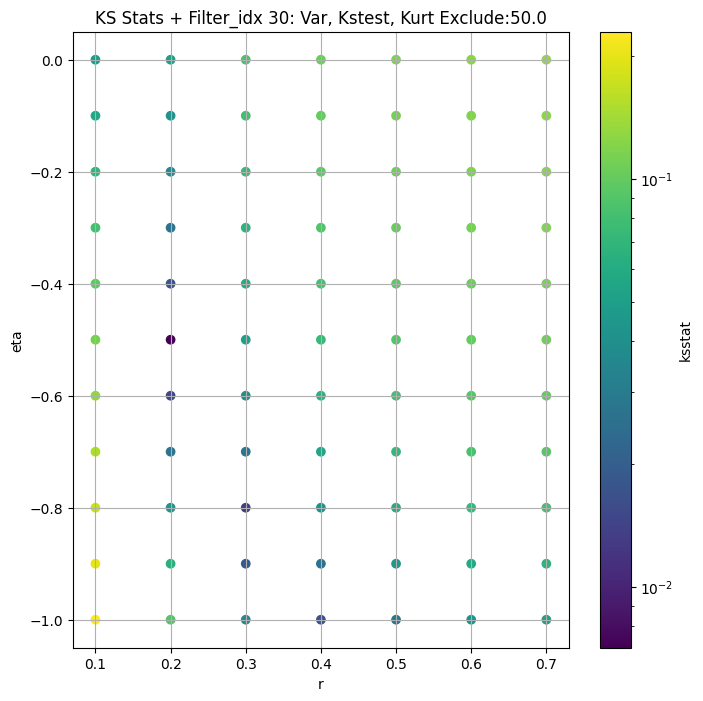

####
Filter_idx  31


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.0622713796275024 45.65640394191919


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.062265697932857744 41.38213621796571


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.0622708639269845 39.31494907157802


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.06226861191169375 36.431631032695094
Number of samples: 100000, Without approximation : 480000000.0


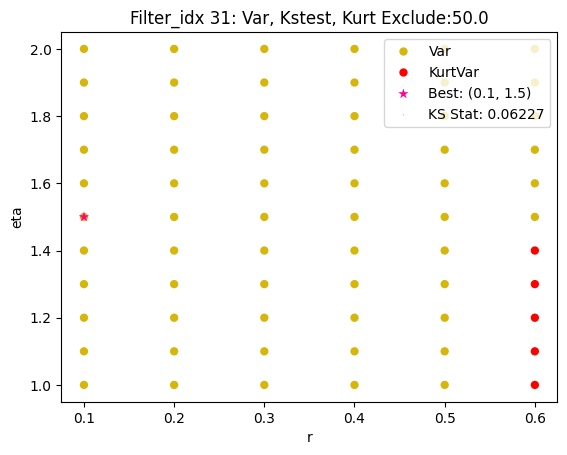

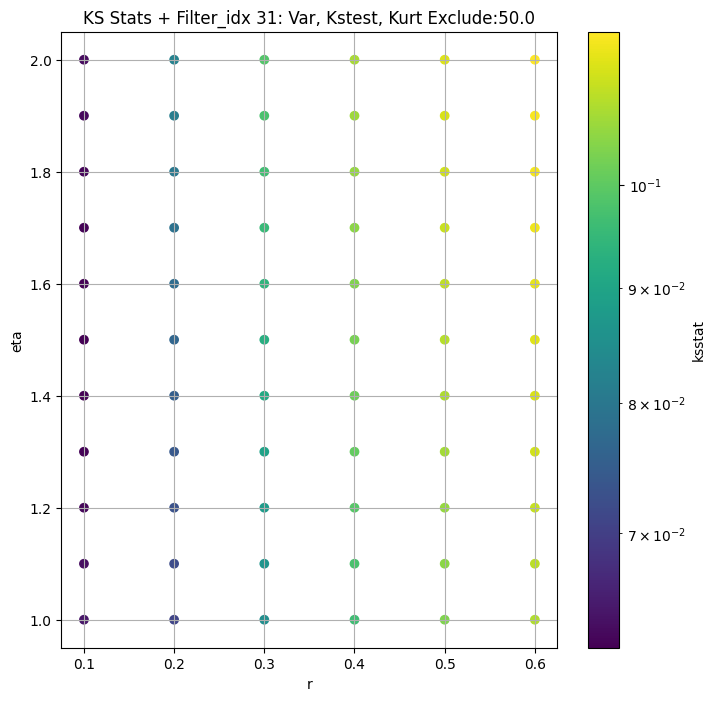

####
Filter_idx  32


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.018795592181452714 29.968693691351454


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.017902216583852826 26.42204879739781


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.01887444364394153 24.895474357426313


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.016907679289835886 22.790395266332215
Number of samples: 100000, Without approximation : 480000000.0


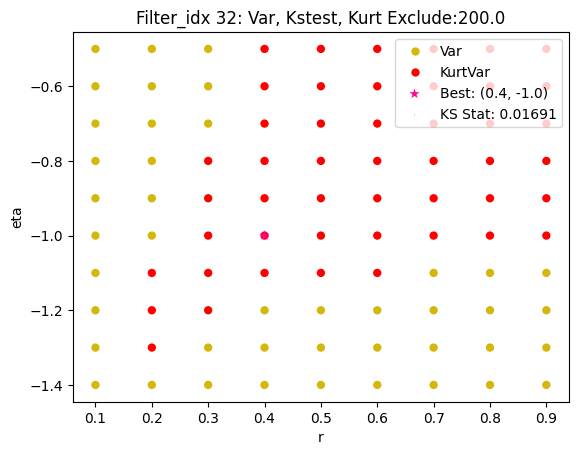

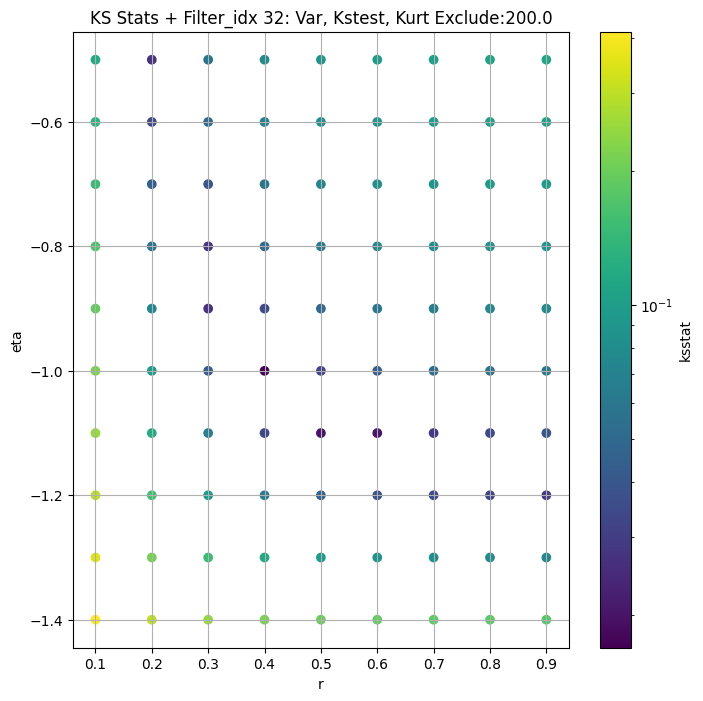

####
Filter_idx  33


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.005166899698168526 16.6375472743384


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.0039032108091167084 13.764925895491668


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.0059944042290432376 12.82355068590075


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.005888921094979072 11.588615256196125
Number of samples: 100000, Without approximation : 480000000.0


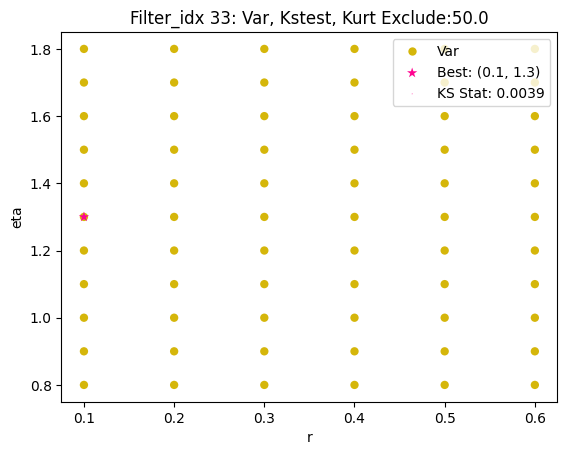

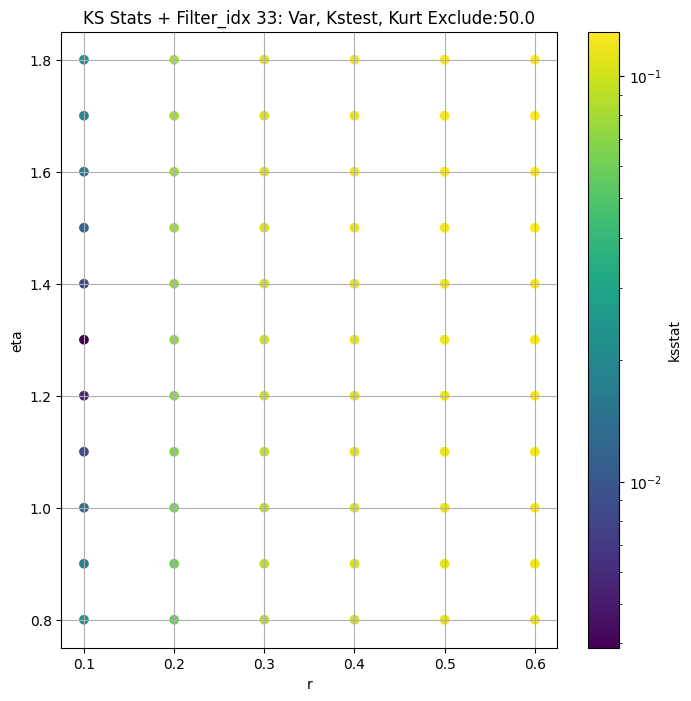

####
Filter_idx  34


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.00930736784131836 25.921622107634946


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.012125593065389295 22.064097360577453


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.010148176102953932 20.706006638083515


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.01245744705980567 18.86808102917036
Number of samples: 100000, Without approximation : 480000000.0


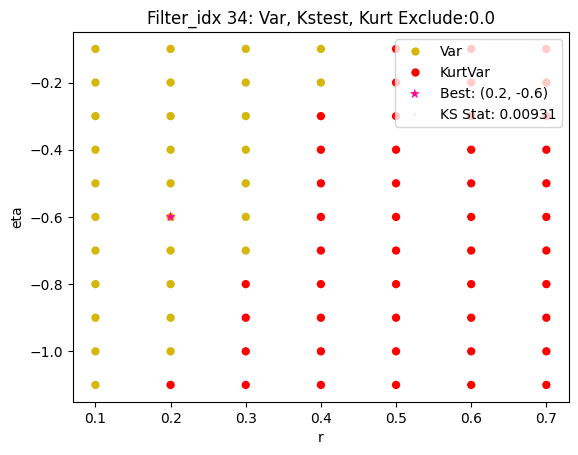

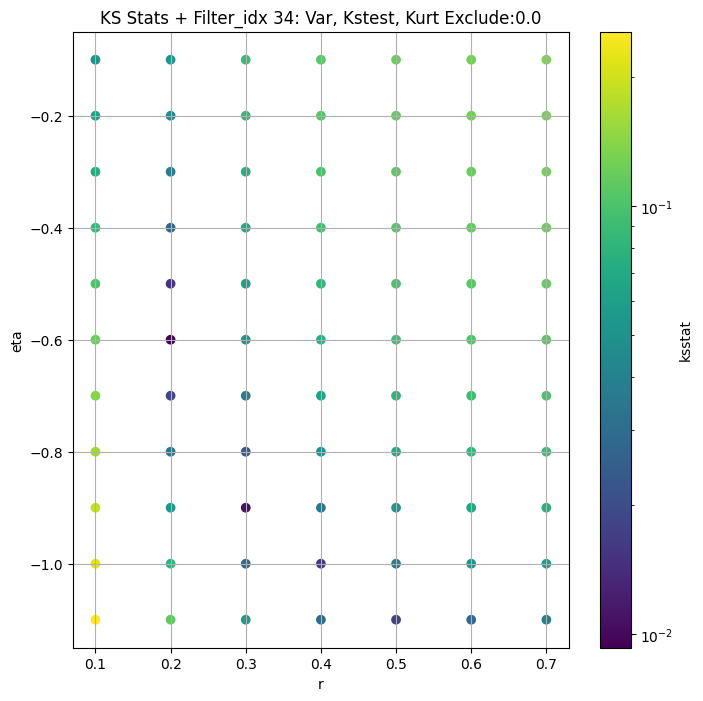

####
Filter_idx  38


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.024382420115292958 71.52992193914459


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.02178003346890406 63.38143211732465


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.021185982509328516 59.59207441516093


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.022188315250816493 54.37224376095436
Number of samples: 100000, Without approximation : 480000000.0


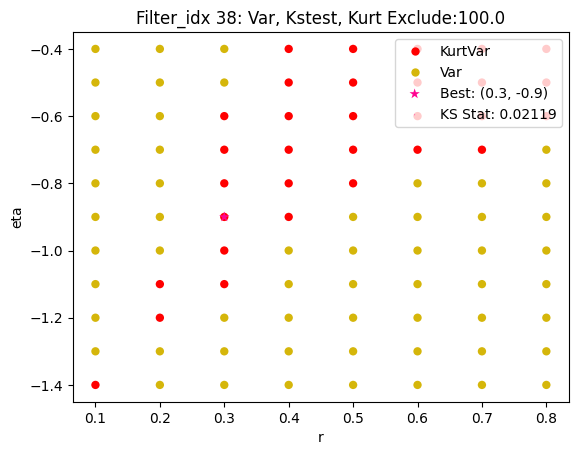

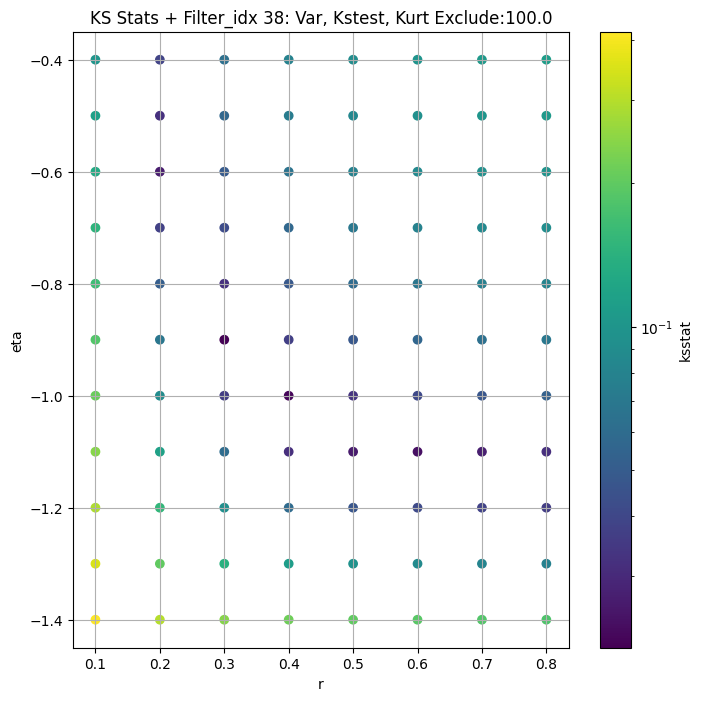

####
Filter_idx  39


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.06648420089176221 52.075115655613104


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.06648443275647842 46.968654285795644


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.06648374958929809 44.55758957698359


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.06648376947310586 41.20455034452599
Number of samples: 100000, Without approximation : 480000000.0


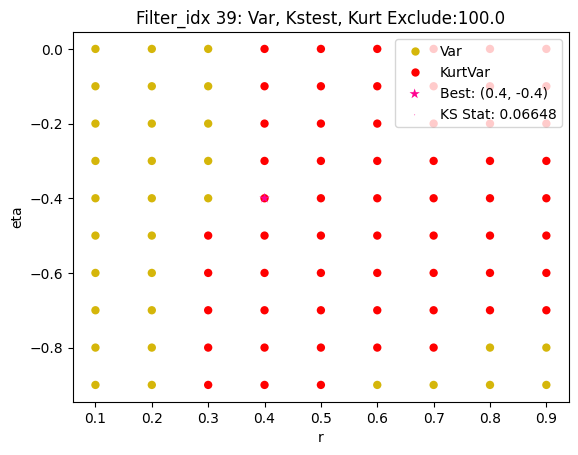

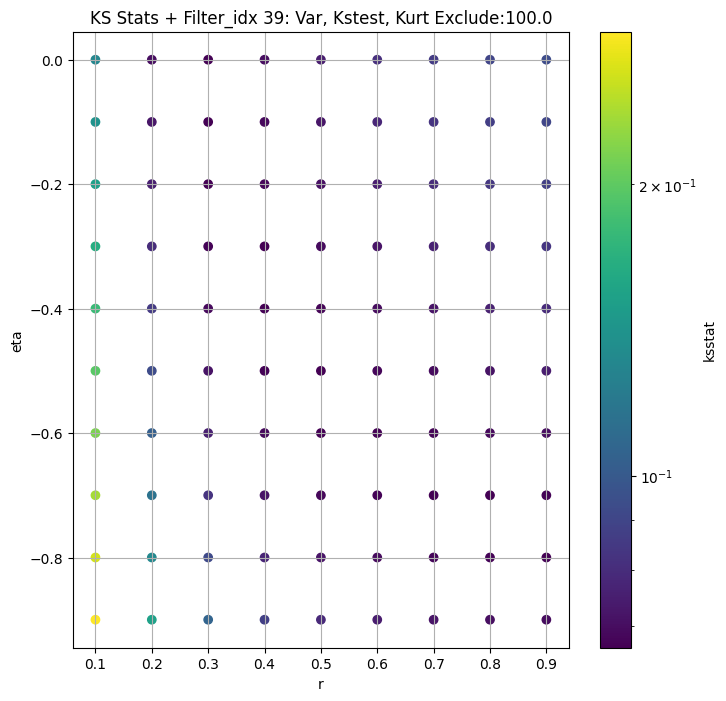

####
Filter_idx  40


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.015319950216676315 42.19076863086766


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.015238383592926563 39.49410770061015


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.015228628722577686 38.17380375148875


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.015134287664307355 36.31031033953092
Number of samples: 100000, Without approximation : 480000000.0


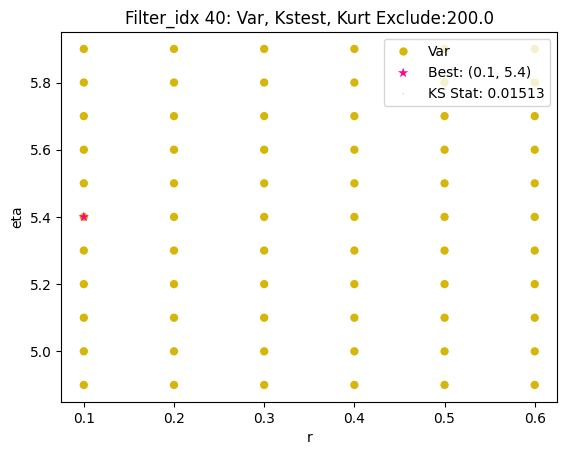

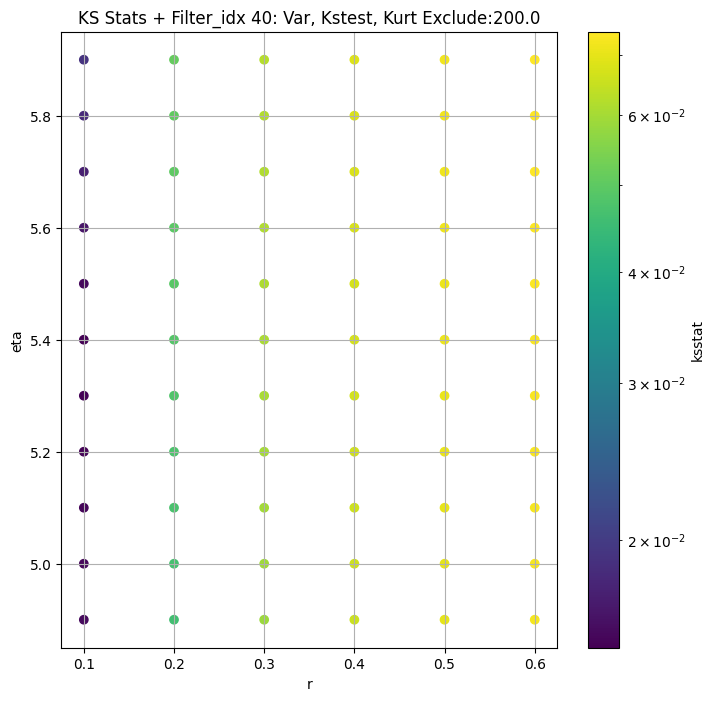

####
Filter_idx  41


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.005221237218037356 29.529004168366832


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.006303259882714074 24.3919568524644


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.00823759349371822 22.53006437544688


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.007493321972482536 20.133242824619277
Number of samples: 100000, Without approximation : 480000000.0


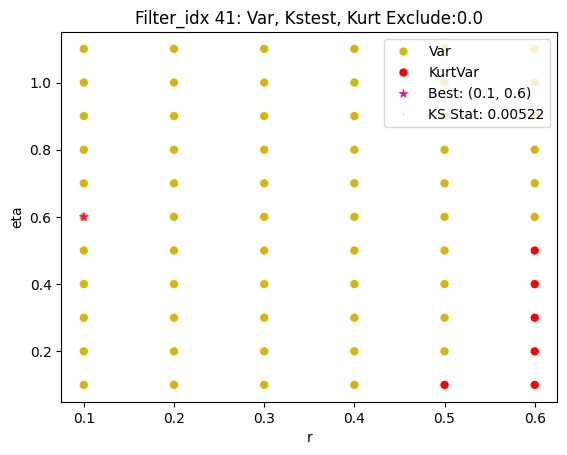

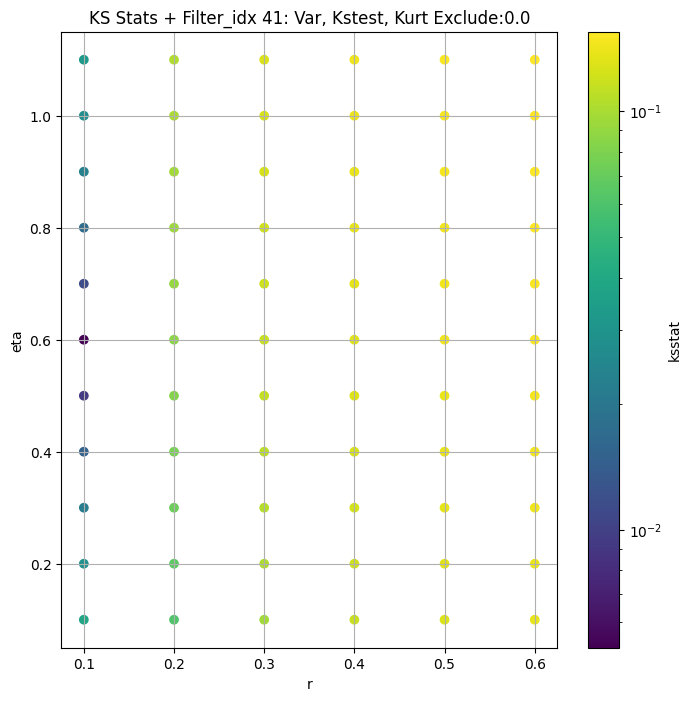

####
Filter_idx  42


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 0 0.013569272745366123 79.81629048453834


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 50 0.014643415356455303 69.84769842691641


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 100 0.01566835469067318 65.28720223174535


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 200 0.018876795066990748 59.01149971548244
Number of samples: 100000, Without approximation : 480000000.0


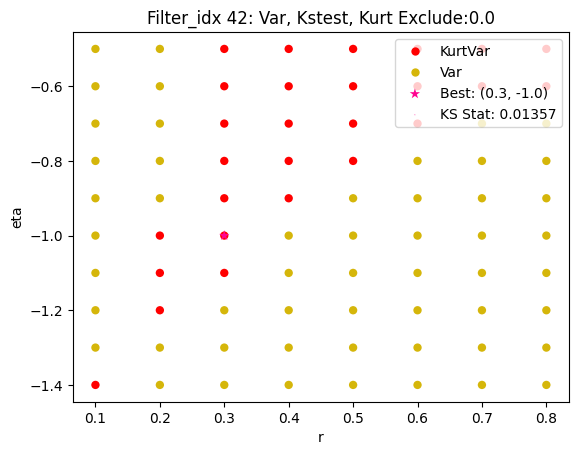

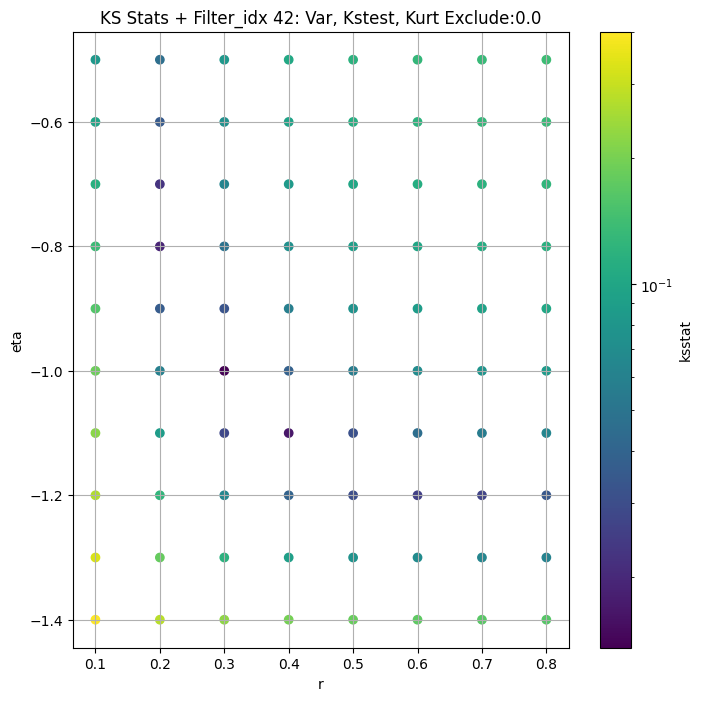

####
Filter_idx  43


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 0 0.020336078580983297 28.662572335018726


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 50 0.019589292113122825 25.349207031642973


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 100 0.020078005606296634 23.93444582399372


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 200 0.01845581936978502 21.97140367887118
Number of samples: 100000, Without approximation : 480000000.0


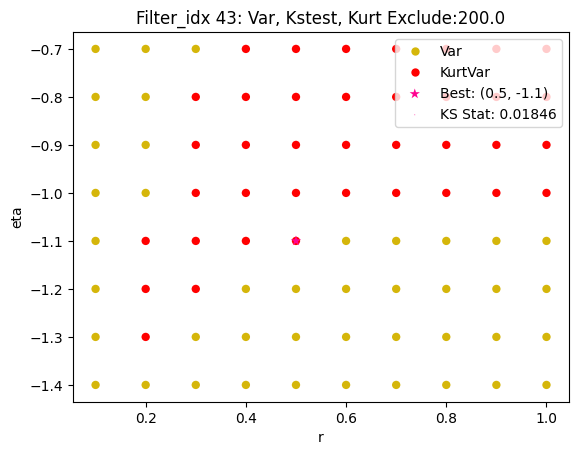

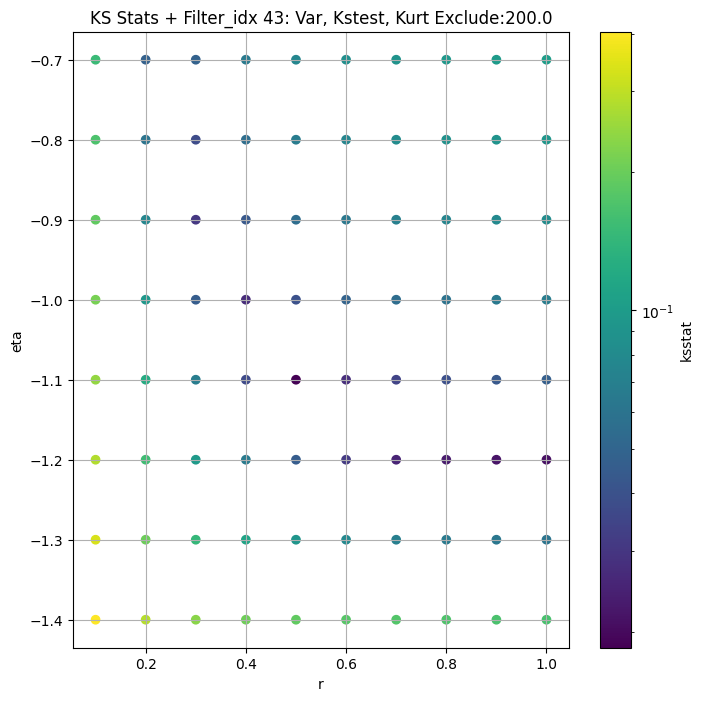

####
Filter_idx  44


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 0 0.020081368189599047 59.93764812799737


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 50 0.020411492928030184 51.82108578496918


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 100 0.02088346160468768 48.53548848999029


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 200 0.021709123843223765 44.02646671016402
Number of samples: 100000, Without approximation : 480000000.0


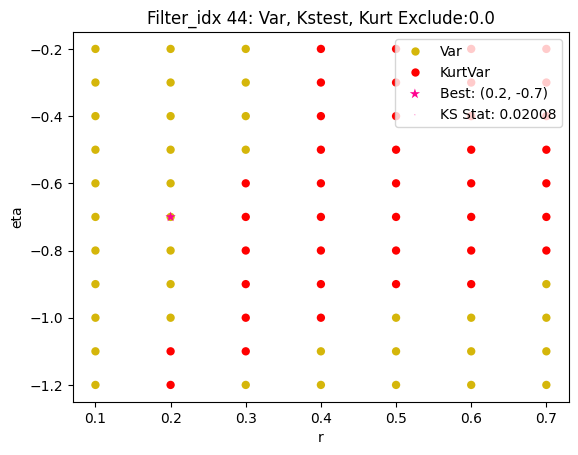

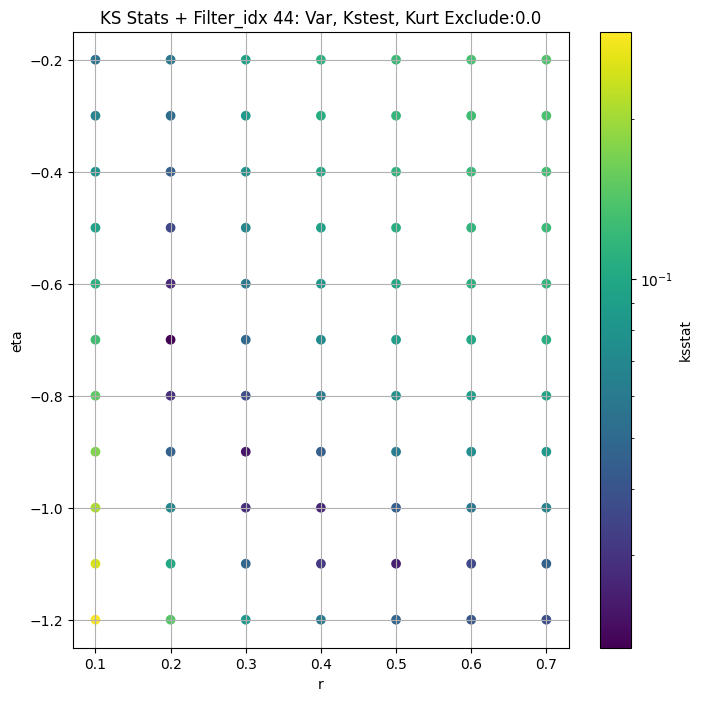

####
Filter_idx  45


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 0 0.029810440914504077 38.247326316433096


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 50 0.029691183801897947 33.99733075133163


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 100 0.029751852830145142 32.10338023168654


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 200 0.029966950368865763 29.4947584019459
Number of samples: 100000, Without approximation : 480000000.0


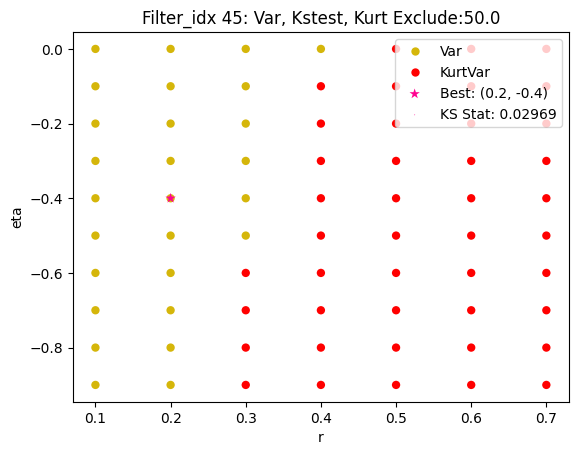

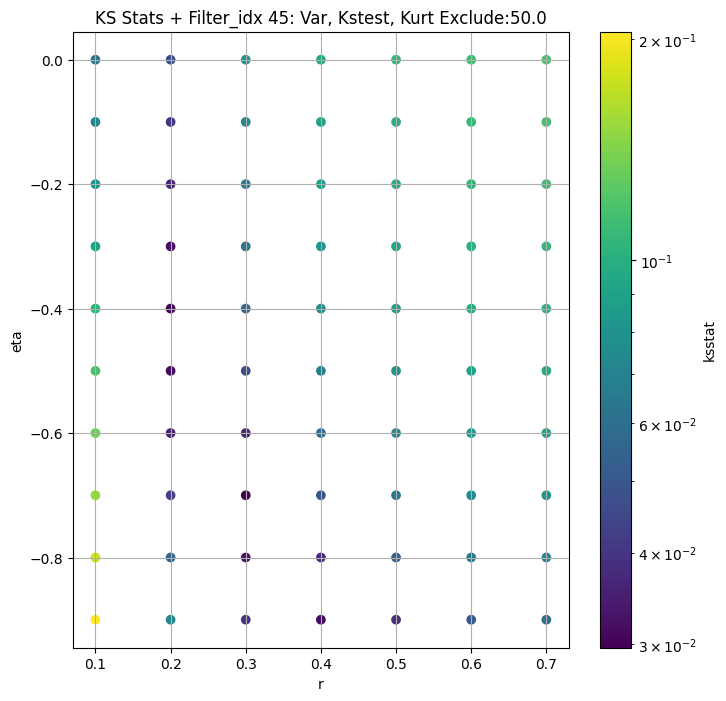

####
Filter_idx  46


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 0 0.044697474777344426 25.53210717746388


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 50 0.04449053108170781 23.418767947234596


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 100 0.044633172588143366 22.369063350257207


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 200 0.0446449734940052 20.886748476312185
Number of samples: 100000, Without approximation : 480000000.0


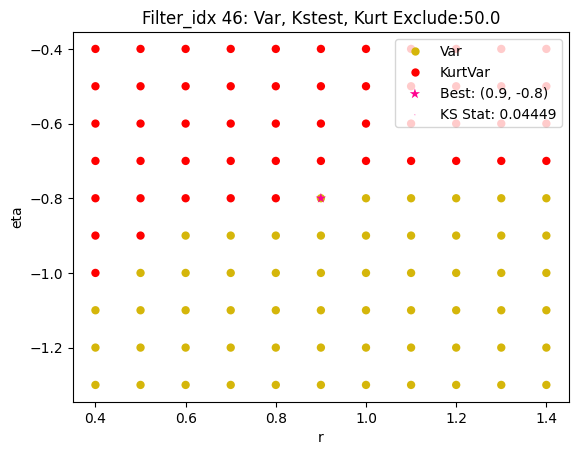

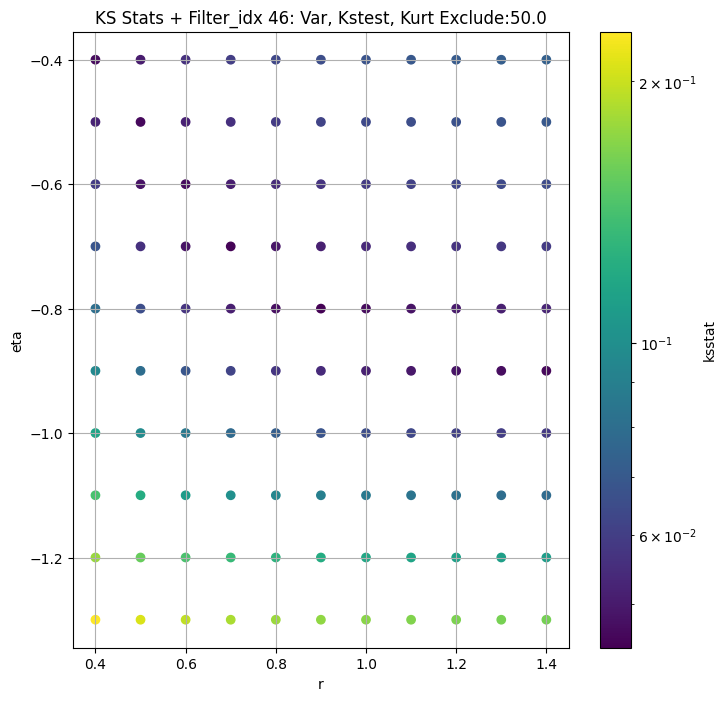

####
Filter_idx  47


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 0 0.014007115288795502 48.593674932079985


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 50 0.014118685393363473 44.55247913090221


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 100 0.014052460219997287 42.556503373529196


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 200 0.01397335724695059 39.63314787522847
Number of samples: 100000, Without approximation : 480000000.0


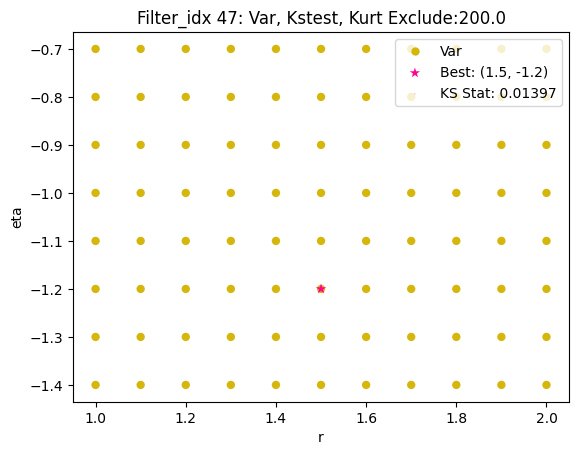

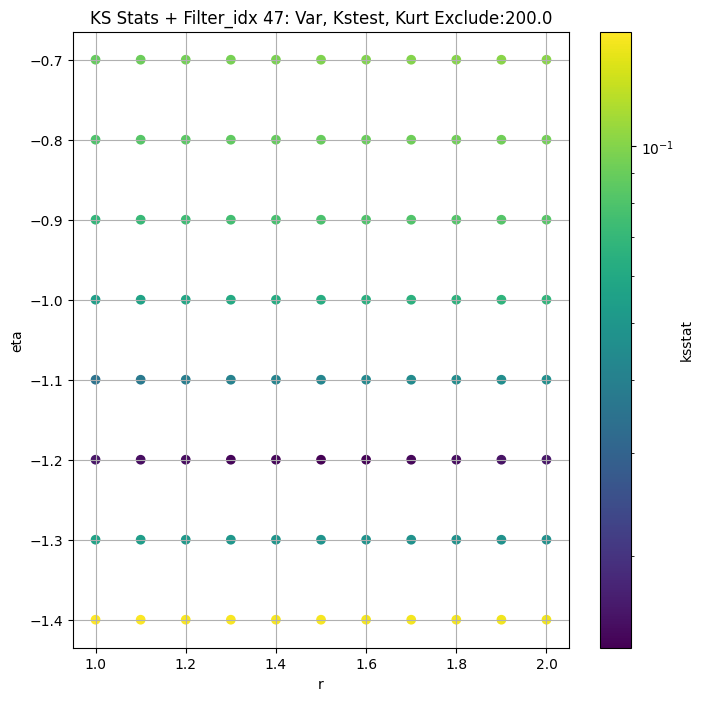

####
Filter_idx  48


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 0 0.01290162672595041 19.873367008314258


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 50 0.012477591650951081 17.087272150112394


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 100 0.013351067805739136 15.972620119065335


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 200 0.013812284204163139 14.462161445522767
Number of samples: 100000, Without approximation : 480000000.0


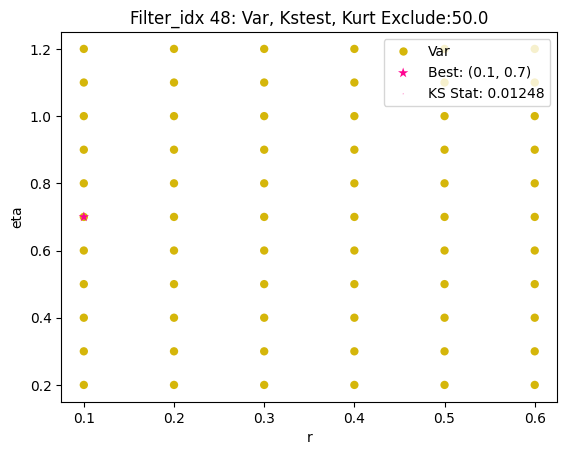

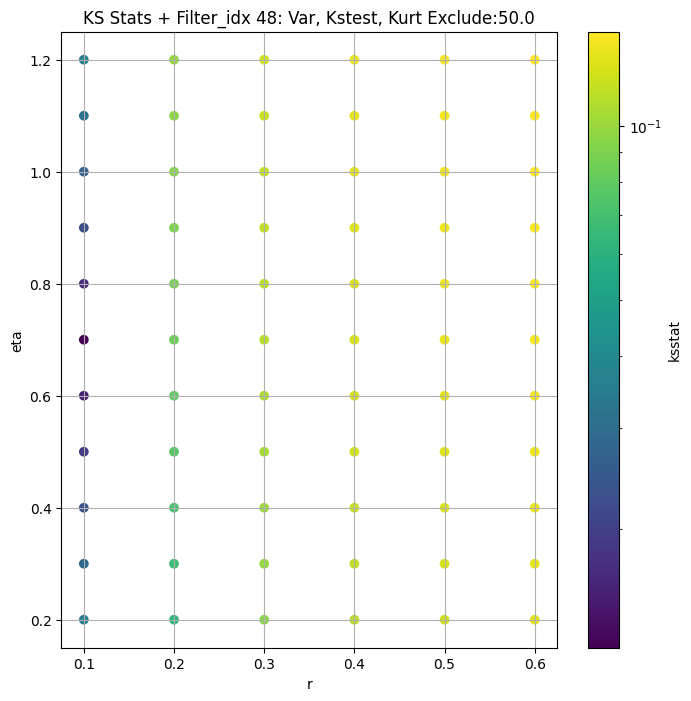

####
Filter_idx  49


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 0 0.01663748213317766 76.5977280890017


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 50 0.021479262373556185 66.60957126501138


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 100 0.01861893215202276 62.050744274010206


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 200 0.021449104825871035 55.84671689499722
Number of samples: 100000, Without approximation : 480000000.0


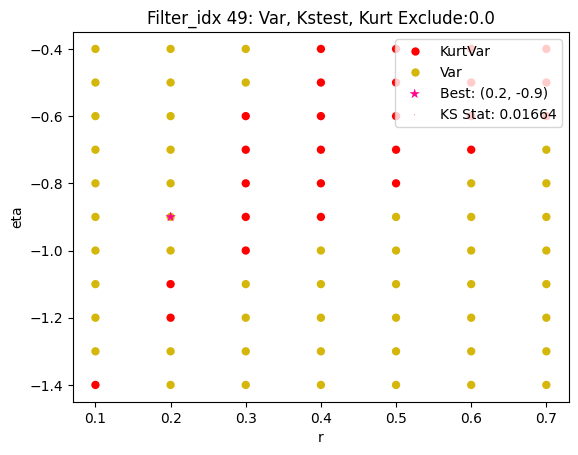

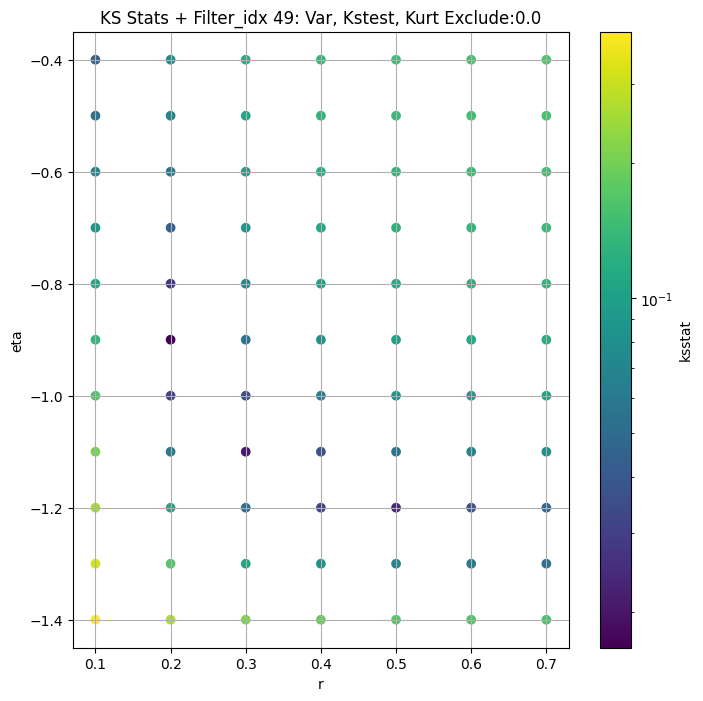

####
Filter_idx  50


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 0 0.021234930689573828 59.35954275709163


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 50 0.02336575786998285 52.32508544292717


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 100 0.021535873479502754 49.23804999145312


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 200 0.020681861942695057 44.980454670419576
Number of samples: 100000, Without approximation : 480000000.0


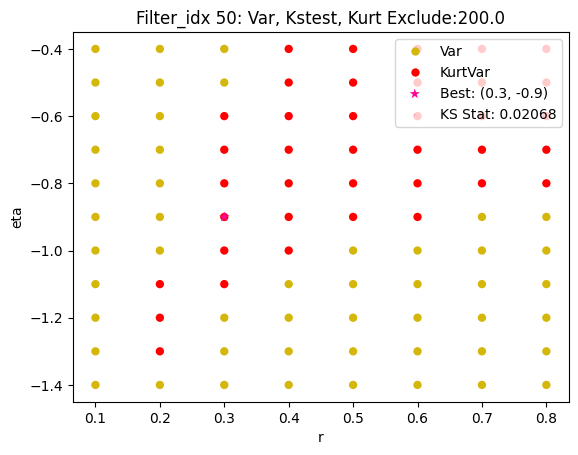

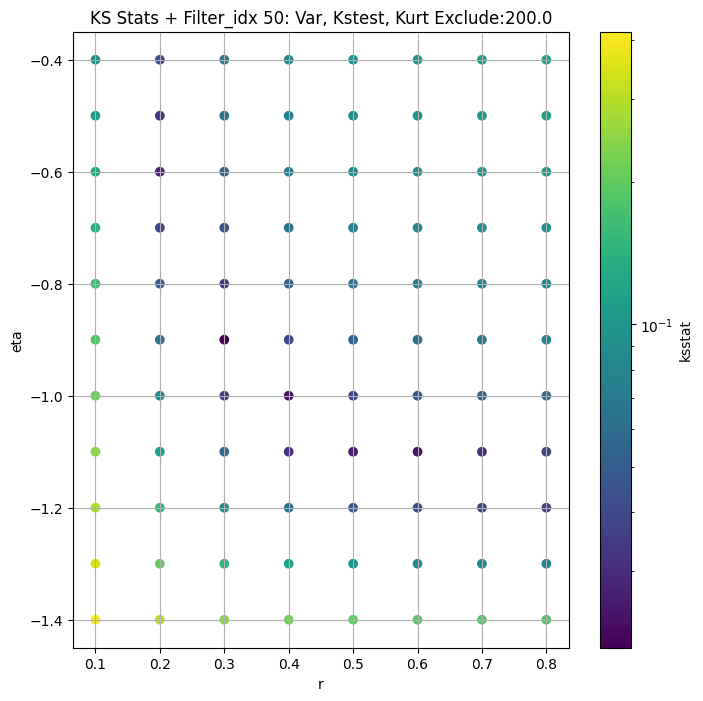

####
Filter_idx  52


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 0 0.01779022052888457 40.777805569456824


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 50 0.017683304372124564 37.97883351489965


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 100 0.017492863447832185 36.58273614435795


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 200 0.017379144480191067 34.645678581720496
Number of samples: 100000, Without approximation : 480000000.0


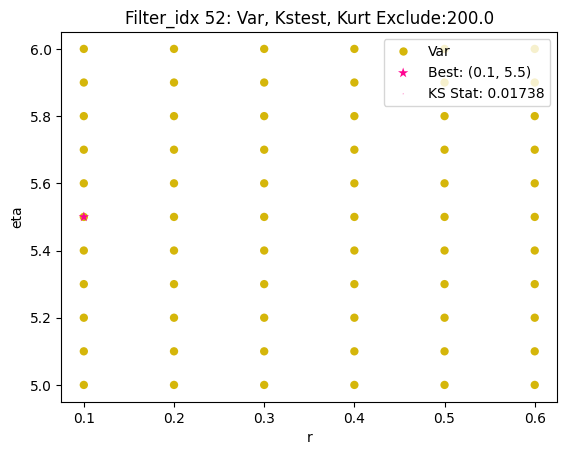

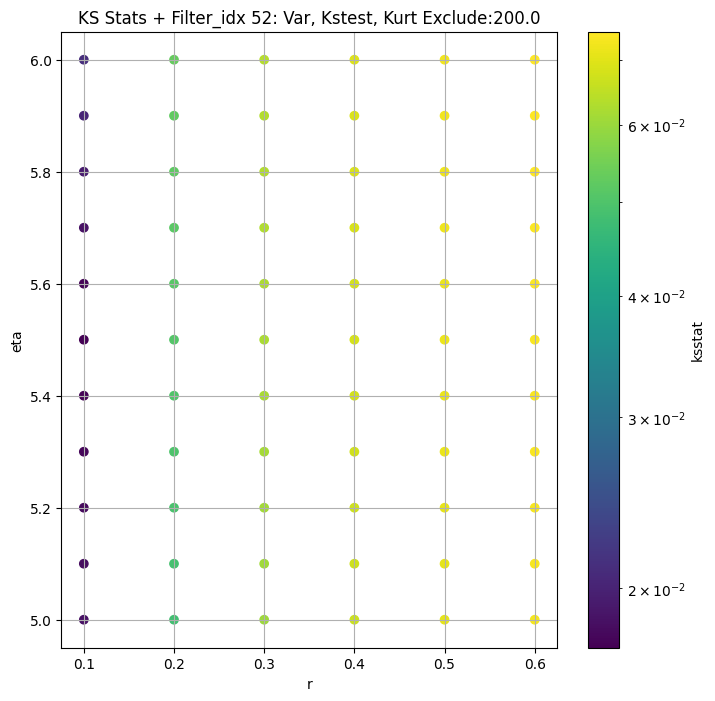

####
Filter_idx  54


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 0 0.004820383675500667 6.529077828183722


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 50 0.004239112127095546 5.287061585995803


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 100 0.00476820199952932 4.96229327212874


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 200 0.006515496088386037 4.543710576945346
Number of samples: 100000, Without approximation : 480000000.0


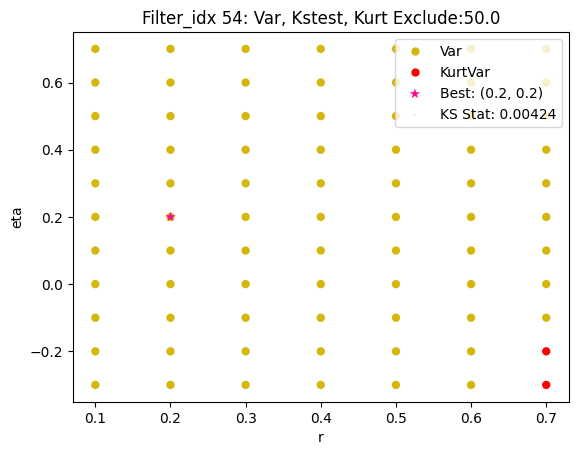

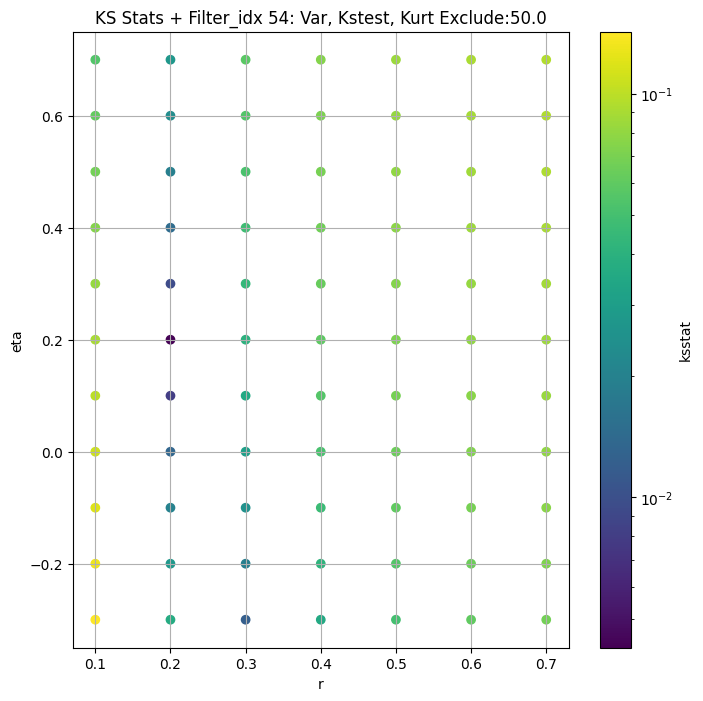

####
Filter_idx  55


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 0 0.007843924582737694 31.917315459019385


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 50 0.008125273839436509 26.68851865852578


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 100 0.009726660775254192 24.731492335073938


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 200 0.009877757621569727 22.182112221132765
Number of samples: 100000, Without approximation : 480000000.0


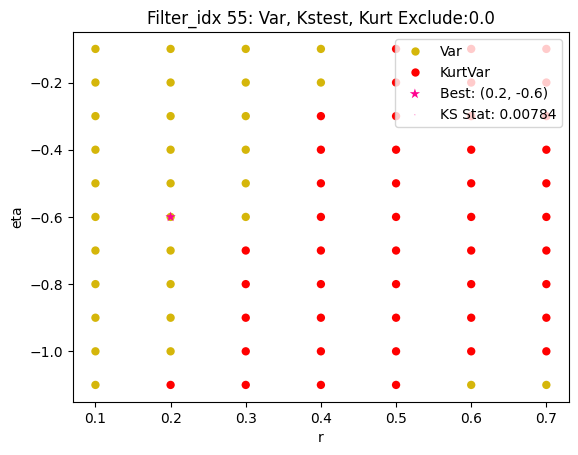

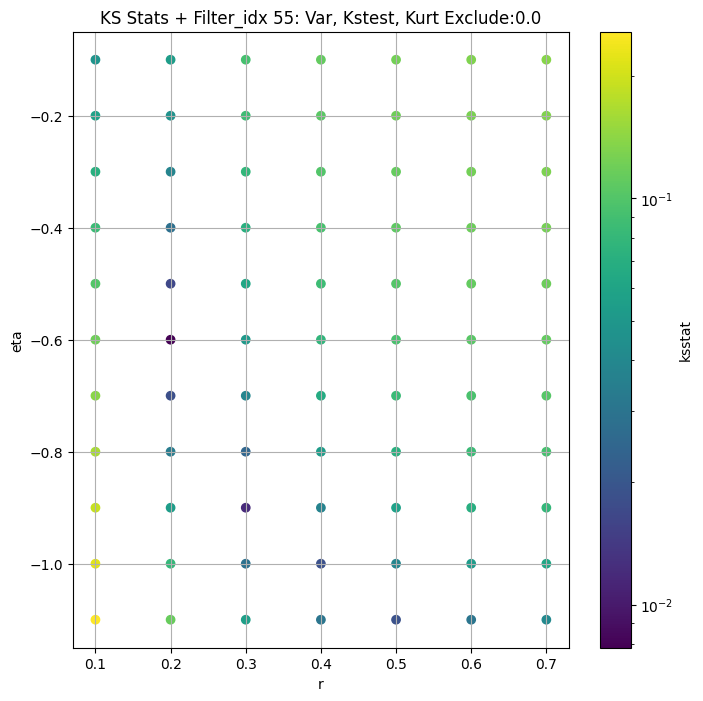

####
Filter_idx  56


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 0 0.0195188210161642 65.71891184267646


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 50 0.015612169647200802 58.652725953662916


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 100 0.015061495010820214 55.238446074192744


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 200 0.016133142800446004 50.44076424530852
Number of samples: 100000, Without approximation : 480000000.0


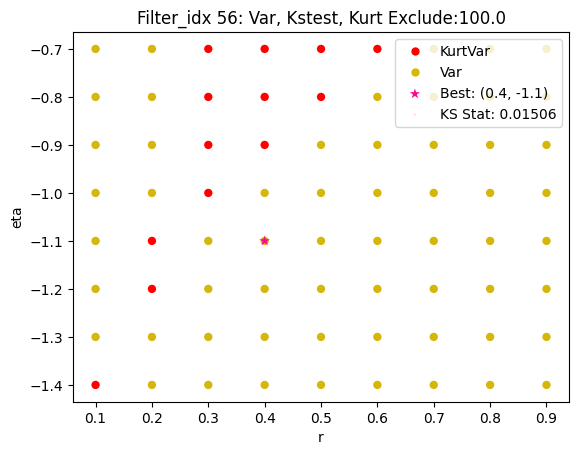

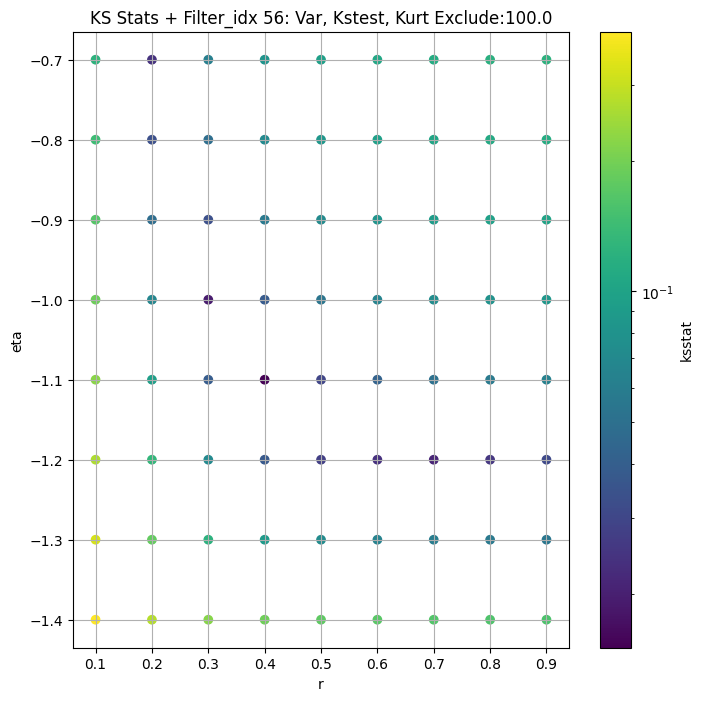

####
Filter_idx  57


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 0 0.017523491618095632 49.04221990353983


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 50 0.011512392617106681 42.79186603012281


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 100 0.013086520485429382 40.176444931728675


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 200 0.01261284448960942 36.61000135232902
Number of samples: 100000, Without approximation : 480000000.0


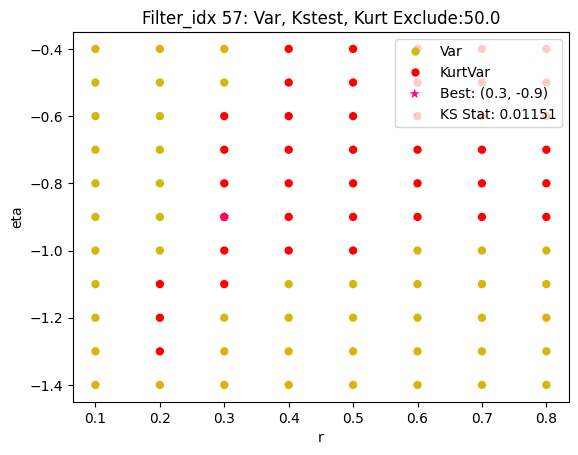

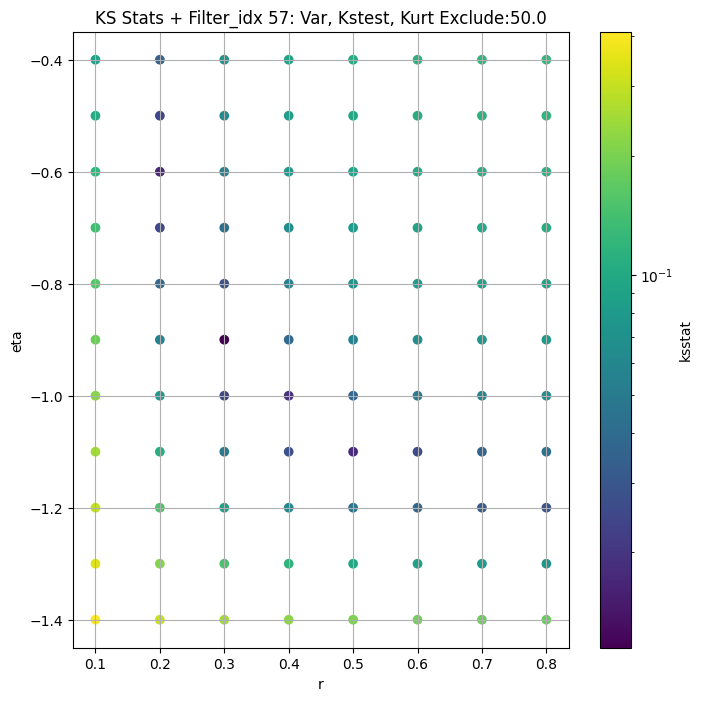

####
Filter_idx  58


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 0 0.029569789286060022 22.23282569748327


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 50 0.029392952067266276 20.779344330836942


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 100 0.02900732329334854 20.061698259100698


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 200 0.02865907417730923 19.039150386550713
Number of samples: 100000, Without approximation : 480000000.0


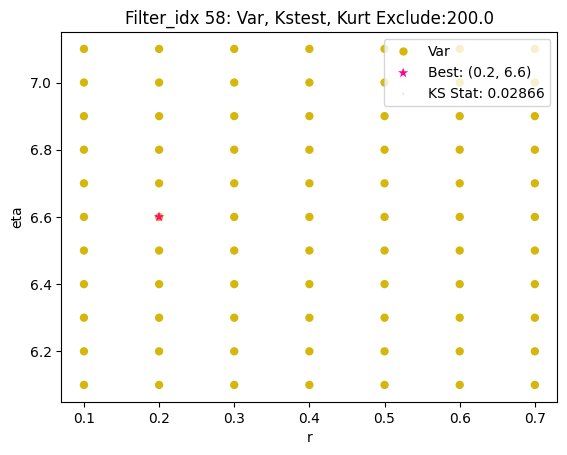

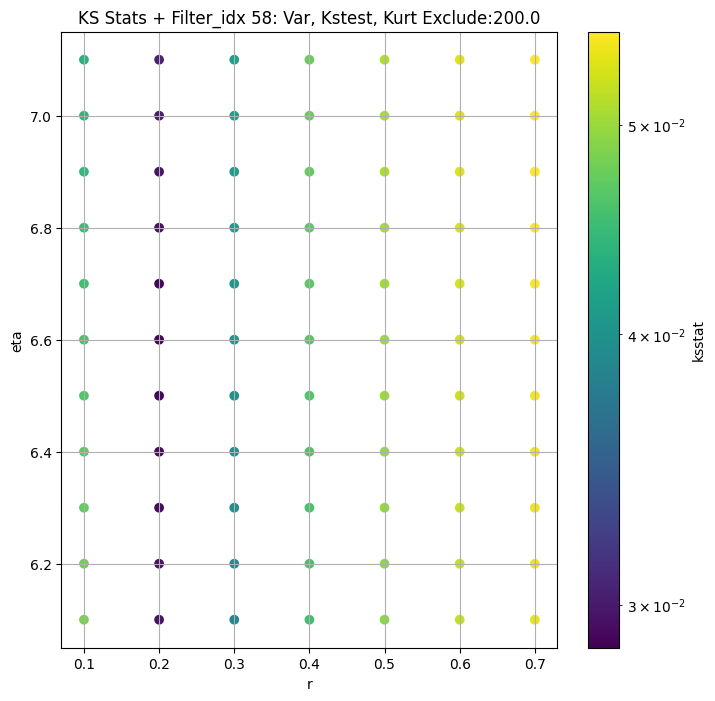

####
Filter_idx  59


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 0 0.014609897520175608 79.85097503697276


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 50 0.014521437393794301 72.64334766805433


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 100 0.014310966552139703 69.11267087970396


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 200 0.013949131261950909 64.05197506921688
Number of samples: 100000, Without approximation : 480000000.0


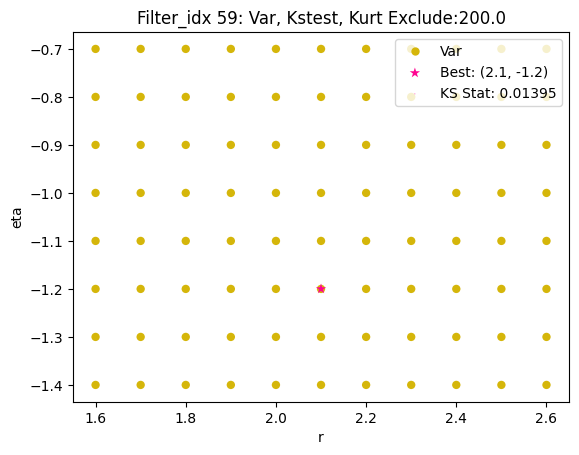

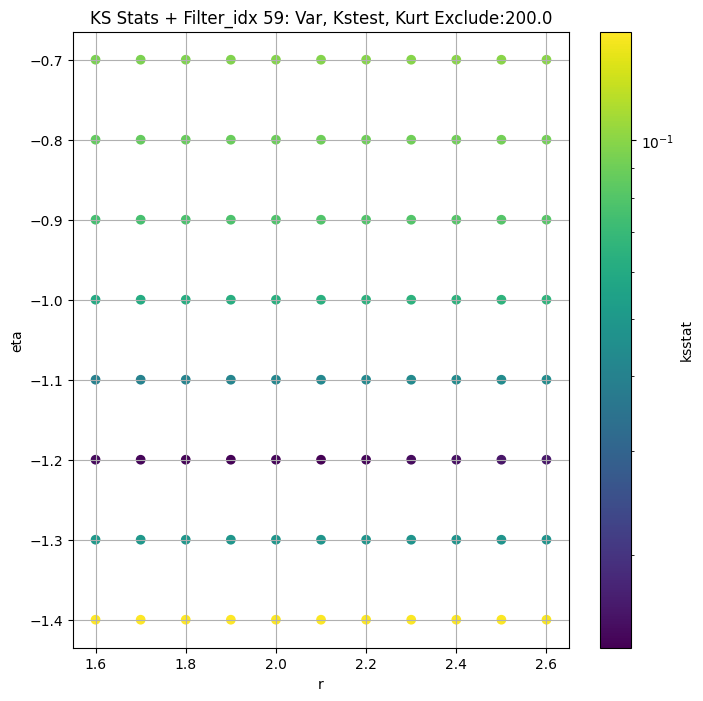

####
Filter_idx  60


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 0 0.011470132131158606 5.2418330279673535


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 50 0.010502168892672636 4.57596960597704


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 100 0.010428708360207373 4.3323063798977985


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 200 0.010410193321072903 4.004164149917366
Number of samples: 100000, Without approximation : 480000000.0


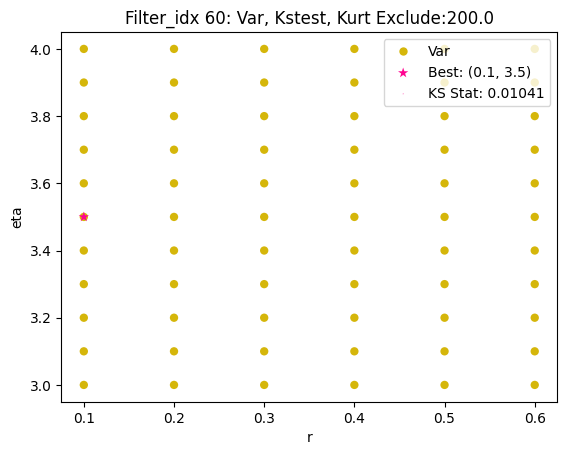

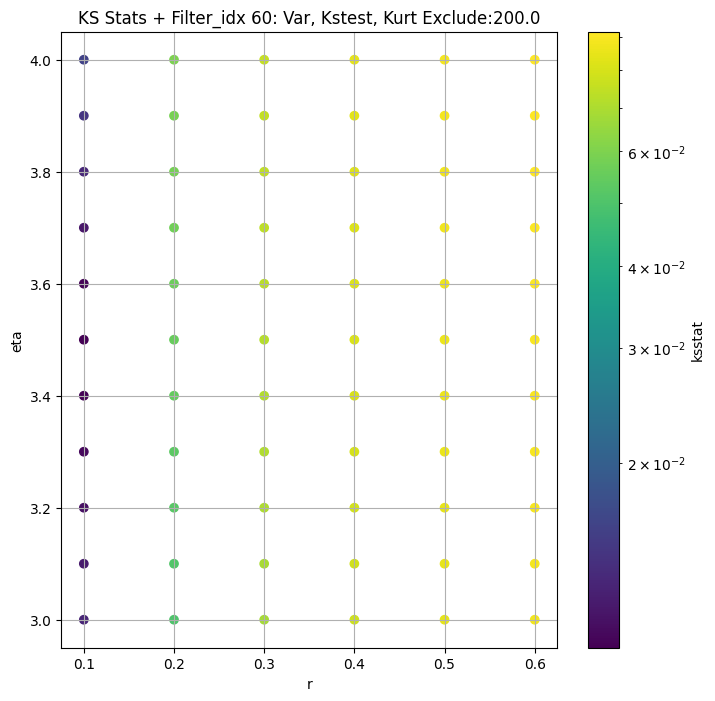

####
Filter_idx  61


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 0 0.014559916478471435 20.290319875974852


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 50 0.013391777068244903 17.860867392365737


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 100 0.011719384875054889 16.818241958849438


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 200 0.015275925504235288 15.397509884541643
Number of samples: 100000, Without approximation : 480000000.0


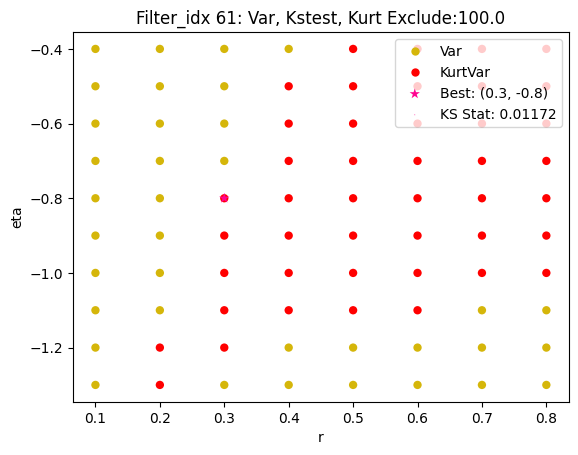

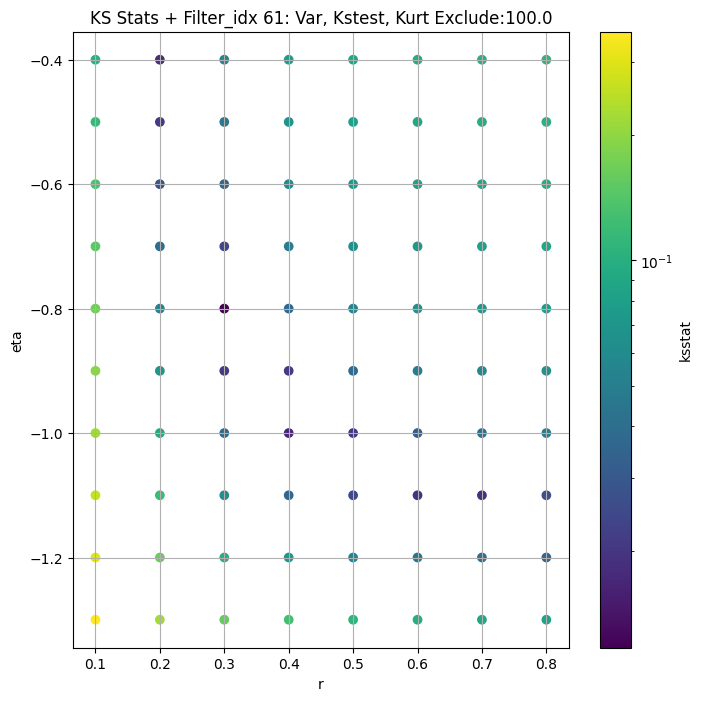

####
Filter_idx  62


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 0 0.035168452199842215 60.90431571509468


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 50 0.03461412148499332 55.279509039152536


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 100 0.0346875576186238 52.47972420830983


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 200 0.034889331617586006 48.50135838432203
Number of samples: 100000, Without approximation : 480000000.0


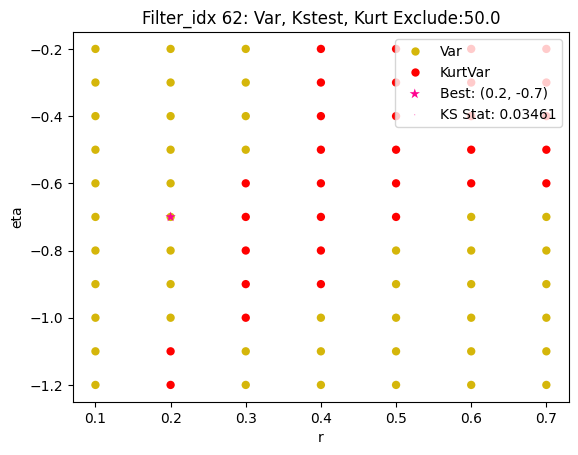

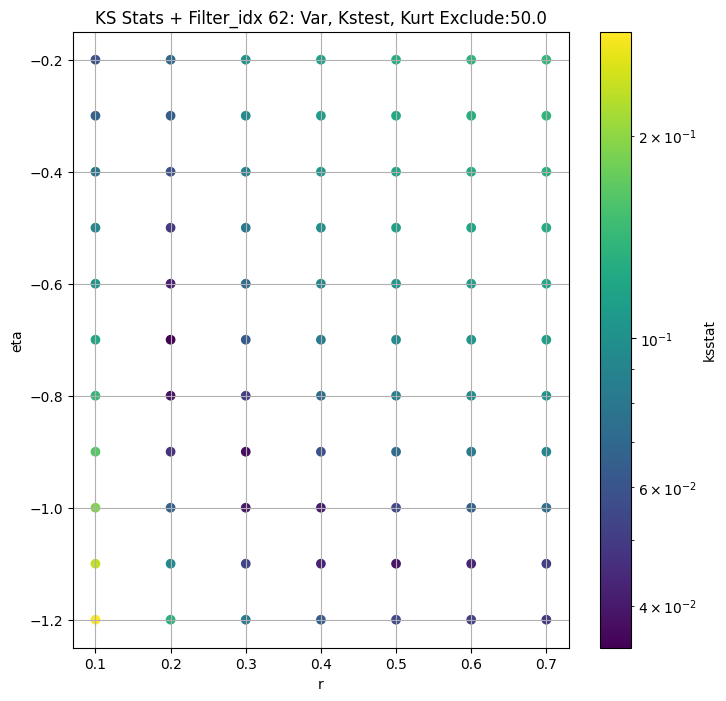

####
Filter_idx  63


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 0 0.006407645008664475 15.903836474724766


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 50 0.0037645868661613235 13.157286553928335


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 100 0.004107709164276933 12.250818791143669


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 200 0.005349325255667059 11.08722423890169
Number of samples: 100000, Without approximation : 480000000.0


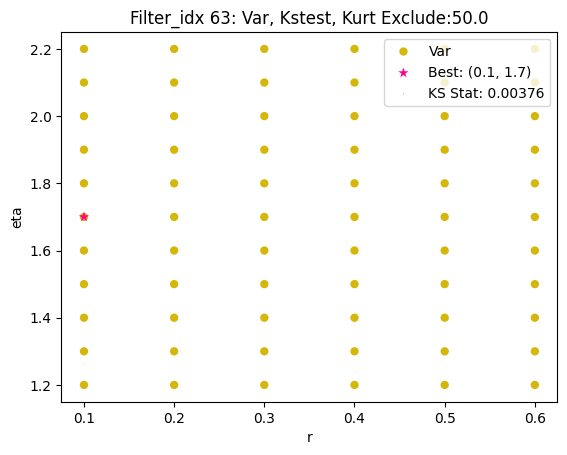

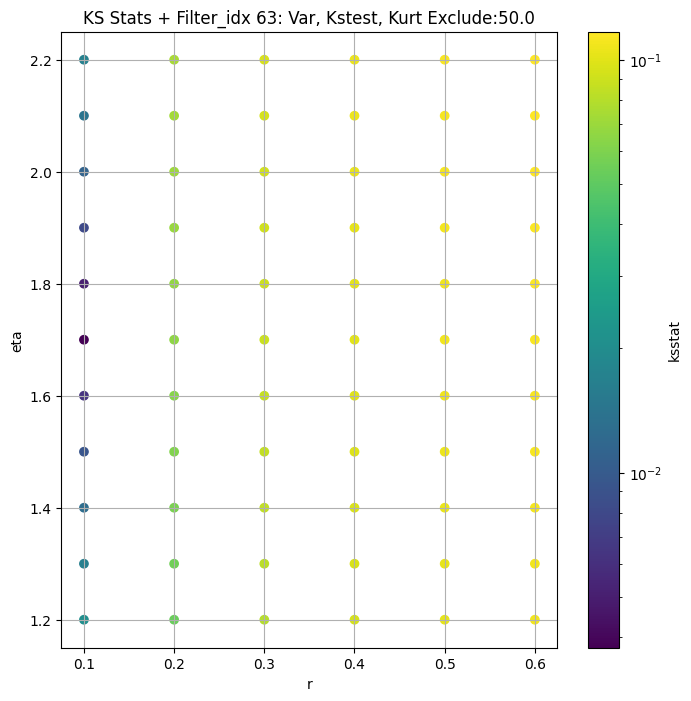

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,
0,57.214930,36.411798,123.231320,41.285444,8.164086,290.107658,480000000.0,dual_color,0.026880,0.1,0.3,1.639573e-12,50.0,50.193220,0.000062
2,82.084655,53.717774,153.965127,37.569183,8.917034,238.811972,480000000.0,dual_color,0.011517,0.2,-0.8,1.943767e-02,0.0,82.084655,0.000062
3,22.611322,14.994184,56.104513,71.905866,6.891111,399.202547,480000000.0,single_edge,0.007990,0.2,-0.5,1.495458e-03,0.0,22.611322,0.000062
4,94.077089,65.025735,156.865921,21.475630,7.446571,115.107643,480000000.0,dual_color,0.014987,0.3,-1.0,3.057587e+00,100.0,81.287691,0.000062
5,57.483240,41.660774,87.700814,15.550781,5.322732,125.788486,480000000.0,dual_color,0.026122,0.4,-1.0,1.090008e+01,50.0,53.189323,0.000062
6,43.728233,28.124144,96.209185,43.878386,6.806653,310.438016,480000000.0,single_edge,0.017838,0.5,-1.1,2.673523e+01,50.0,38.498728,0.000062
7,24.626245,18.353888,40.167357,15.670190,3.287687,146.797712,480000000.0,inside_out,0.041974,1.1,-0.5,2.484352e+01,100.0,21.916147,0.000062
8,1.924674,1.357594,6.607376,122.928559,3.710739,541.449082,480000000.0,misc,0.018556,0.2,1.4,1.399414e-06,50.0,1.680118,0.000062
9,9.369960,5.267412,83.557988,993.476242,6.442853,796.346524,480000000.0,multi_edge,0.003558,0.2,0.0,9.661795e-05,50.0,7.065595,0.000062


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()} ", group)
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0


  0%|          | 0/612 [00:00<?, ?it/s]

Finding Minimum after computing 612 CDFs
filter_idx 0, 50.0 + 100 = 150, ksstat: 0.0271691724480444, var: 44.72320210395609


  0%|          | 0/612 [00:00<?, ?it/s]

Finding Minimum after computing 612 CDFs
filter_idx 0, 50.0 + 75 = 125, ksstat: 0.026838035048822706, var: 45.82856914666583


  0%|          | 0/612 [00:00<?, ?it/s]

Finding Minimum after computing 612 CDFs
filter_idx 0, 50.0 + 50 = 100, ksstat: 0.026911080452081626, var: 47.067689970479776


  0%|          | 0/612 [00:00<?, ?it/s]

Finding Minimum after computing 612 CDFs
filter_idx 0, 50.0 + 25 = 75, ksstat: 0.02692029190595413, var: 48.49087567332295


  0%|          | 0/612 [00:00<?, ?it/s]

Finding Minimum after computing 612 CDFs
filter_idx 0, 50.0 + 0 = 50, ksstat: 0.026862227485357992, var: 50.19321977097515


  0%|          | 0/612 [00:00<?, ?it/s]

Finding Minimum after computing 612 CDFs
filter_idx 0, 50.0 + -25 = 25, ksstat: 0.026836031996326115, var: 52.40189528826295


  0%|          | 0/612 [00:00<?, ?it/s]

Finding Minimum after computing 612 CDFs
filter_idx 0, 50.0 + -50 = 0, ksstat: 0.026836693799263178, var: 57.21493021594356
Number of samples: 100000, Without approximation : 480000000.0


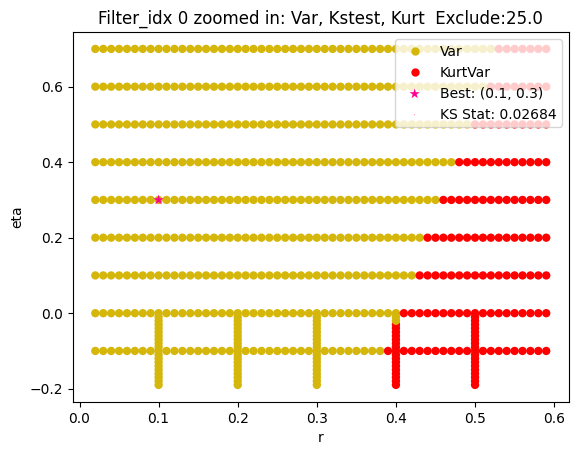

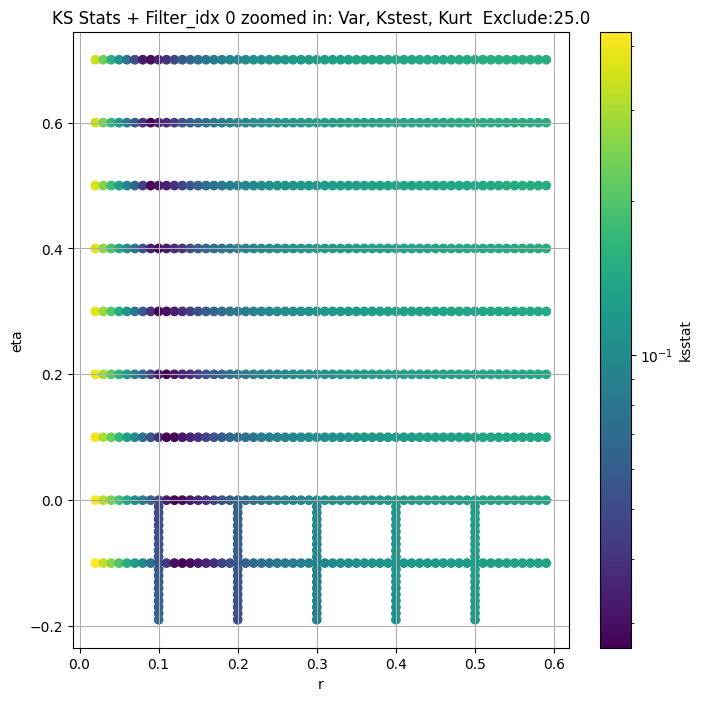

Filter_idx 2


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 2, 0.0 + 100 = 100, ksstat: 0.012874779822553944, var: 67.8281779722381


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 2, 0.0 + 75 = 75, ksstat: 0.013320002553887433, var: 69.90335242576928


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 2, 0.0 + 50 = 50, ksstat: 0.012404897910184953, var: 72.3551732517906


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 2, 0.0 + 25 = 25, ksstat: 0.012044696846325809, var: 75.4789270023589


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 2, 0.0 + 0 = 0, ksstat: 0.011517185838413851, var: 82.08465452392318
Number of samples: 100000, Without approximation : 480000000.0


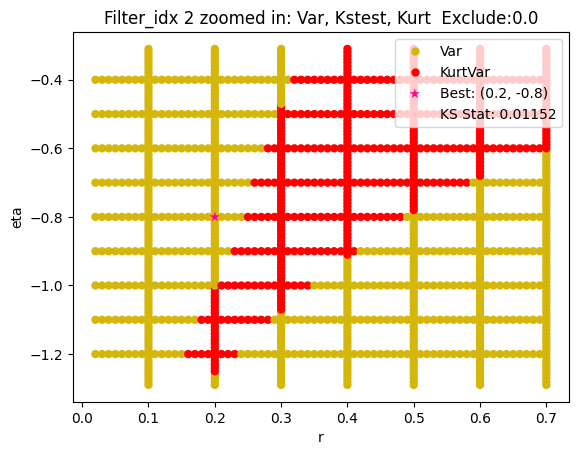

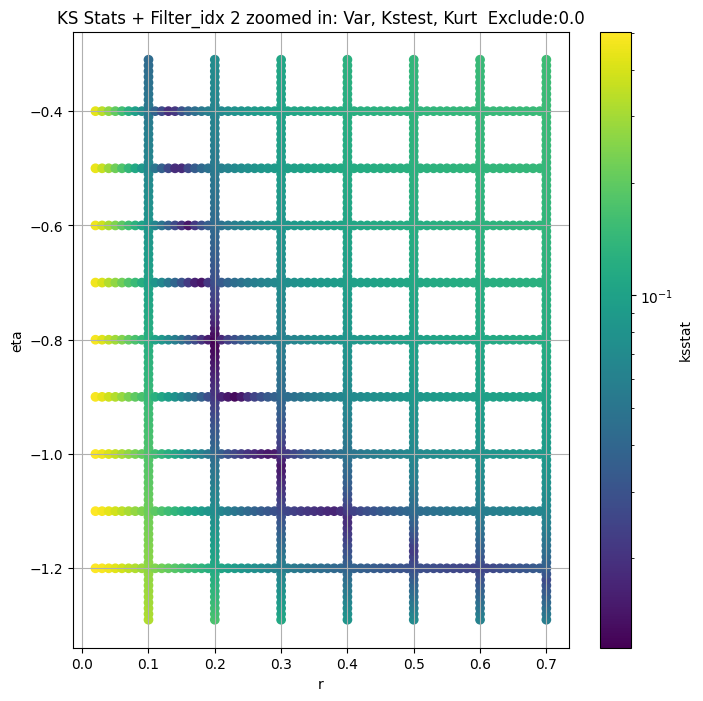

Filter_idx 3


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 0.0 + 100 = 100, ksstat: 0.008041334707937386, var: 18.41174502169789


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 0.0 + 75 = 75, ksstat: 0.0073161796128888845, var: 18.94299566259967


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 0.0 + 50 = 50, ksstat: 0.007583539997137678, var: 19.57848558955904


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 0.0 + 25 = 25, ksstat: 0.007386907745763005, var: 20.406631047721937


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 3, 0.0 + 0 = 0, ksstat: 0.007194324739481783, var: 22.61132184256137
Number of samples: 100000, Without approximation : 480000000.0


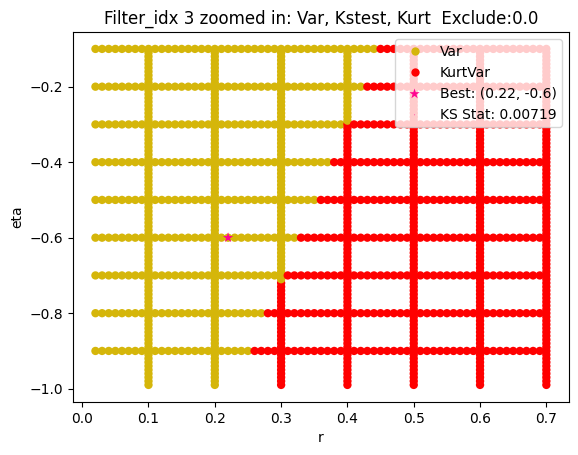

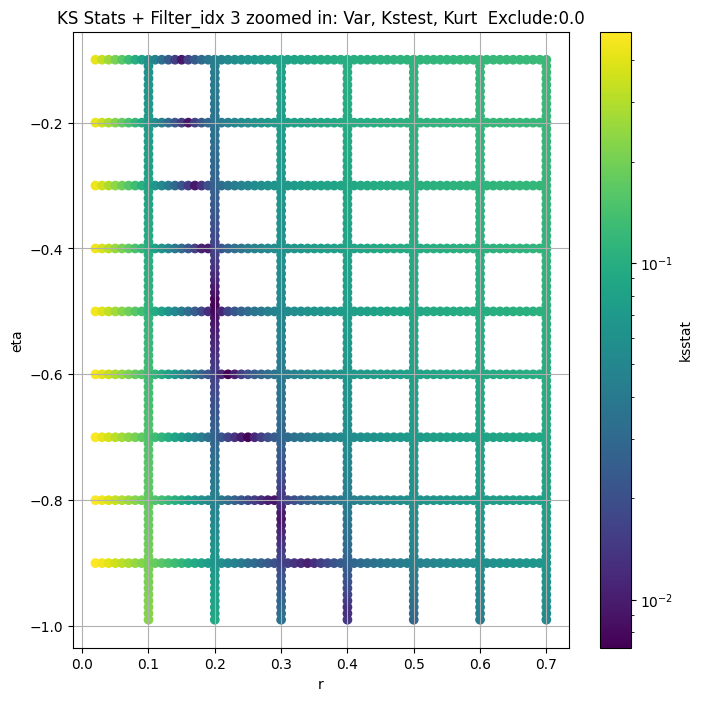

Filter_idx 4


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + 100 = 200, ksstat: 0.016321311937511296, var: 74.85091958529381


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + 75 = 175, ksstat: 0.016113676267267008, var: 76.27654489399251


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + 50 = 150, ksstat: 0.01598250712997451, var: 77.80761901460983


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + 25 = 125, ksstat: 0.015862083666446813, var: 79.46621157740594


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + 0 = 100, ksstat: 0.014987236543378815, var: 81.28769149552619


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + -25 = 75, ksstat: 0.014640424490160786, var: 83.32736318557622


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + -50 = 50, ksstat: 0.01417754615480582, var: 85.68738289968486


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + -75 = 25, ksstat: 0.013988884783494415, var: 88.60184102372854


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 4, 100.0 + -100 = 0, ksstat: 0.014532984395955184, var: 94.07708921865792
Number of samples: 100000, Without approximation : 480000000.0


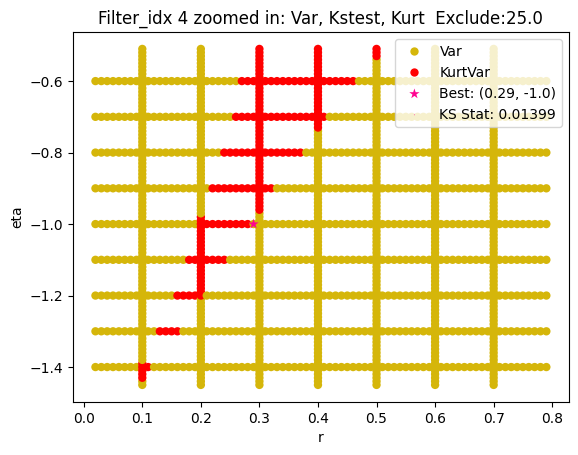

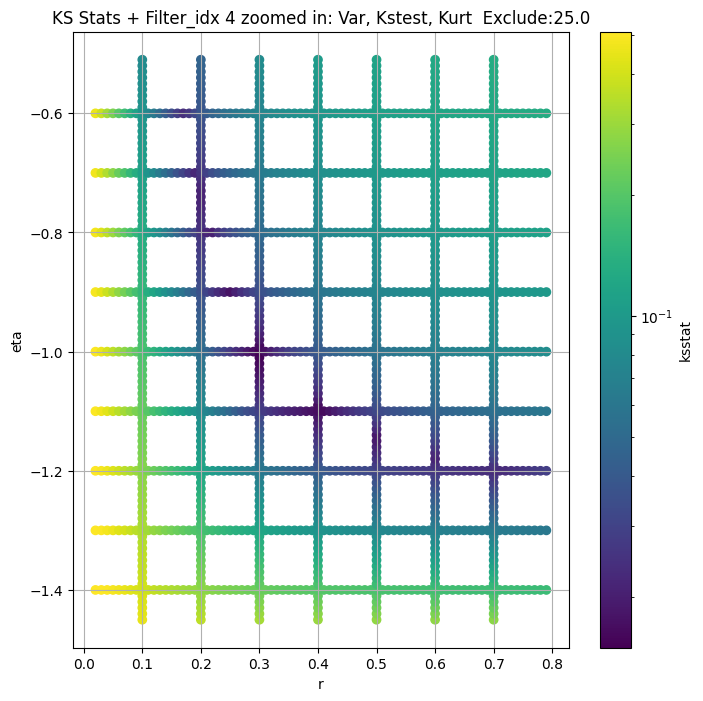

Filter_idx 5


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 5, 50.0 + 100 = 150, ksstat: 0.025993226186131868, var: 49.204976506312185


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 5, 50.0 + 75 = 125, ksstat: 0.025951462696834016, var: 50.044836634773475


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 5, 50.0 + 50 = 100, ksstat: 0.026058286573744094, var: 50.966374475118855


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 5, 50.0 + 25 = 75, ksstat: 0.026144212832317493, var: 51.997398413330366


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 5, 50.0 + 0 = 50, ksstat: 0.02612156786485126, var: 53.189322625969


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 5, 50.0 + -25 = 25, ksstat: 0.02605306095994414, var: 54.66328956560983


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 5, 50.0 + -50 = 0, ksstat: 0.026105413903275976, var: 57.48323999942135
Number of samples: 100000, Without approximation : 480000000.0


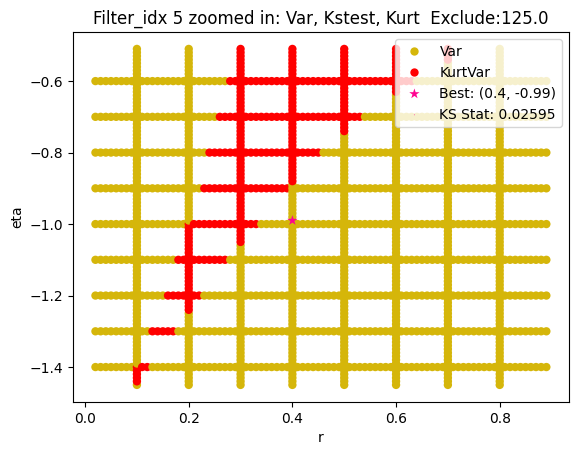

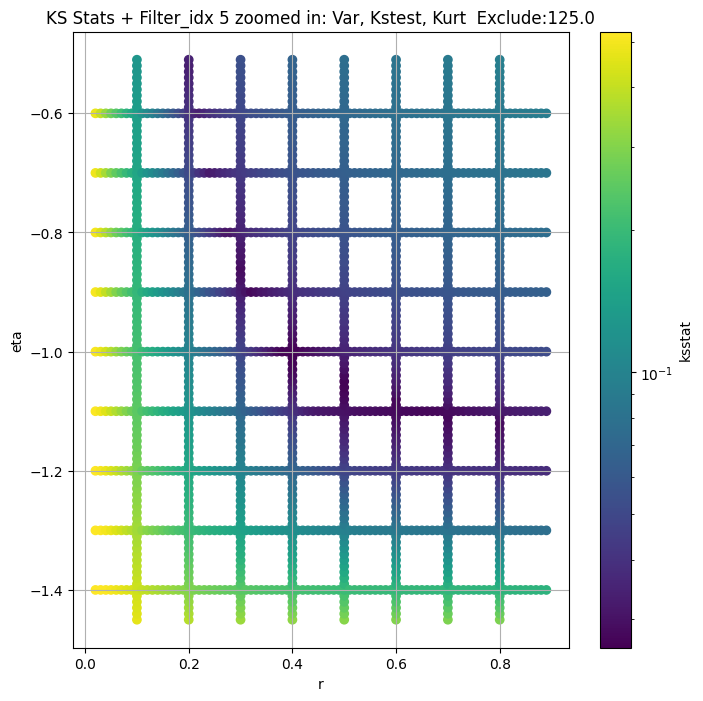

Filter_idx 6


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 50.0 + 100 = 150, ksstat: 0.015502936568597192, var: 34.44939790885732


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 50.0 + 75 = 125, ksstat: 0.01509281231492876, var: 35.270581602179426


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 50.0 + 50 = 100, ksstat: 0.015302275309932, var: 36.190036171595565


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 50.0 + 25 = 75, ksstat: 0.014800086496603693, var: 37.24409506408994


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 50.0 + 0 = 50, ksstat: 0.015227392366192638, var: 38.4987279239758


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 50.0 + -25 = 25, ksstat: 0.014870461273189806, var: 40.10946192608547


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 6, 50.0 + -50 = 0, ksstat: 0.014399285009894014, var: 43.7282332401113
Number of samples: 100000, Without approximation : 480000000.0


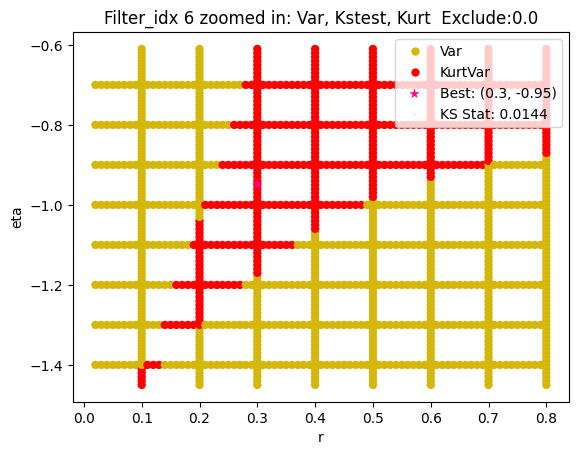

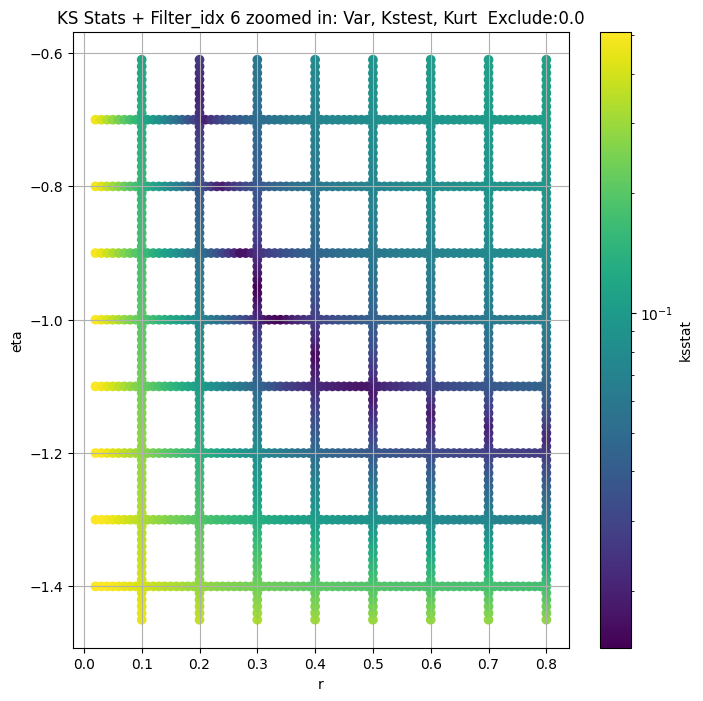

Filter_idx 7


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 7, 100.0 + 100 = 200, ksstat: 0.04193703648865127, var: 20.67557048411248


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 7, 100.0 + 75 = 175, ksstat: 0.04193643407661474, var: 20.947780802620432


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 7, 100.0 + 50 = 150, ksstat: 0.04194292160230684, var: 21.24145571574276


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 7, 100.0 + 25 = 125, ksstat: 0.04195069435261328, var: 21.561637229214952


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 7, 100.0 + 0 = 100, ksstat: 0.041950586261125355, var: 21.916147153552544


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 7, 100.0 + -25 = 75, ksstat: 0.04193510485705787, var: 22.317551619502144


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 7, 100.0 + -50 = 50, ksstat: 0.04194612521895891, var: 22.788769183608455


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 7, 100.0 + -75 = 25, ksstat: 0.0419453278354478, var: 23.383313808980613


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 7, 100.0 + -100 = 0, ksstat: 0.04193978898077022, var: 24.626245413153047
Number of samples: 100000, Without approximation : 480000000.0


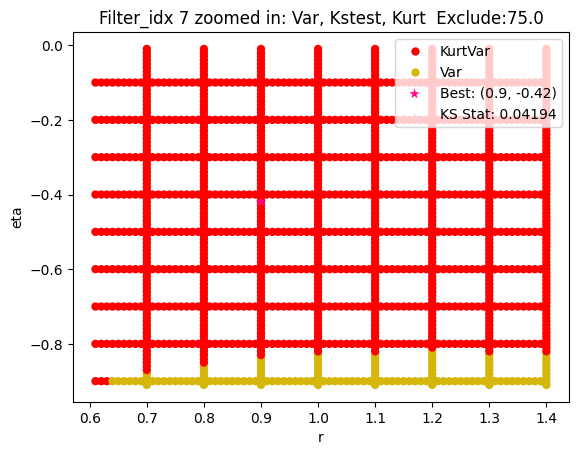

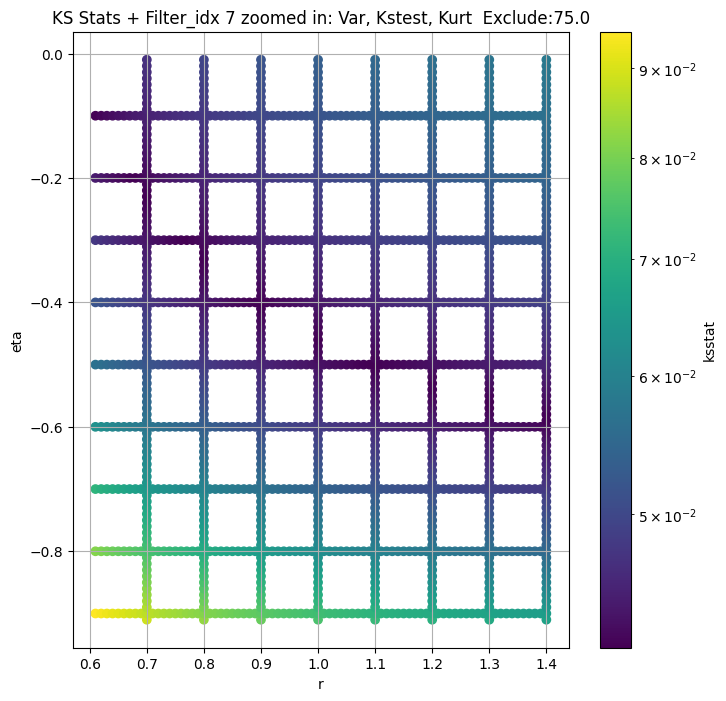

Filter_idx 8


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 8, 50.0 + 100 = 150, ksstat: 0.018555508175273294, var: 1.5501455492972764


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 8, 50.0 + 75 = 125, ksstat: 0.018557807973354712, var: 1.5764632648801593


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 8, 50.0 + 50 = 100, ksstat: 0.01855715643664152, var: 1.605893818522322


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 8, 50.0 + 25 = 75, ksstat: 0.018556467157605505, var: 1.6396607282941456


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 8, 50.0 + 0 = 50, ksstat: 0.018555584216111143, var: 1.6801180148886026


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 8, 50.0 + -25 = 25, ksstat: 0.018555307655833242, var: 1.7332301777595163


  0%|          | 0/690 [00:00<?, ?it/s]

Finding Minimum after computing 690 CDFs
filter_idx 8, 50.0 + -50 = 0, ksstat: 0.01855517303320986, var: 1.9246735623647266
Number of samples: 100000, Without approximation : 480000000.0


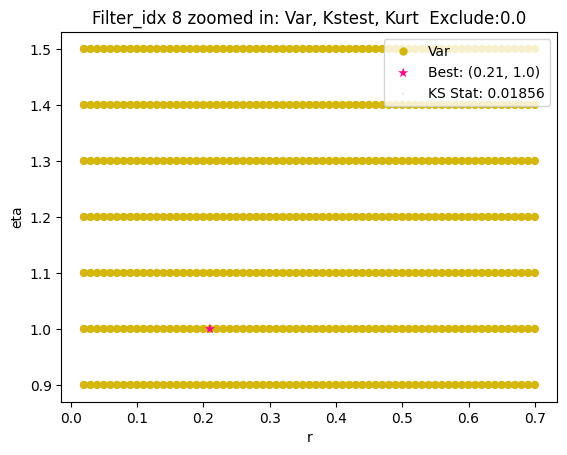

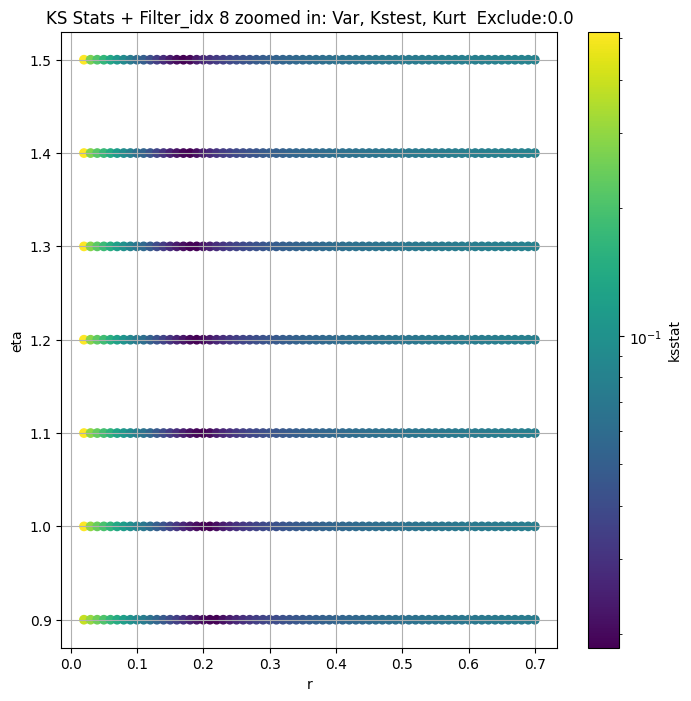

Filter_idx 9


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 9, 50.0 + 100 = 150, ksstat: 0.004532204911623136, var: 6.294914392761252


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 9, 50.0 + 75 = 125, ksstat: 0.004351510176764689, var: 6.446139961497563


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 9, 50.0 + 50 = 100, ksstat: 0.003857347635199626, var: 6.61807403858368


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 9, 50.0 + 25 = 75, ksstat: 0.0038868546225146045, var: 6.819204925664561


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 9, 50.0 + 0 = 50, ksstat: 0.003376035891925311, var: 7.065595153195351


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 9, 50.0 + -25 = 25, ksstat: 0.004010835573647564, var: 7.3982207150355315


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 9, 50.0 + -50 = 0, ksstat: 0.006015821417529654, var: 9.369960484917575
Number of samples: 100000, Without approximation : 480000000.0


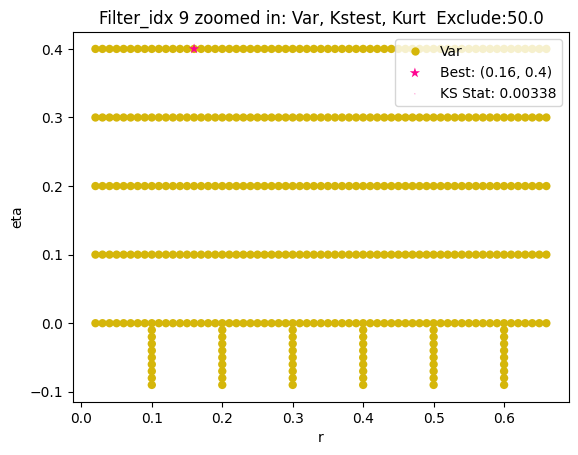

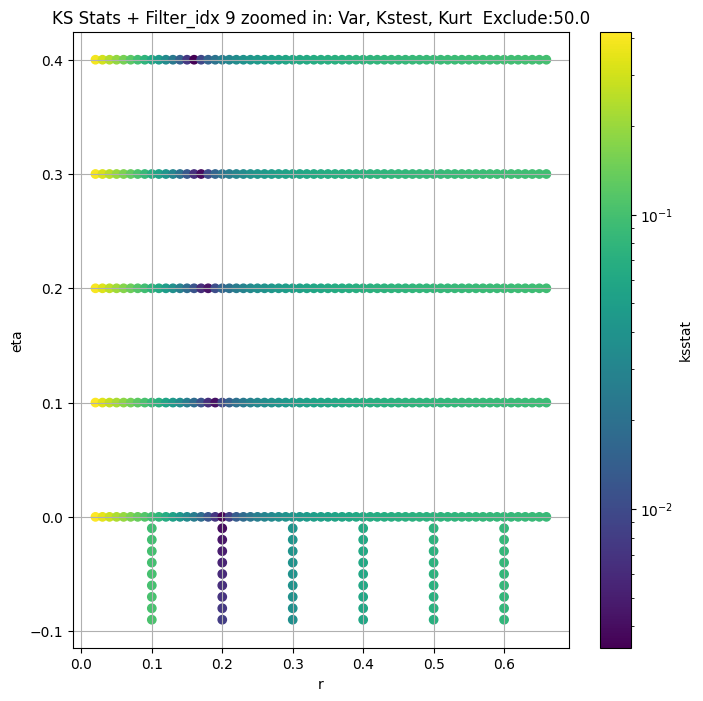

Filter_idx 10


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + 100 = 200, ksstat: 0.014428550224259817, var: 27.482504929664756


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + 75 = 175, ksstat: 0.014037163136591868, var: 28.012426023723556


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + 50 = 150, ksstat: 0.01442794899863109, var: 28.588810073521646


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + 25 = 125, ksstat: 0.013430405811952484, var: 29.22313964100619


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + 0 = 100, ksstat: 0.013523854596625307, var: 29.932773568730685


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + -25 = 75, ksstat: 0.013439682792582341, var: 30.745242018018075


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + -50 = 50, ksstat: 0.013603070847801768, var: 31.712401866716583


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + -75 = 25, ksstat: 0.013950410960996806, var: 32.95720001772072


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 100.0 + -100 = 0, ksstat: 0.013572380844802778, var: 35.86590116801386
Number of samples: 100000, Without approximation : 480000000.0


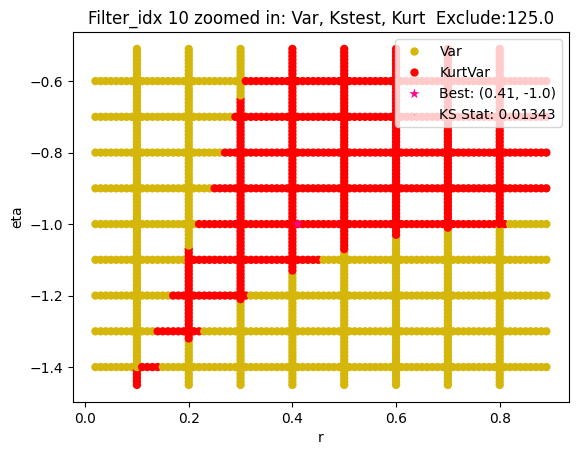

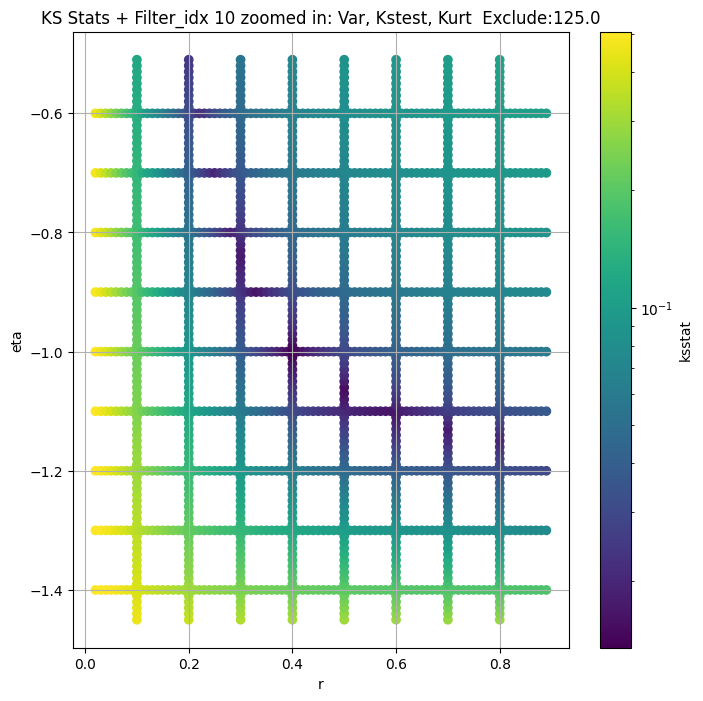

Filter_idx 11


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 11, 50.0 + 100 = 150, ksstat: 0.013472714734601321, var: 30.014481266246158


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 11, 50.0 + 75 = 125, ksstat: 0.013244938493136793, var: 30.84152397898608


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 11, 50.0 + 50 = 100, ksstat: 0.013361932539328714, var: 31.7734053744688


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 11, 50.0 + 25 = 75, ksstat: 0.013139950100257244, var: 32.84922758459165


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 11, 50.0 + 0 = 50, ksstat: 0.012156446986496094, var: 34.14246844691742


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 11, 50.0 + -25 = 25, ksstat: 0.012556477713542472, var: 35.82331713691333


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 11, 50.0 + -50 = 0, ksstat: 0.011882018126593397, var: 39.66937730091172
Number of samples: 100000, Without approximation : 480000000.0


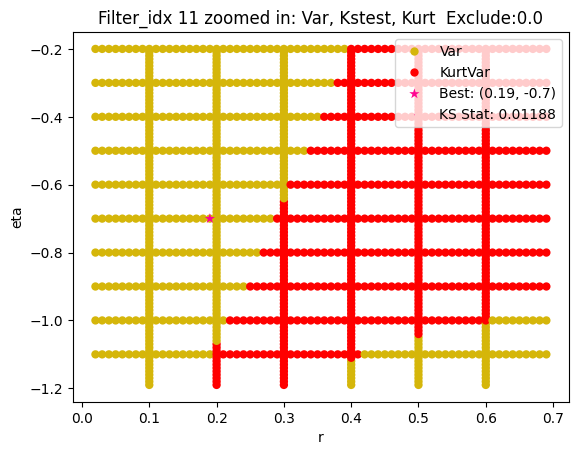

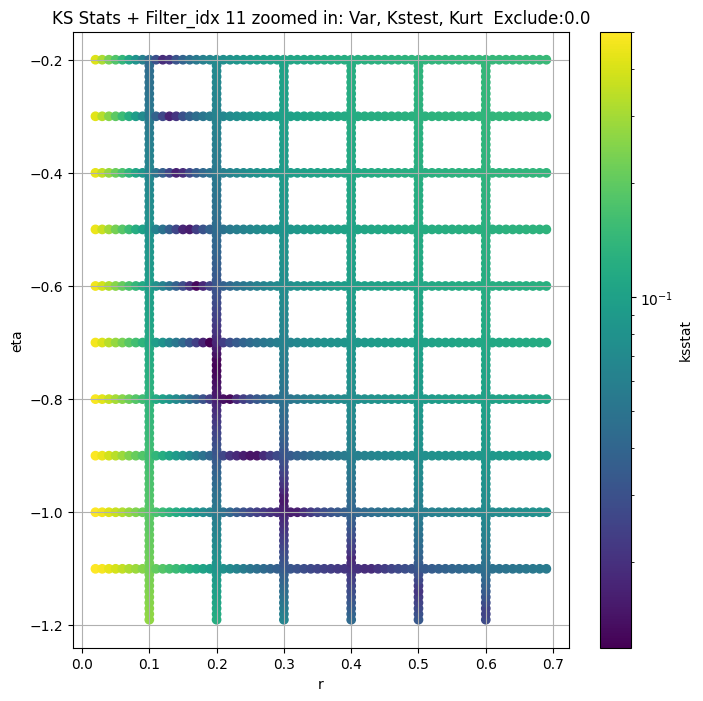

Filter_idx 12


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 0.0 + 100 = 100, ksstat: 0.008990814629009983, var: 38.261213603058636


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 0.0 + 75 = 75, ksstat: 0.008646207900329328, var: 39.45640904966855


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 0.0 + 50 = 50, ksstat: 0.008158675070400134, var: 40.90306290185188


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 0.0 + 25 = 25, ksstat: 0.008079348248950957, var: 42.81820474655668


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 0.0 + 0 = 0, ksstat: 0.00799530995664155, var: 48.07721821441986
Number of samples: 100000, Without approximation : 480000000.0


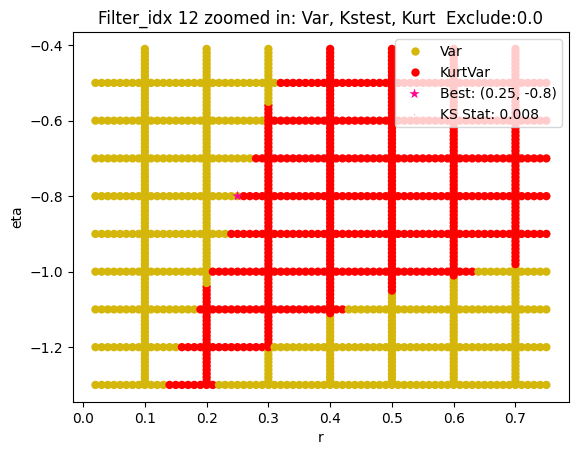

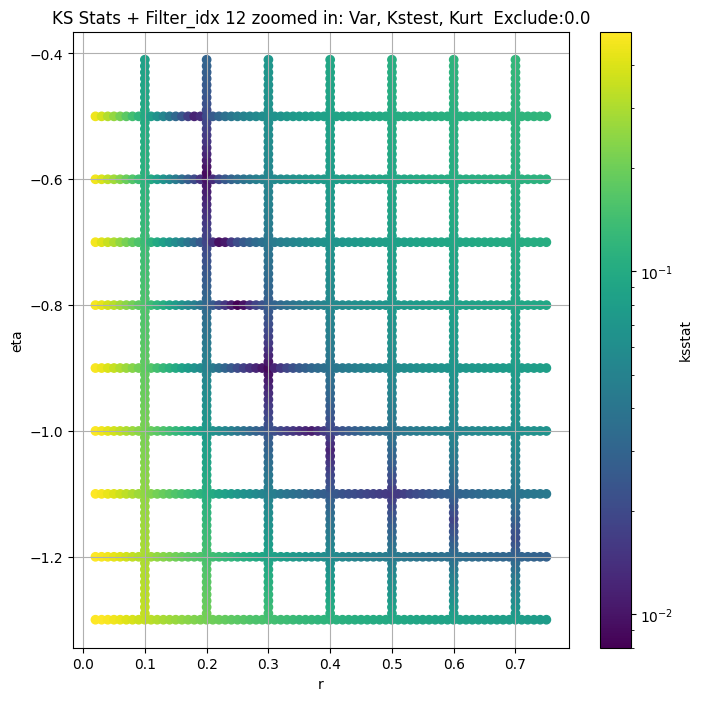

Filter_idx 13


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 13, 0.0 + 100 = 100, ksstat: 0.00863415873493989, var: 23.689188293672366


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 13, 0.0 + 75 = 75, ksstat: 0.008740375000952816, var: 24.421166545482773


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 13, 0.0 + 50 = 50, ksstat: 0.007971252041225285, var: 25.307361531485864


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 13, 0.0 + 25 = 25, ksstat: 0.00840409743249515, var: 26.47875070306615


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 13, 0.0 + 0 = 0, ksstat: 0.007632384050011612, var: 29.448136531036162
Number of samples: 100000, Without approximation : 480000000.0


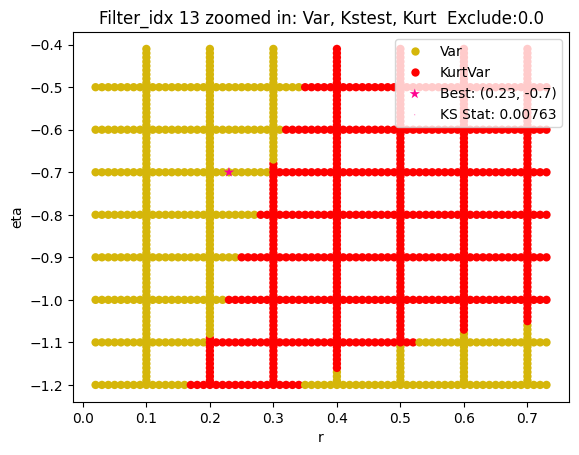

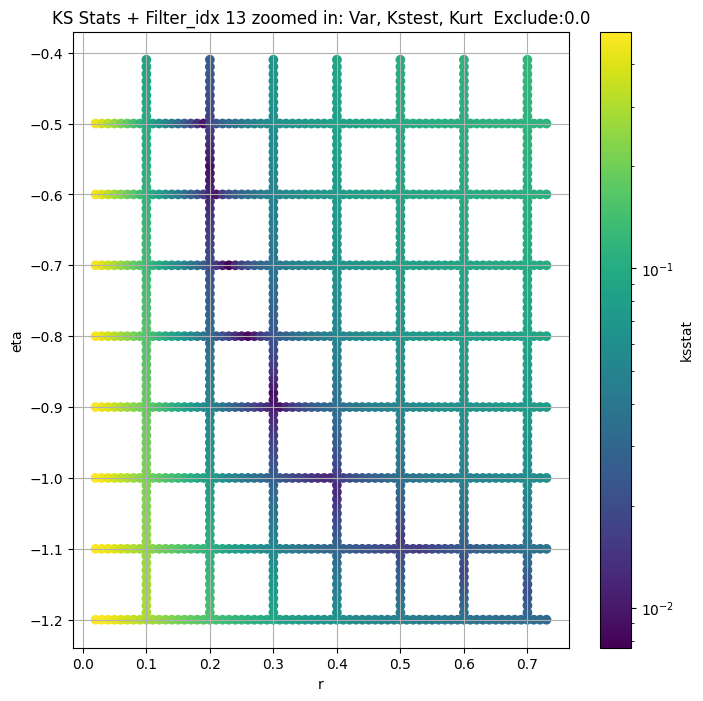

Filter_idx 14


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 14, 100.0 + 100 = 200, ksstat: 0.01702703466815414, var: 29.11581156381431


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 14, 100.0 + 75 = 175, ksstat: 0.016839819021619795, var: 29.717642724854027


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 14, 100.0 + 50 = 150, ksstat: 0.01675334949930901, var: 30.37455691984569


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 14, 100.0 + 25 = 125, ksstat: 0.01633355805964909, var: 31.10026494015818


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 14, 100.0 + 0 = 100, ksstat: 0.01651053531130625, var: 31.915292414415465


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 14, 100.0 + -25 = 75, ksstat: 0.016435933936865488, var: 32.85323749014284


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 14, 100.0 + -50 = 50, ksstat: 0.01638172230184093, var: 33.97698887388504


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 14, 100.0 + -75 = 25, ksstat: 0.016095212416077143, var: 35.43557638676717


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 14, 100.0 + -100 = 0, ksstat: 0.015784743503731047, var: 38.76253774457407
Number of samples: 100000, Without approximation : 480000000.0


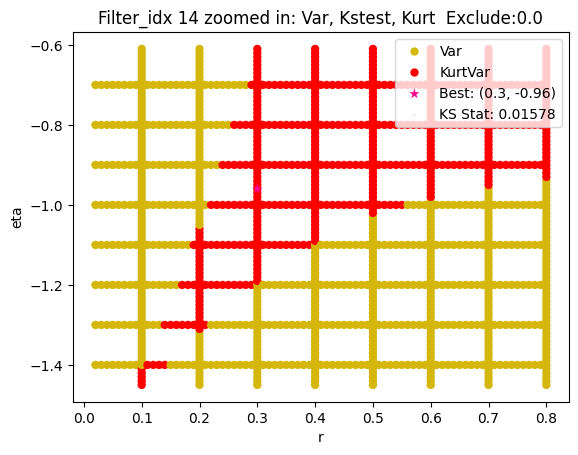

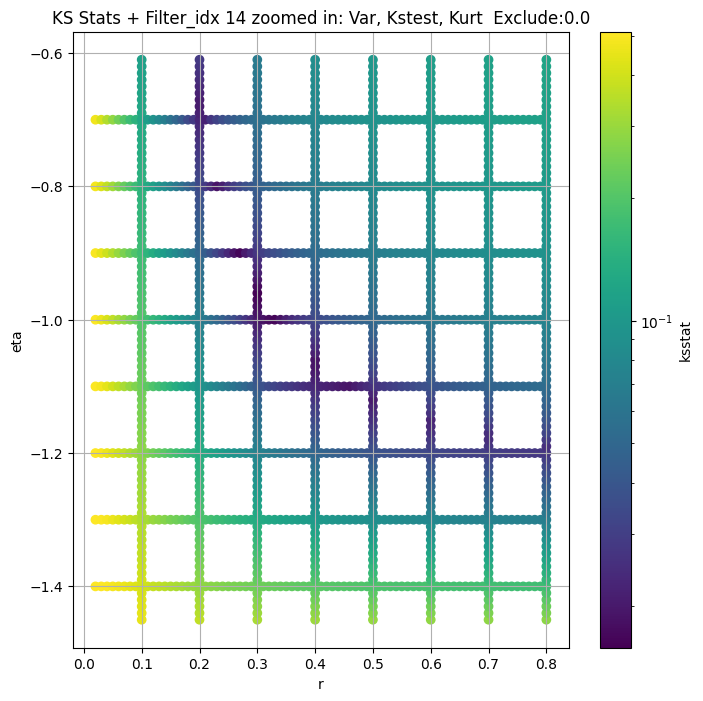

Filter_idx 15


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 100.0 + 100 = 200, ksstat: 0.028404703163556644, var: 36.54929624462547


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 100.0 + 75 = 175, ksstat: 0.02840534572013348, var: 36.976132782252066


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 100.0 + 50 = 150, ksstat: 0.02840481004723422, var: 37.43583868519754


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 100.0 + 25 = 125, ksstat: 0.028407297341649318, var: 37.93688118736458


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 100.0 + 0 = 100, ksstat: 0.028404662723780894, var: 38.492437453746305


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 100.0 + -25 = 75, ksstat: 0.02840498209762693, var: 39.12356660865425


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 100.0 + -50 = 50, ksstat: 0.028406372806497715, var: 39.866976839076806


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 100.0 + -75 = 25, ksstat: 0.028406779137220117, var: 40.803028792964355


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 100.0 + -100 = 0, ksstat: 0.028406002466494107, var: 42.579443702992165
Number of samples: 100000, Without approximation : 480000000.0


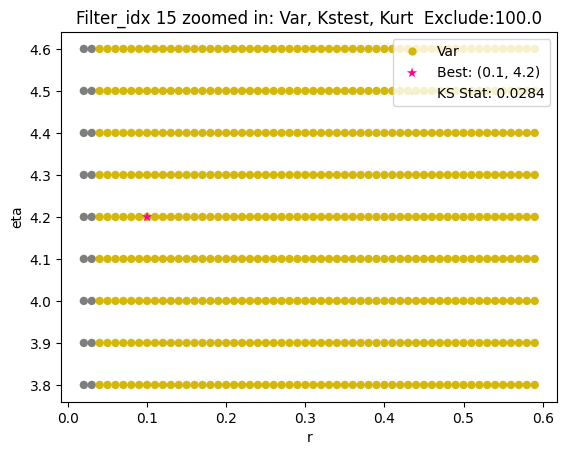

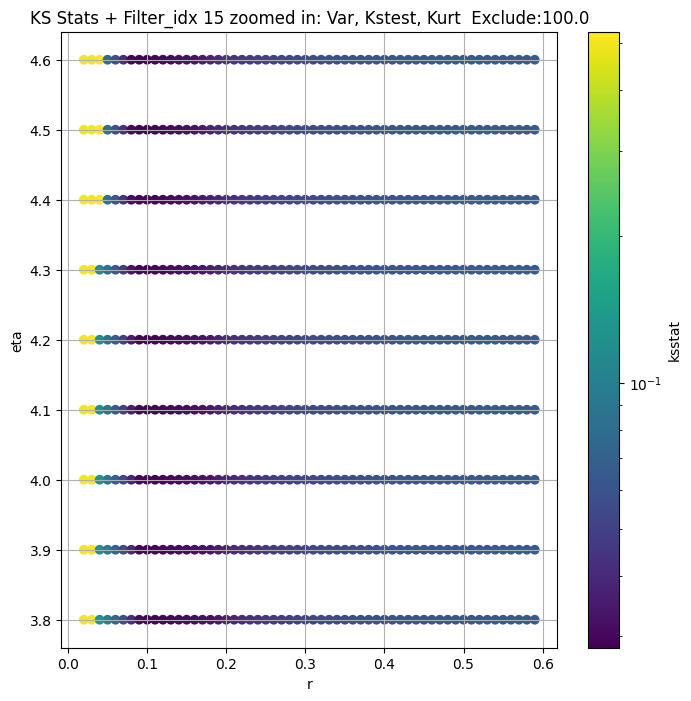

Filter_idx 16


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 16, 0.0 + 100 = 100, ksstat: 0.0063025028735664845, var: 48.94177295612733


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 16, 0.0 + 75 = 75, ksstat: 0.005639543490449553, var: 50.47214984773211


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 16, 0.0 + 50 = 50, ksstat: 0.0058065744990709045, var: 52.335528448099744


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 16, 0.0 + 25 = 25, ksstat: 0.0049362545650347145, var: 54.81950630055862


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 16, 0.0 + 0 = 0, ksstat: 0.00473677364431202, var: 61.30564812928164
Number of samples: 100000, Without approximation : 480000000.0


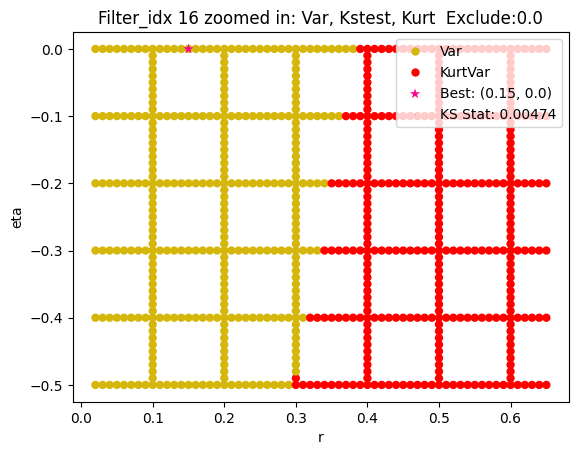

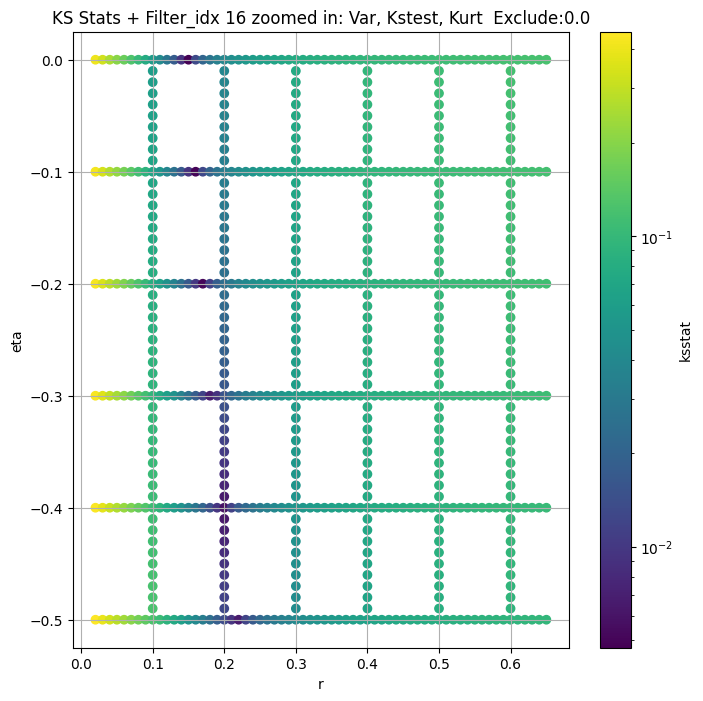

Filter_idx 17


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 17, 0.0 + 100 = 100, ksstat: 0.019160803378265423, var: 49.43280728626987


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 17, 0.0 + 75 = 75, ksstat: 0.01977066394513799, var: 50.66606218752514


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 17, 0.0 + 50 = 50, ksstat: 0.019393592982100083, var: 52.113096673887995


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 17, 0.0 + 25 = 25, ksstat: 0.019498184690415254, var: 53.935018317284374


  0%|          | 0/1163 [00:00<?, ?it/s]

Finding Minimum after computing 1163 CDFs
filter_idx 17, 0.0 + 0 = 0, ksstat: 0.018738778653381694, var: 57.50033373791151
Number of samples: 100000, Without approximation : 480000000.0


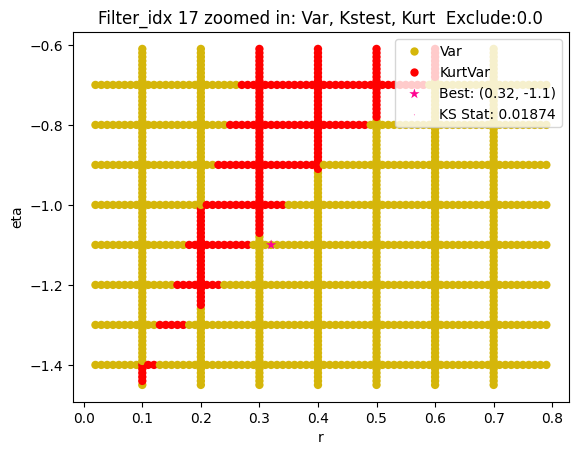

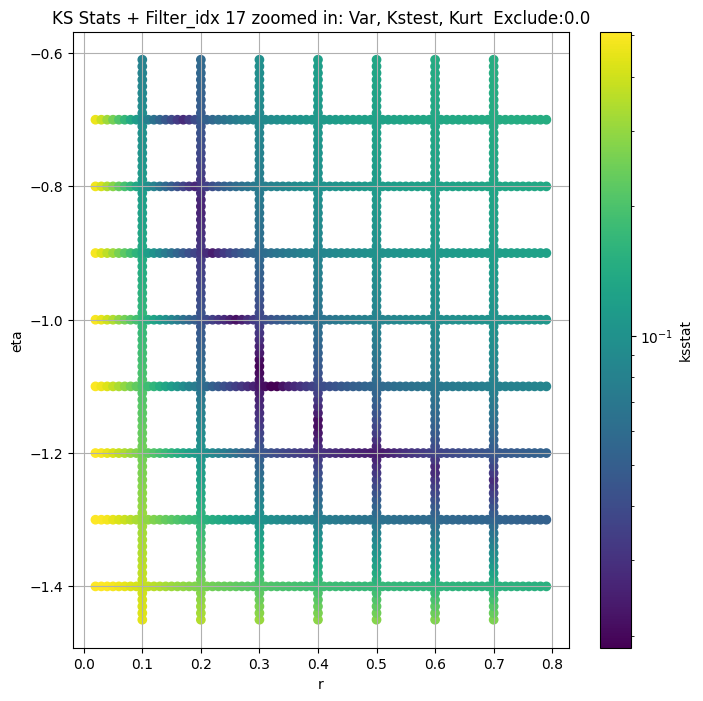

Filter_idx 18


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 18, 50.0 + 100 = 150, ksstat: 0.007244307943205686, var: 35.2590036128602


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 18, 50.0 + 75 = 125, ksstat: 0.0064023631436394, var: 36.206524079424604


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 18, 50.0 + 50 = 100, ksstat: 0.006660967286276076, var: 37.28630965226747


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 18, 50.0 + 25 = 75, ksstat: 0.006803743486315517, var: 38.55289625614453


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 18, 50.0 + 0 = 50, ksstat: 0.006905217165946609, var: 40.10951632306938


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 18, 50.0 + -25 = 25, ksstat: 0.006370170249603069, var: 42.21230152667017


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 18, 50.0 + -50 = 0, ksstat: 0.005949114884938378, var: 48.14403630452585
Number of samples: 100000, Without approximation : 480000000.0


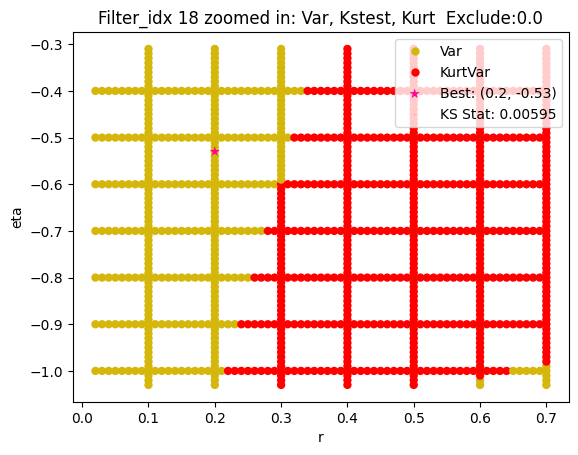

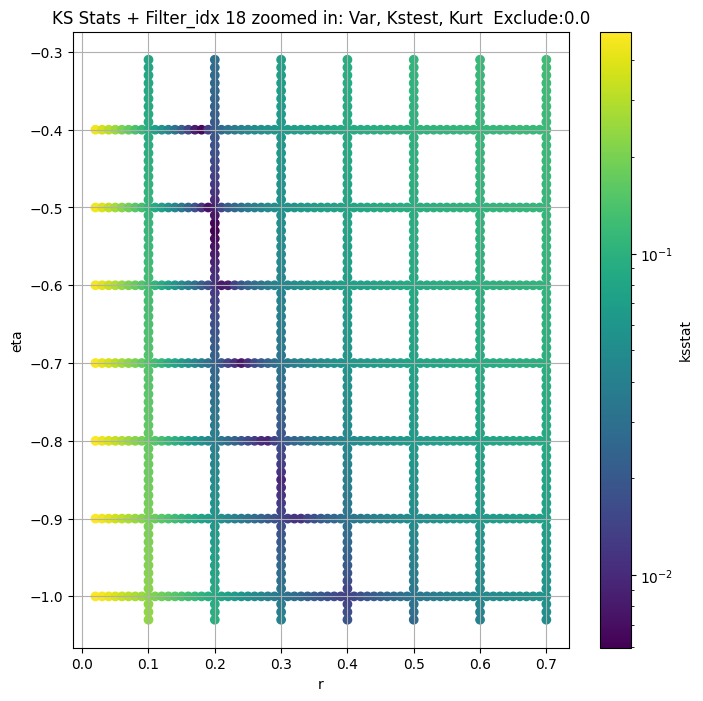

Filter_idx 20


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 20, 0.0 + 100 = 100, ksstat: 0.00927072592544076, var: 30.737480409155108


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 20, 0.0 + 75 = 75, ksstat: 0.00936824480705628, var: 31.695020671261965


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 20, 0.0 + 50 = 50, ksstat: 0.009064331945202508, var: 32.84474319152455


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 20, 0.0 + 25 = 25, ksstat: 0.009760746987674485, var: 34.34590407311462


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 20, 0.0 + 0 = 0, ksstat: 0.009302963620706817, var: 37.67740202972317
Number of samples: 100000, Without approximation : 480000000.0


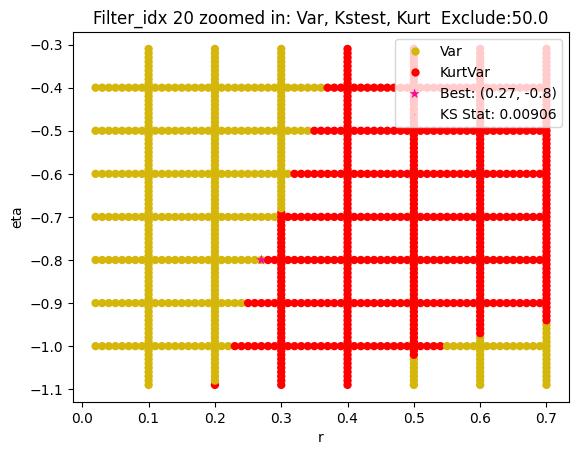

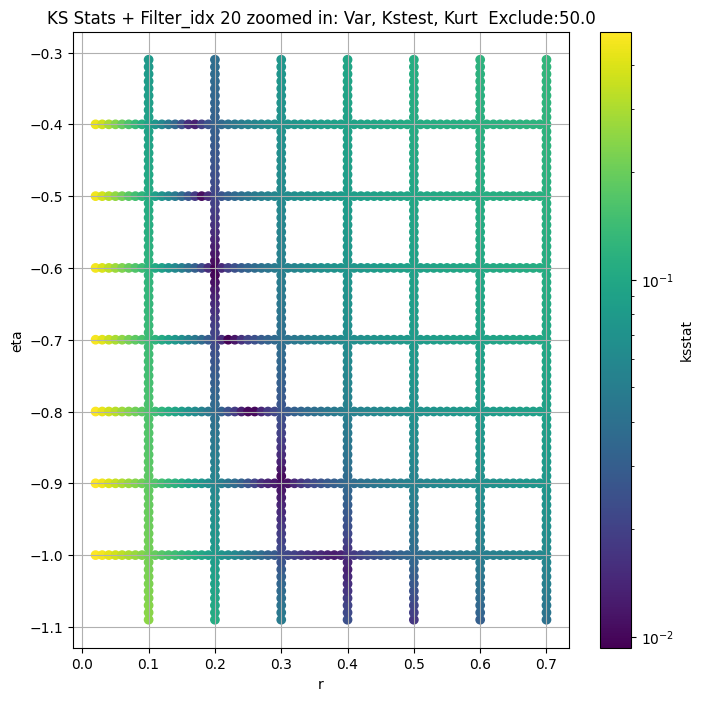

Filter_idx 22


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 100 = 100, ksstat: 0.009702445327388398, var: 15.01642901858553


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 75 = 75, ksstat: 0.009598212830284558, var: 15.422716226525694


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 50 = 50, ksstat: 0.009586304613005803, var: 15.90949039116975


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 25 = 25, ksstat: 0.008608725243858695, var: 16.54612262319564


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 0 = 0, ksstat: 0.008707308900688382, var: 18.166951988151826
Number of samples: 100000, Without approximation : 480000000.0


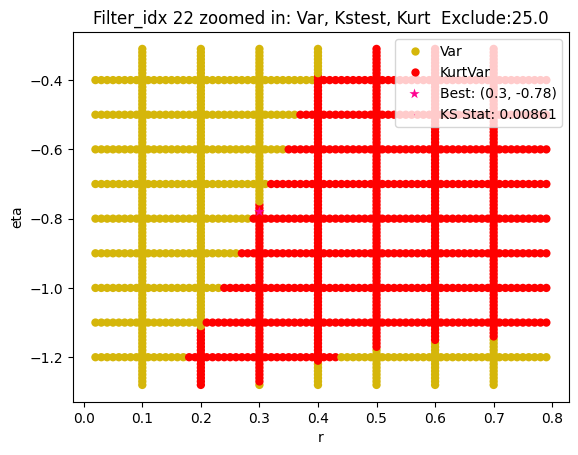

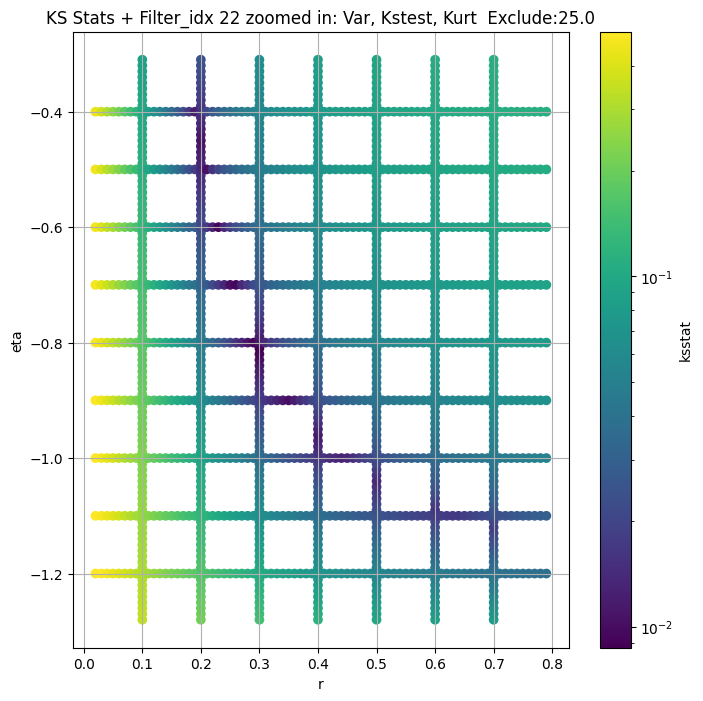

Filter_idx 23


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 23, 50.0 + 100 = 150, ksstat: 0.011827746534191164, var: 25.582397284185625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 23, 50.0 + 75 = 125, ksstat: 0.011641671560080002, var: 26.114772249107933


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 23, 50.0 + 50 = 100, ksstat: 0.011681691079263423, var: 26.707079172249603


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 23, 50.0 + 25 = 75, ksstat: 0.011432502538237133, var: 27.38161362915426


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 23, 50.0 + 0 = 50, ksstat: 0.011157272841070043, var: 28.179399146823975


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 23, 50.0 + -25 = 25, ksstat: 0.010757576214721676, var: 29.19923866845357


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 23, 50.0 + -50 = 0, ksstat: 0.010824540937751759, var: 31.440153510876385
Number of samples: 100000, Without approximation : 480000000.0


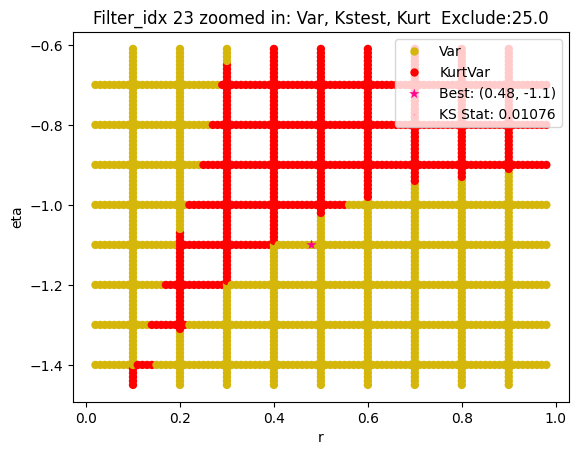

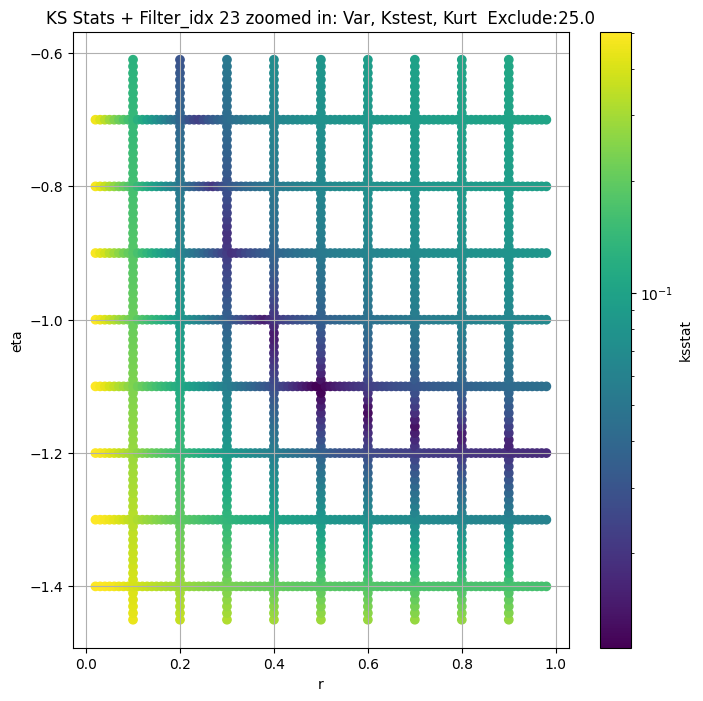

Filter_idx 24


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 100 = 100, ksstat: 0.012011218357714015, var: 16.399008747861757


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 75 = 75, ksstat: 0.011165061575602375, var: 16.91603300378841


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 50 = 50, ksstat: 0.011455151567067334, var: 17.539528359916847


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 25 = 25, ksstat: 0.009743979248947321, var: 18.360107426322713


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 0.0 + 0 = 0, ksstat: 0.00785429087253231, var: 21.173402754686595
Number of samples: 100000, Without approximation : 480000000.0


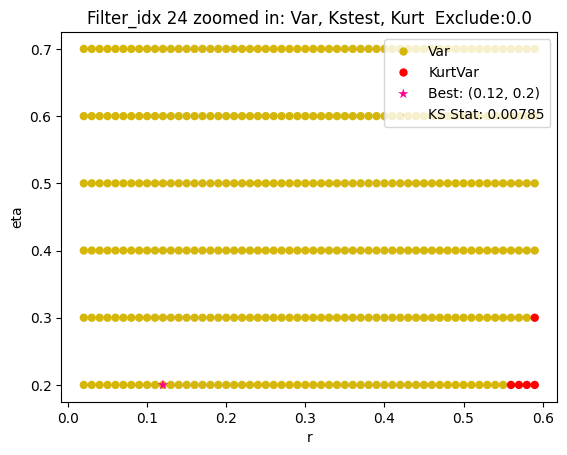

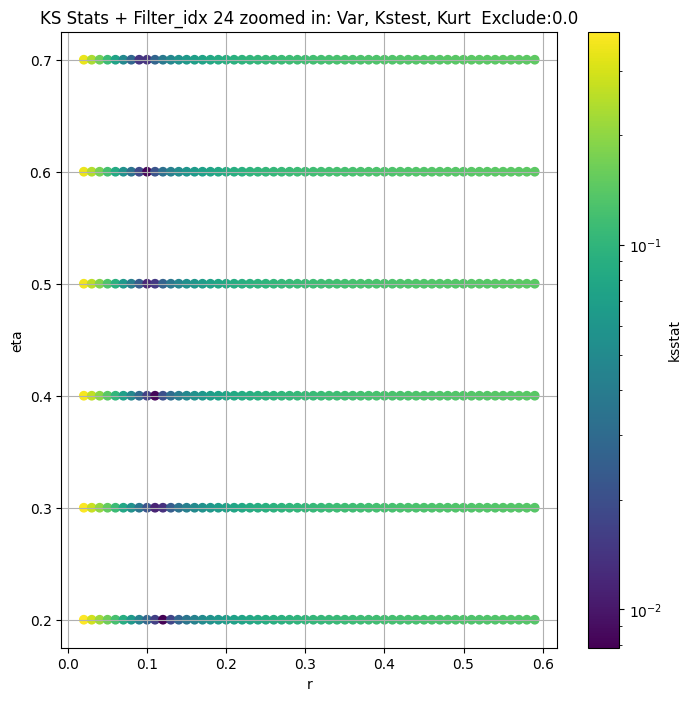

Filter_idx 25


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 25, 50.0 + 100 = 150, ksstat: 0.004758761175357673, var: 6.795638542042712


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 25, 50.0 + 75 = 125, ksstat: 0.004568758354605684, var: 6.947346764174778


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 25, 50.0 + 50 = 100, ksstat: 0.004373140721108948, var: 7.118591665106626


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 25, 50.0 + 25 = 75, ksstat: 0.004613530365514484, var: 7.317074754290072


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 25, 50.0 + 0 = 50, ksstat: 0.0037437894404395156, var: 7.557163681470767


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 25, 50.0 + -25 = 25, ksstat: 0.004831484839948663, var: 7.875047277747027


  0%|          | 0/873 [00:00<?, ?it/s]

Finding Minimum after computing 873 CDFs
filter_idx 25, 50.0 + -50 = 0, ksstat: 0.005035451273273095, var: 9.03464644015979
Number of samples: 100000, Without approximation : 480000000.0


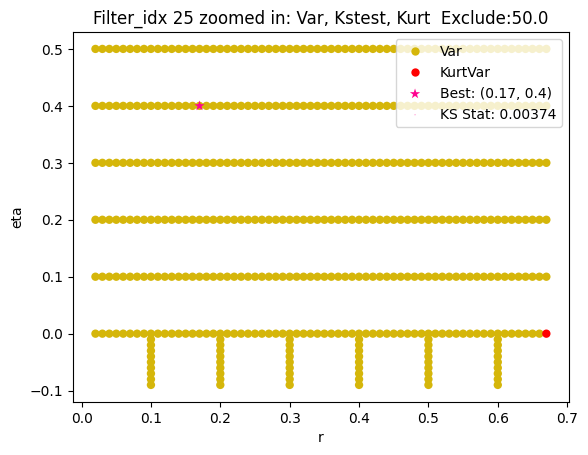

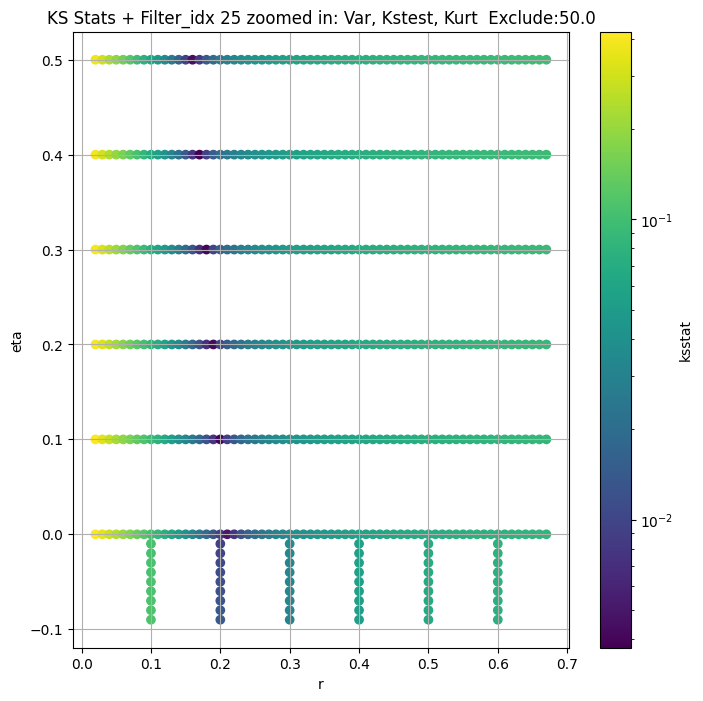

Filter_idx 26


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + 100 = 300, ksstat: 0.023581540139543666, var: 31.710432708433494


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + 75 = 275, ksstat: 0.02355717449199135, var: 32.1871527363375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + 50 = 250, ksstat: 0.02361512471930216, var: 32.691394013205134


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + 25 = 225, ksstat: 0.02358537101643482, var: 33.2271718945533


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + 0 = 200, ksstat: 0.02358767052395183, var: 33.799637316055396


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + -25 = 175, ksstat: 0.023461041669182392, var: 34.41532285101408


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + -50 = 150, ksstat: 0.023578926275926226, var: 35.083274985691304


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + -75 = 125, ksstat: 0.02355313978365081, var: 35.816469747272905


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + -100 = 100, ksstat: 0.023507234792718545, var: 36.63374236191197
Number of samples: 100000, Without approximation : 480000000.0


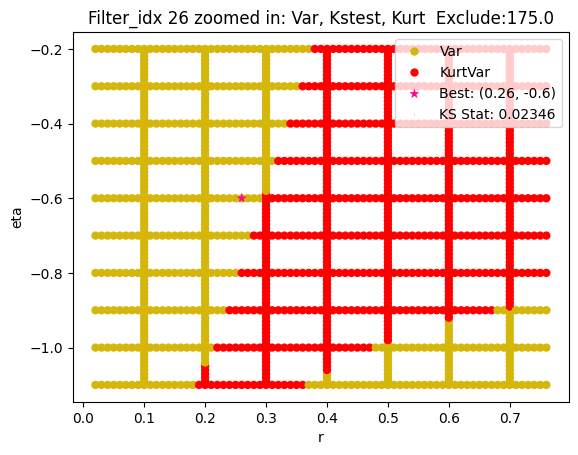

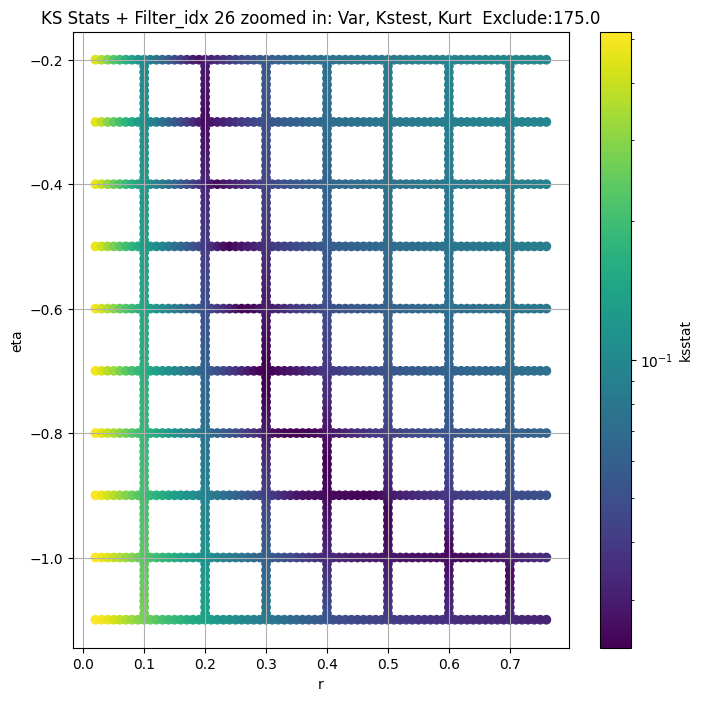

Filter_idx 27


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + 100 = 200, ksstat: 0.004776410418627308, var: 6.203818190126612


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + 75 = 175, ksstat: 0.0046704710561575324, var: 6.335472059338285


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + 50 = 150, ksstat: 0.004397658339633362, var: 6.480242767695458


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + 25 = 125, ksstat: 0.004040123143686729, var: 6.641624403702492


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + 0 = 100, ksstat: 0.0038681140952685836, var: 6.82486008027471


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + -25 = 75, ksstat: 0.003646603957739303, var: 7.038790415381461


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + -50 = 50, ksstat: 0.003886664332365064, var: 7.3001651291630845


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + -75 = 25, ksstat: 0.0034657764105616162, var: 7.651564142593187


  0%|          | 0/936 [00:00<?, ?it/s]

Finding Minimum after computing 936 CDFs
filter_idx 27, 100.0 + -100 = 0, ksstat: 0.0059968536751940915, var: 10.058828841830875
Number of samples: 100000, Without approximation : 480000000.0


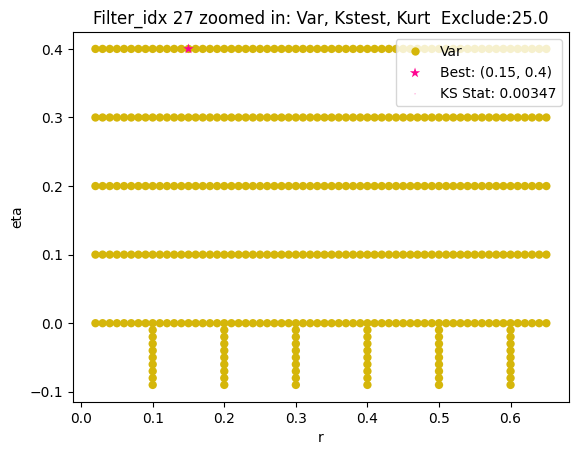

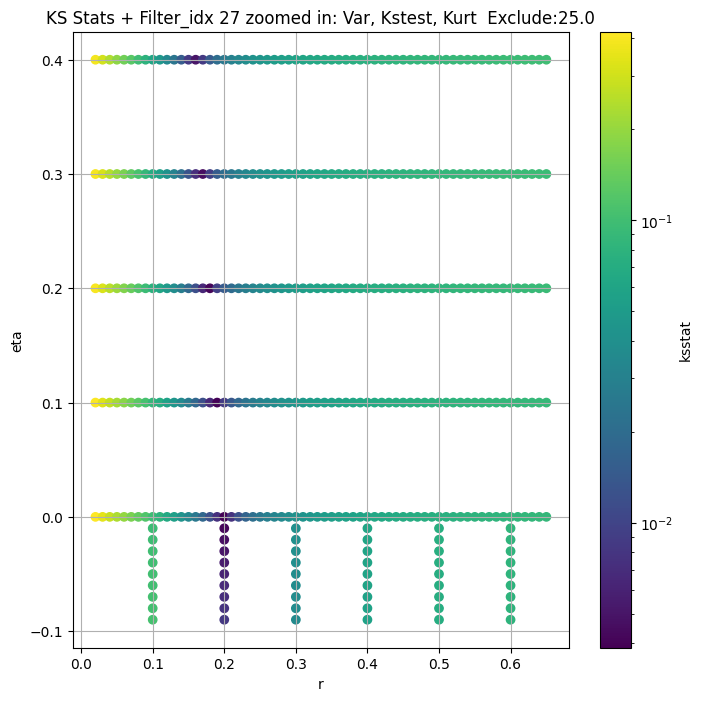

Filter_idx 28


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + 100 = 200, ksstat: 0.009472206718521559, var: 21.255674182735305


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + 75 = 175, ksstat: 0.009581381548183776, var: 21.688803388717357


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + 50 = 150, ksstat: 0.009126311462638759, var: 22.161117400450976


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + 25 = 125, ksstat: 0.009517169302053152, var: 22.68243010286397


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + 0 = 100, ksstat: 0.009381555167221833, var: 23.267721173334316


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + -25 = 75, ksstat: 0.00879917042139855, var: 23.94162349177155


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + -50 = 50, ksstat: 0.008500664707634775, var: 24.750712732720004


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + -75 = 25, ksstat: 0.008374197265156758, var: 25.808723188437206


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 28, 100.0 + -100 = 0, ksstat: 0.00819281224003987, var: 29.010986266093816
Number of samples: 100000, Without approximation : 480000000.0


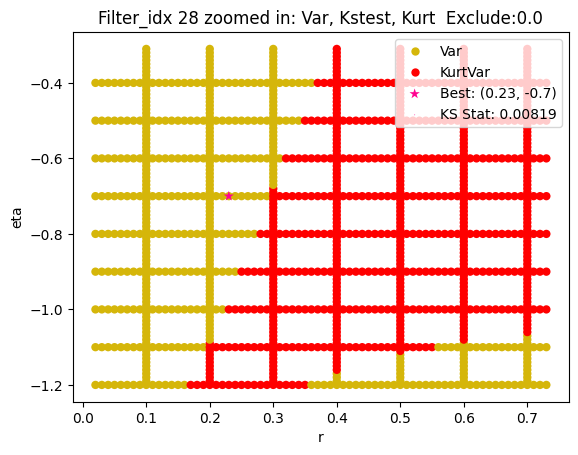

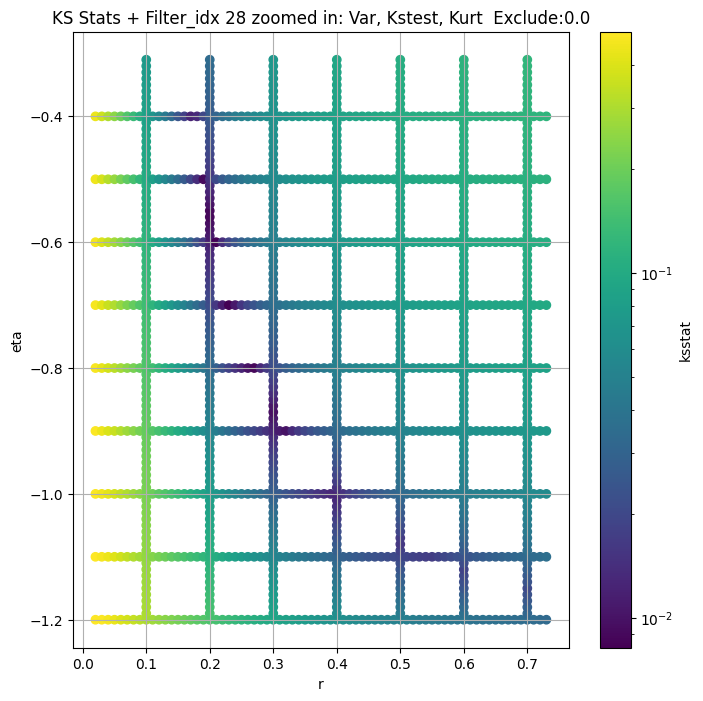

Filter_idx 29


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 29, 200.0 + 100 = 300, ksstat: 0.03887915805816594, var: 14.53606646554471


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 29, 200.0 + 75 = 275, ksstat: 0.03887974070409356, var: 14.792696375800144


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 29, 200.0 + 50 = 250, ksstat: 0.03887992809188895, var: 15.064443624566684


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 29, 200.0 + 25 = 225, ksstat: 0.038879224237403254, var: 15.353608529717572


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 29, 200.0 + 0 = 200, ksstat: 0.03887976807116267, var: 15.662892572161223


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 29, 200.0 + -25 = 175, ksstat: 0.03888017834622365, var: 15.996027881688363


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 29, 200.0 + -50 = 150, ksstat: 0.03887999421151006, var: 16.35812120124404


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 29, 200.0 + -75 = 125, ksstat: 0.03887955623486172, var: 16.75610501102211


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 29, 200.0 + -100 = 100, ksstat: 0.038879301787218434, var: 17.20045567790839
Number of samples: 100000, Without approximation : 480000000.0


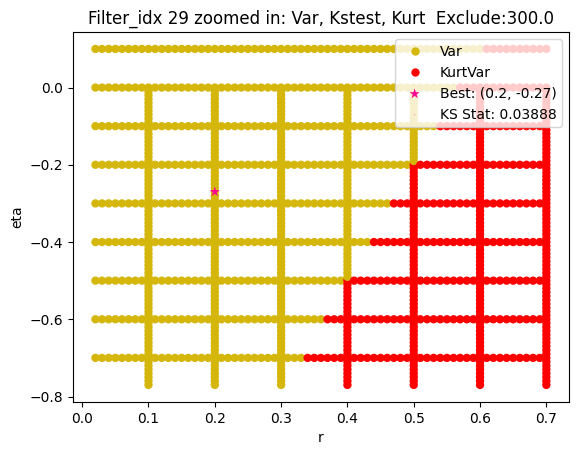

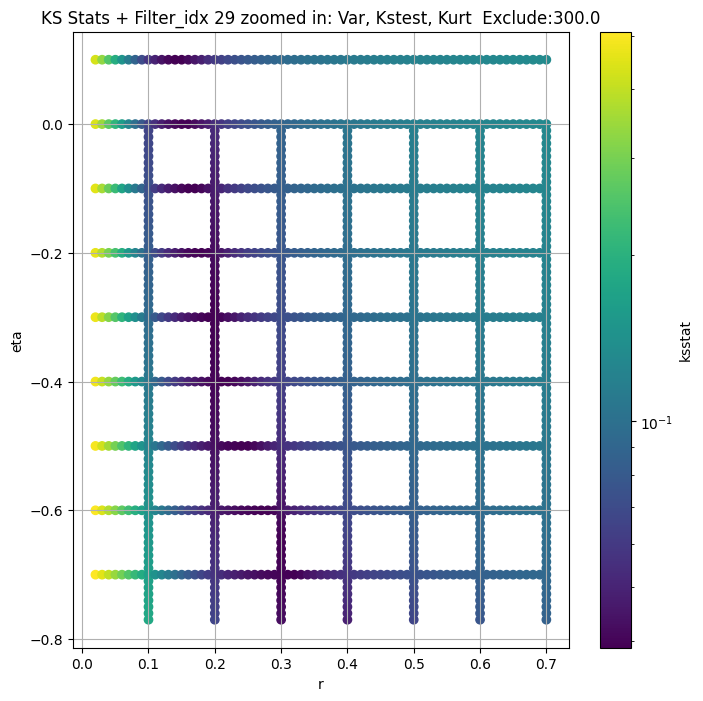

Filter_idx 30


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 50.0 + 100 = 150, ksstat: 0.008812547720580599, var: 14.260209870640171


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 50.0 + 75 = 125, ksstat: 0.008329114940213933, var: 14.646316778489274


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 50.0 + 50 = 100, ksstat: 0.0071611535277550376, var: 15.082302174213018


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 50.0 + 25 = 75, ksstat: 0.007433525801738727, var: 15.587406768073661


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 50.0 + 0 = 50, ksstat: 0.007095288006096212, var: 16.19721540175718


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 50.0 + -25 = 25, ksstat: 0.00649097168926116, var: 17.000346134111545


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 50.0 + -50 = 0, ksstat: 0.007244622236642628, var: 19.45063610611612
Number of samples: 100000, Without approximation : 480000000.0


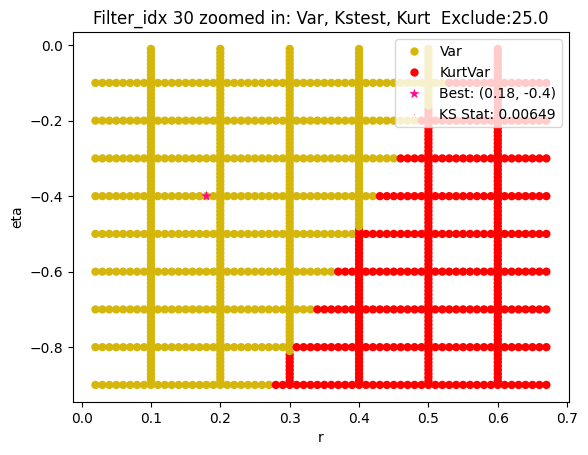

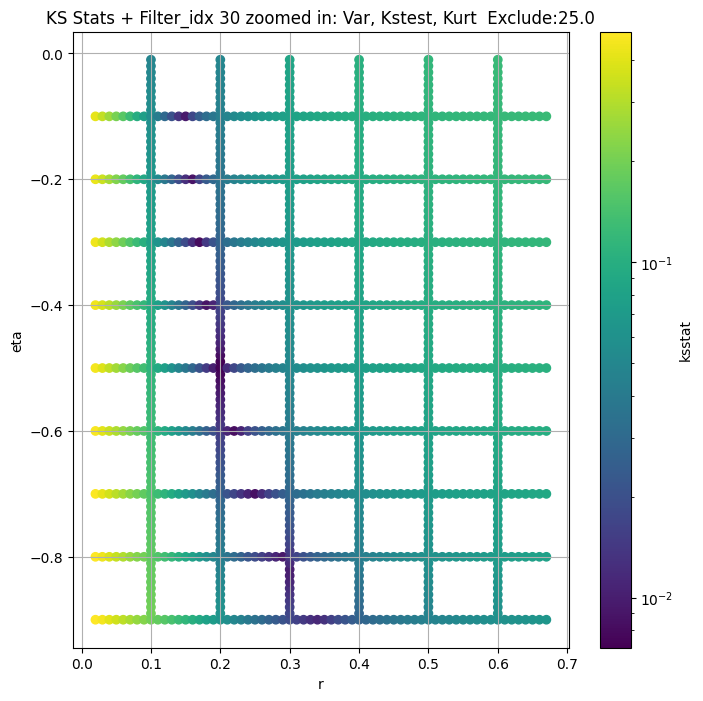

Filter_idx 31


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 100 = 150, ksstat: 0.06226542977017313, var: 37.73777852998982


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 75 = 125, ksstat: 0.06226557793000803, var: 38.483814102224095


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 50 = 100, ksstat: 0.06226511703571547, var: 39.31494907157802


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 25 = 75, ksstat: 0.06226963234256222, var: 40.26229205155227


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + 0 = 50, ksstat: 0.062265697932857744, var: 41.38213621796571


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + -25 = 25, ksstat: 0.06226800983116043, var: 42.803791486261886


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 50.0 + -50 = 0, ksstat: 0.06226525468946742, var: 45.65640394191919
Number of samples: 100000, Without approximation : 480000000.0


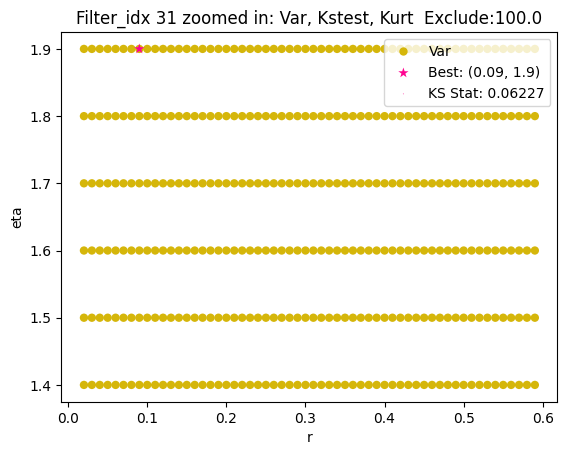

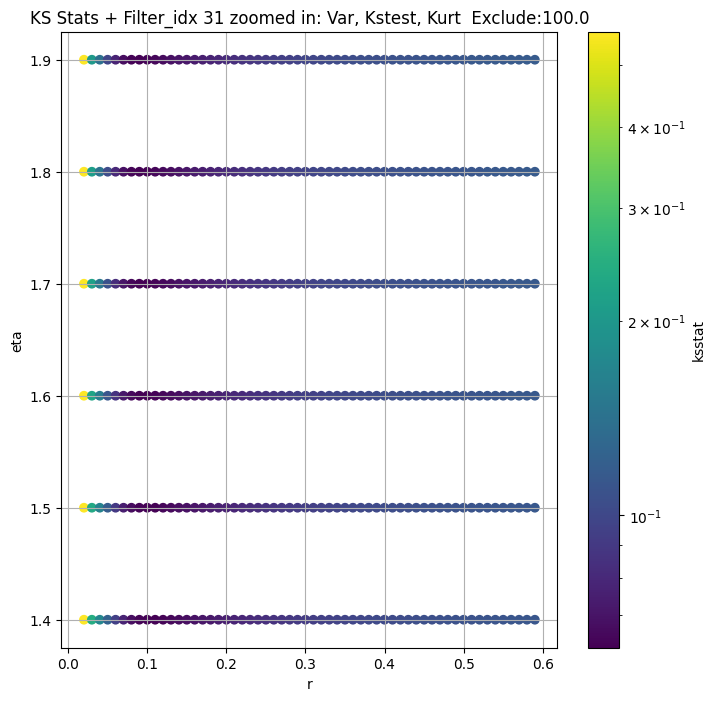

Filter_idx 32


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 100 = 300, ksstat: 0.0164669712492157, var: 21.252849355012177


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 75 = 275, ksstat: 0.016309231393078716, var: 21.602633647024515


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 50 = 250, ksstat: 0.0161484467026326, var: 21.97330618130458


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 25 = 225, ksstat: 0.01599083593685524, var: 22.36790515480068


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 0 = 200, ksstat: 0.016662345798425127, var: 22.790395266332215


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + -25 = 175, ksstat: 0.016198490870815374, var: 23.245810100842835


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + -50 = 150, ksstat: 0.016235259354199116, var: 23.741108399220156


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + -75 = 125, ksstat: 0.014899892162883677, var: 24.286107592174705


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + -100 = 100, ksstat: 0.015620463423056008, var: 24.895474357426313
Number of samples: 100000, Without approximation : 480000000.0


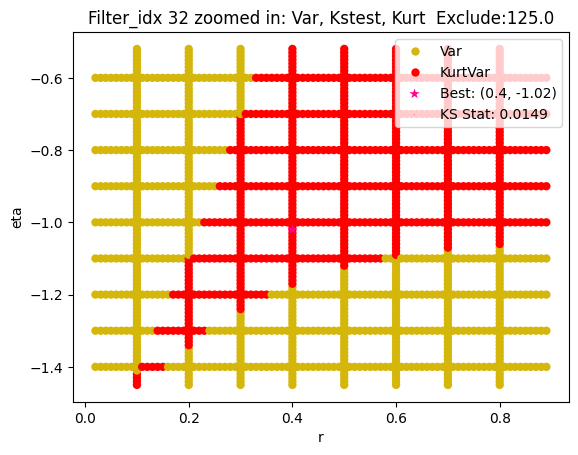

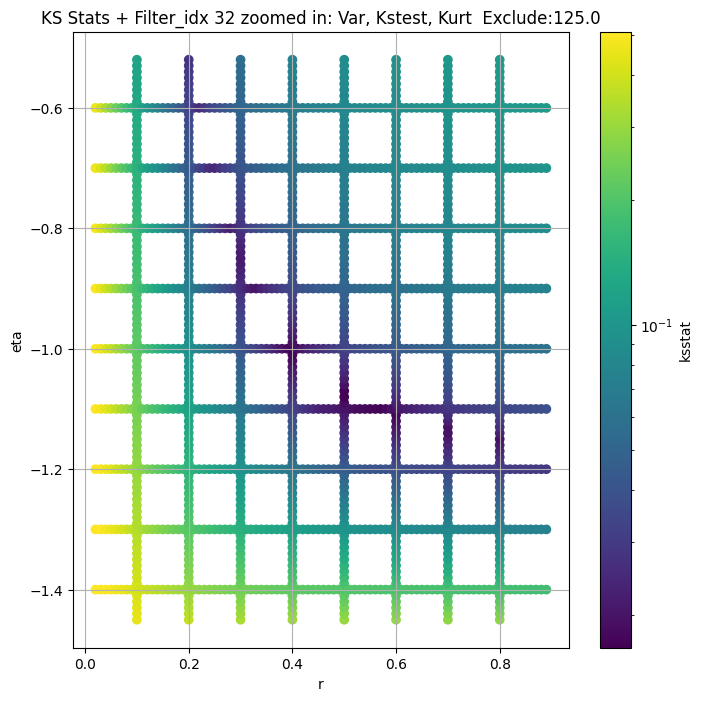

Filter_idx 33


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 50.0 + 100 = 150, ksstat: 0.006510378825222596, var: 12.138728586334707


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 50.0 + 75 = 125, ksstat: 0.006142487339498404, var: 12.459575021705097


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 50.0 + 50 = 100, ksstat: 0.005208466325805072, var: 12.82355068590075


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 50.0 + 25 = 75, ksstat: 0.0044825265557564276, var: 13.247681263268438


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 50.0 + 0 = 50, ksstat: 0.0038555331965509643, var: 13.764925895491668


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 50.0 + -25 = 25, ksstat: 0.0037593669629546467, var: 14.45701966063472


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 50.0 + -50 = 0, ksstat: 0.0044527809553199516, var: 16.6375472743384
Number of samples: 100000, Without approximation : 480000000.0


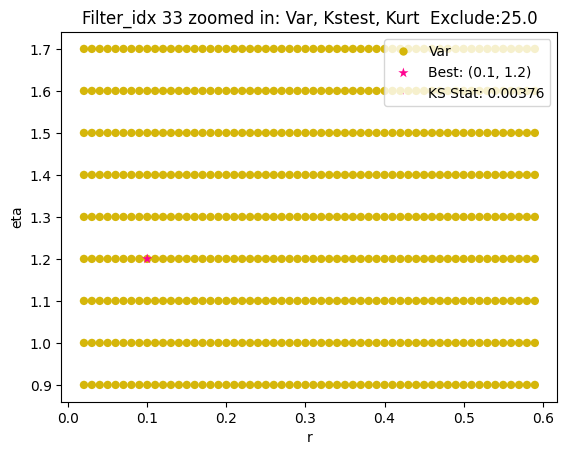

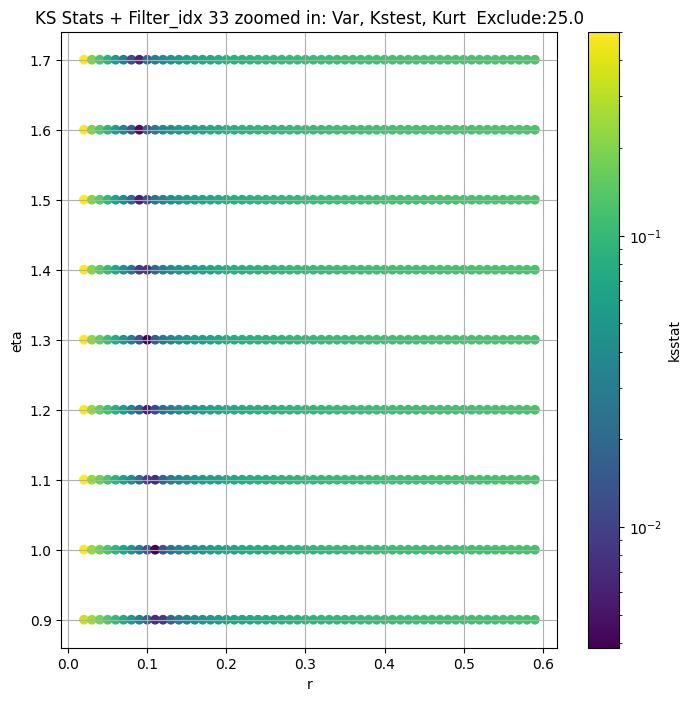

Filter_idx 34


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 100 = 100, ksstat: 0.008336526662501731, var: 20.706006638083515


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 75 = 75, ksstat: 0.007891246009428587, var: 21.322657051609198


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 50 = 50, ksstat: 0.007051590620108961, var: 22.064097360577453


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 25 = 25, ksstat: 0.0077435471103991516, var: 23.038074052413947


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 34, 0.0 + 0 = 0, ksstat: 0.006422841687957648, var: 25.921622107634946
Number of samples: 100000, Without approximation : 480000000.0


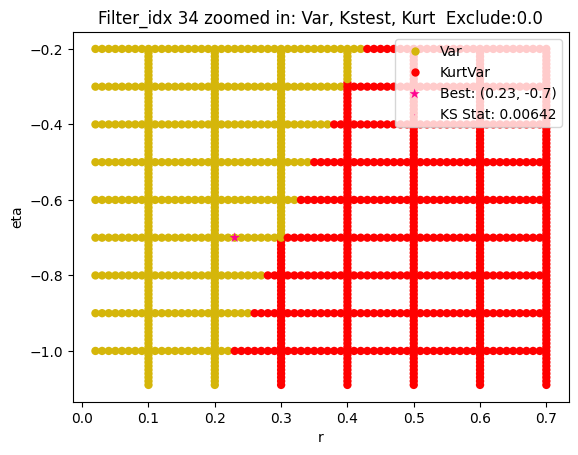

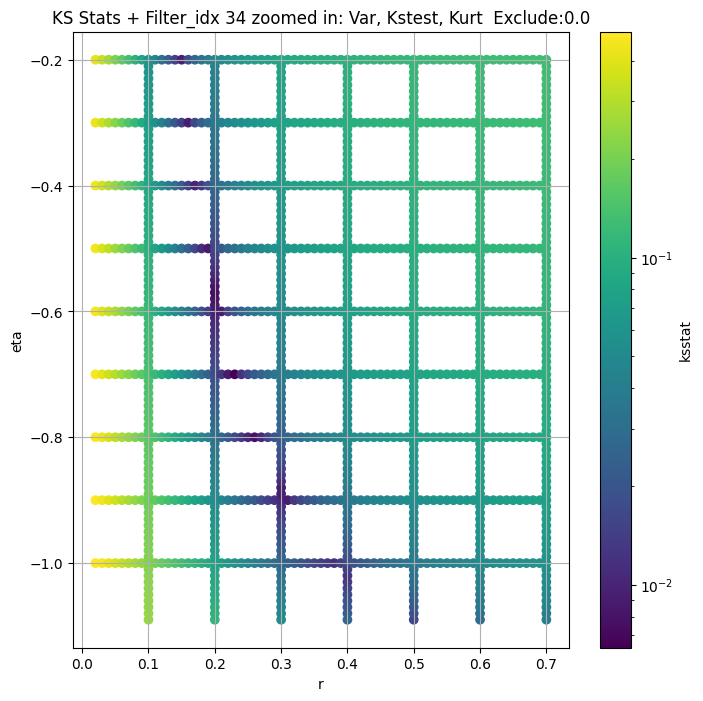

Filter_idx 38


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 100.0 + 100 = 200, ksstat: 0.021618994015909943, var: 54.37224376095436


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 100.0 + 75 = 175, ksstat: 0.021065273409004104, var: 55.50152985518378


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 100.0 + 50 = 150, ksstat: 0.02104963552422695, var: 56.729668294547835


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 100.0 + 25 = 125, ksstat: 0.021244145522803515, var: 58.08118328074814


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 100.0 + 0 = 100, ksstat: 0.021185982509328516, var: 59.59207441516093


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 100.0 + -25 = 75, ksstat: 0.021112869106292398, var: 61.32185927871231


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 100.0 + -50 = 50, ksstat: 0.021292945801491714, var: 63.38143211732465


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 100.0 + -75 = 25, ksstat: 0.021224242662259474, var: 66.03346783052443


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 100.0 + -100 = 0, ksstat: 0.02137990967393294, var: 71.52992193914459
Number of samples: 100000, Without approximation : 480000000.0


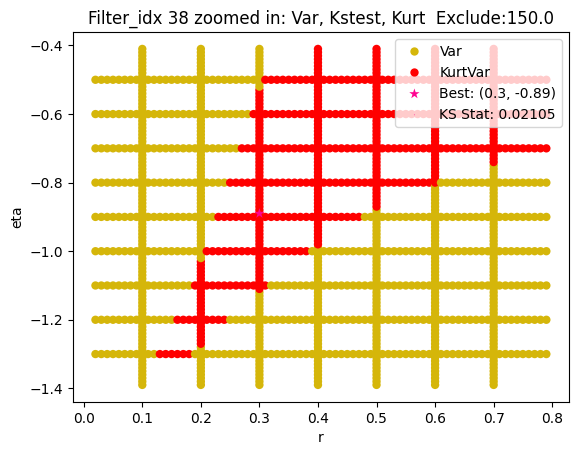

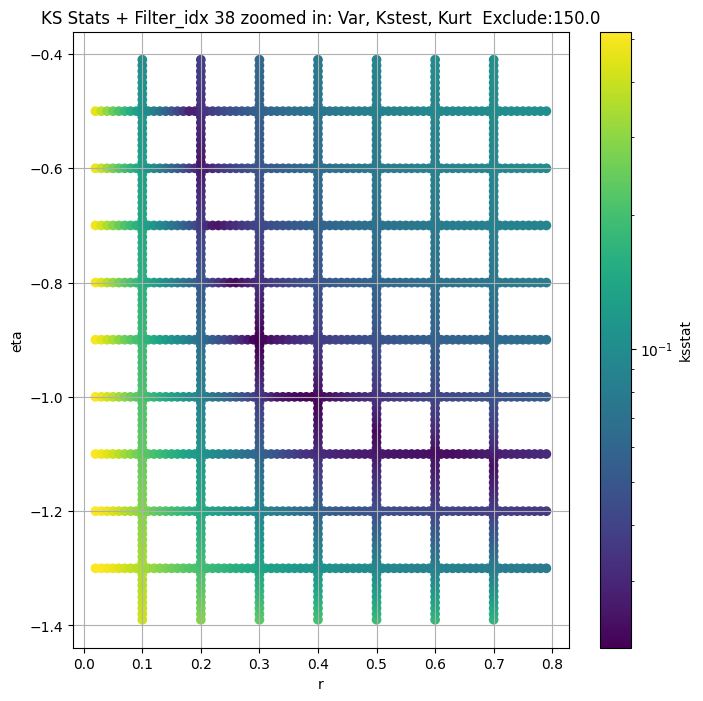

Filter_idx 39


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 39, 100.0 + 100 = 200, ksstat: 0.06648375400172168, var: 41.20455034452599


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 39, 100.0 + 75 = 175, ksstat: 0.06648372115662976, var: 41.931859846462615


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 39, 100.0 + 50 = 150, ksstat: 0.06648376287308583, var: 42.721876928616446


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 39, 100.0 + 25 = 125, ksstat: 0.06648371516520596, var: 43.58959731859296


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 39, 100.0 + 0 = 100, ksstat: 0.06648374958929809, var: 44.55758957698359


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 39, 100.0 + -25 = 75, ksstat: 0.06648382953443577, var: 45.66193806248371


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 39, 100.0 + -50 = 50, ksstat: 0.06648378792376036, var: 46.968654285795644


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 39, 100.0 + -75 = 25, ksstat: 0.06648378700673496, var: 48.634224009355854


  0%|          | 0/1440 [00:00<?, ?it/s]

Finding Minimum after computing 1440 CDFs
filter_idx 39, 100.0 + -100 = 0, ksstat: 0.0664837469122741, var: 52.075115655613104
Number of samples: 100000, Without approximation : 480000000.0


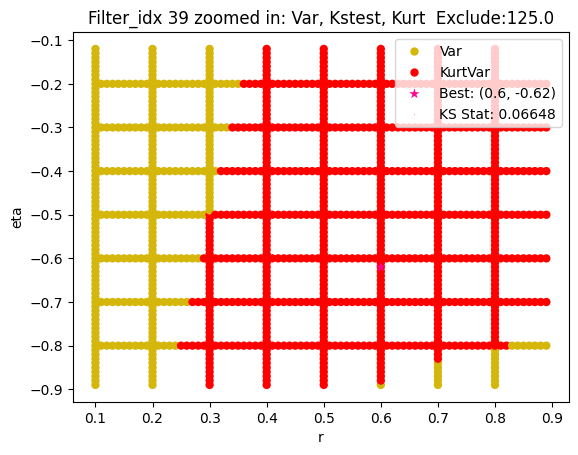

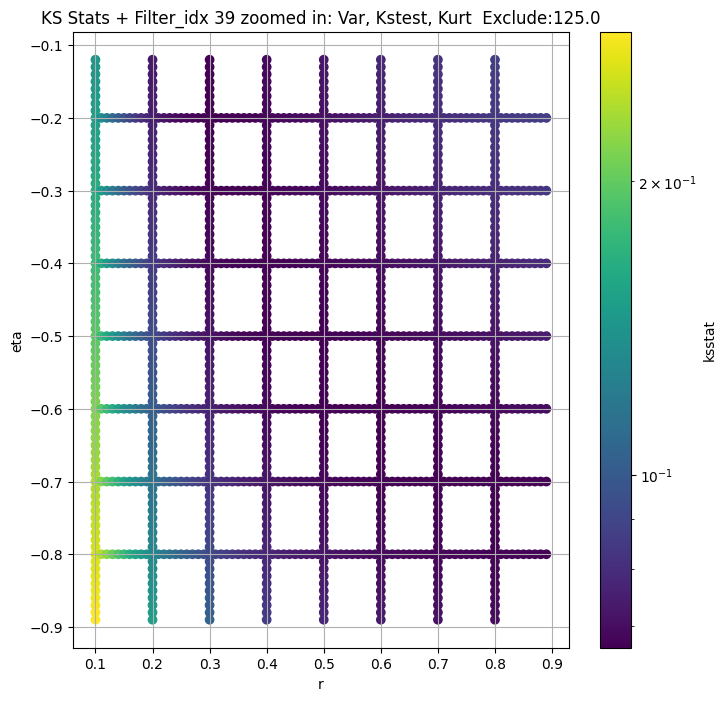

Filter_idx 40


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 100 = 300, ksstat: 0.015109287132848148, var: 34.88577892289742


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 75 = 275, ksstat: 0.015092589799383271, var: 35.21524109772672


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 50 = 250, ksstat: 0.015080415516714574, var: 35.560949147930685


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 25 = 225, ksstat: 0.015106674148918642, var: 35.92491804779318


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 0 = 200, ksstat: 0.015134287664307355, var: 36.31031033953092


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -25 = 175, ksstat: 0.015161065471696267, var: 36.72145941603383


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -50 = 150, ksstat: 0.015186391594929127, var: 37.163433292393734


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -75 = 125, ksstat: 0.01520953640341488, var: 37.64296476020254


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -100 = 100, ksstat: 0.015157687184196578, var: 38.17380375148875
Number of samples: 100000, Without approximation : 480000000.0


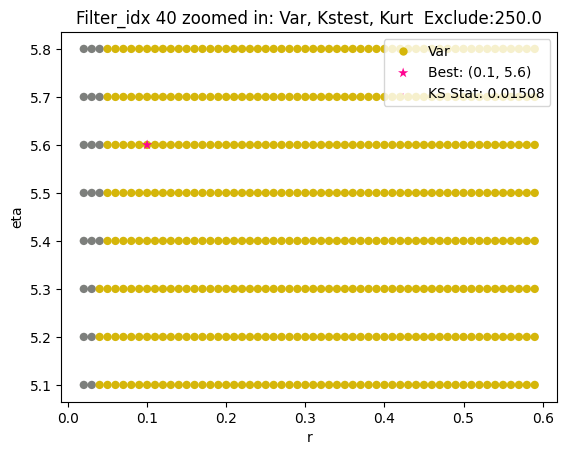

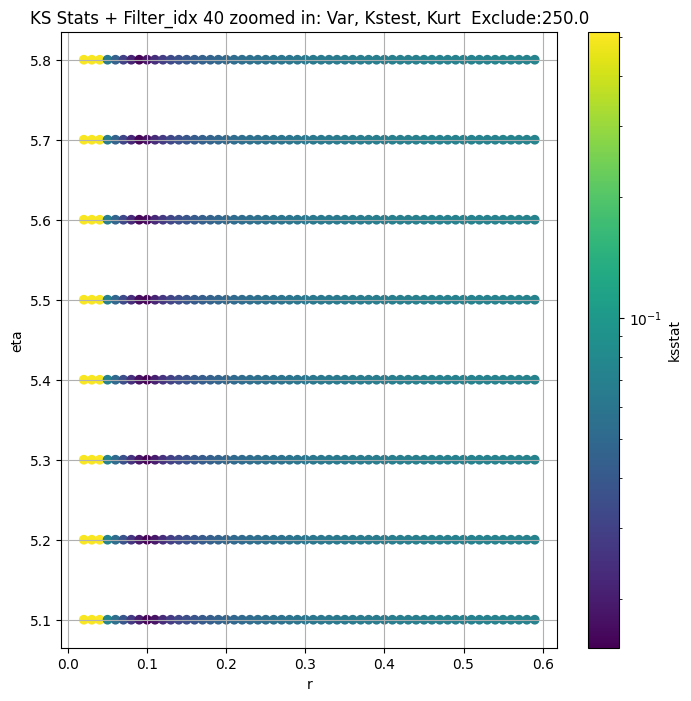

Filter_idx 41


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 0.0 + 100 = 100, ksstat: 0.006850877070582628, var: 22.53006437544688


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 0.0 + 75 = 75, ksstat: 0.0069838620100814985, var: 23.365281567543587


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 0.0 + 50 = 50, ksstat: 0.005605680679197533, var: 24.3919568524644


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 0.0 + 25 = 25, ksstat: 0.004827732415197961, var: 25.77886933514996


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 0.0 + 0 = 0, ksstat: 0.005221237218037356, var: 29.529004168366832
Number of samples: 100000, Without approximation : 480000000.0


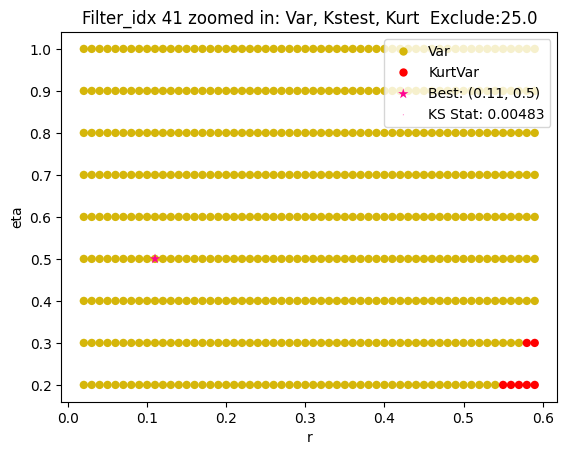

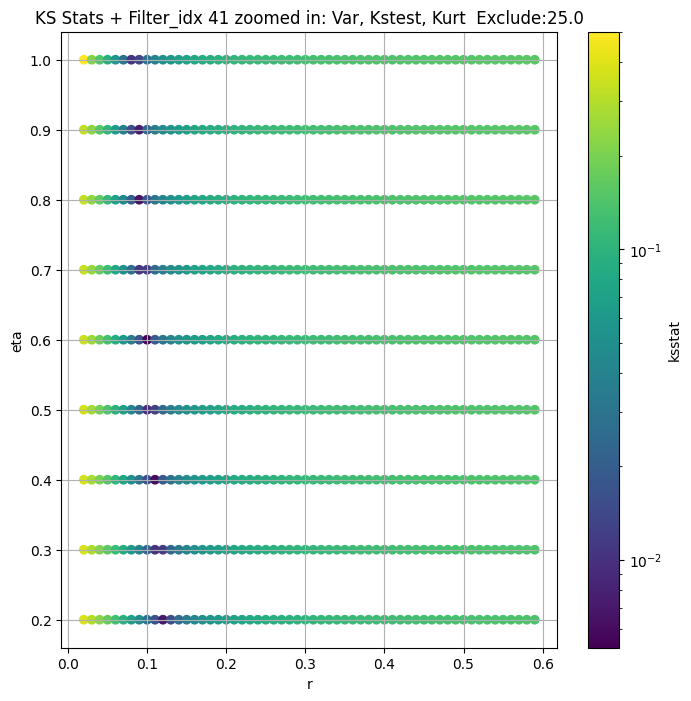

Filter_idx 42


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 42, 0.0 + 100 = 100, ksstat: 0.012702129845524657, var: 65.28720223174535


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 42, 0.0 + 75 = 75, ksstat: 0.013099034396776732, var: 67.36785285472449


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 42, 0.0 + 50 = 50, ksstat: 0.012956209982812883, var: 69.84769842691641


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 42, 0.0 + 25 = 25, ksstat: 0.012676148111728347, var: 73.04614522527942


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 42, 0.0 + 0 = 0, ksstat: 0.012383539472621496, var: 79.81629048453834
Number of samples: 100000, Without approximation : 480000000.0


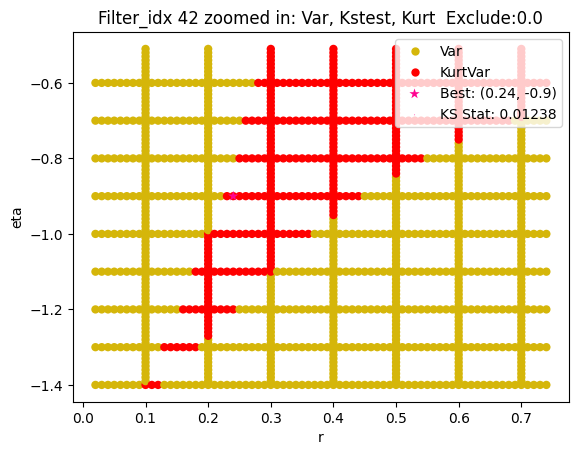

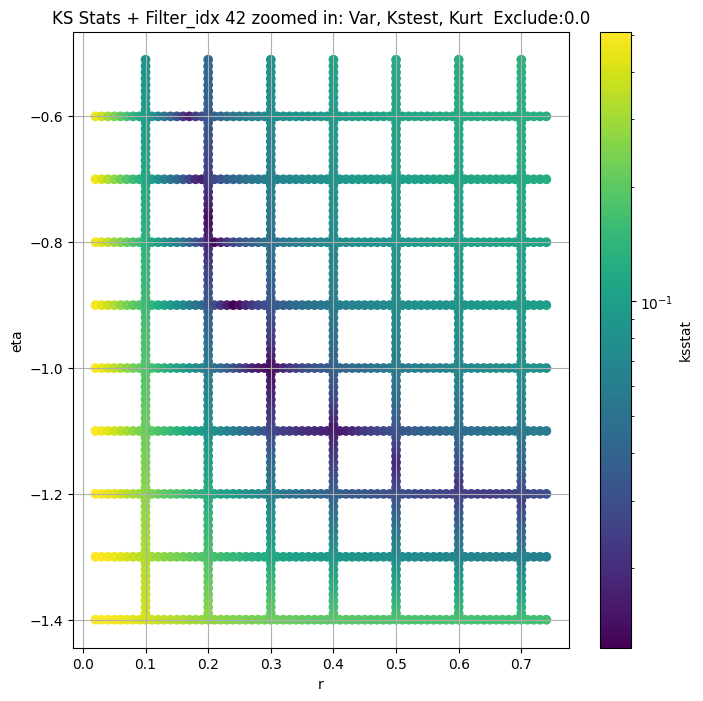

Filter_idx 43


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 200.0 + 100 = 300, ksstat: 0.017547335785672247, var: 20.537490963200487


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 200.0 + 75 = 275, ksstat: 0.01715928604068423, var: 20.863665348447302


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 200.0 + 50 = 250, ksstat: 0.016290926237506553, var: 21.20933051213132


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 200.0 + 25 = 225, ksstat: 0.016234284851109226, var: 21.577371860581305


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 200.0 + 0 = 200, ksstat: 0.016753821316307427, var: 21.97140367887118


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 200.0 + -25 = 175, ksstat: 0.017303155981719276, var: 22.396274548861854


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 200.0 + -50 = 150, ksstat: 0.017193695865379277, var: 22.858506171988996


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 200.0 + -75 = 125, ksstat: 0.017025166713744766, var: 23.366887737412945


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 43, 200.0 + -100 = 100, ksstat: 0.016843275181727013, var: 23.93444582399372
Number of samples: 100000, Without approximation : 480000000.0


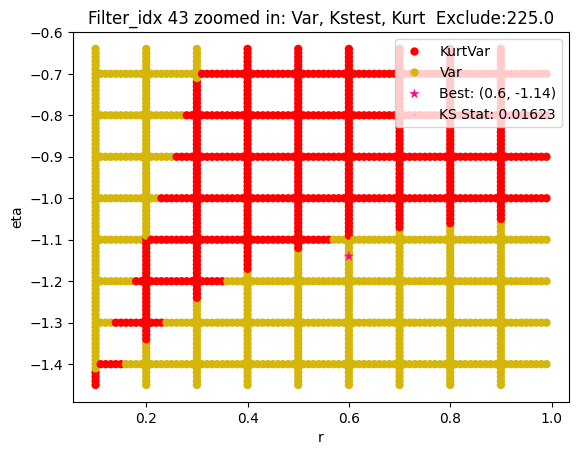

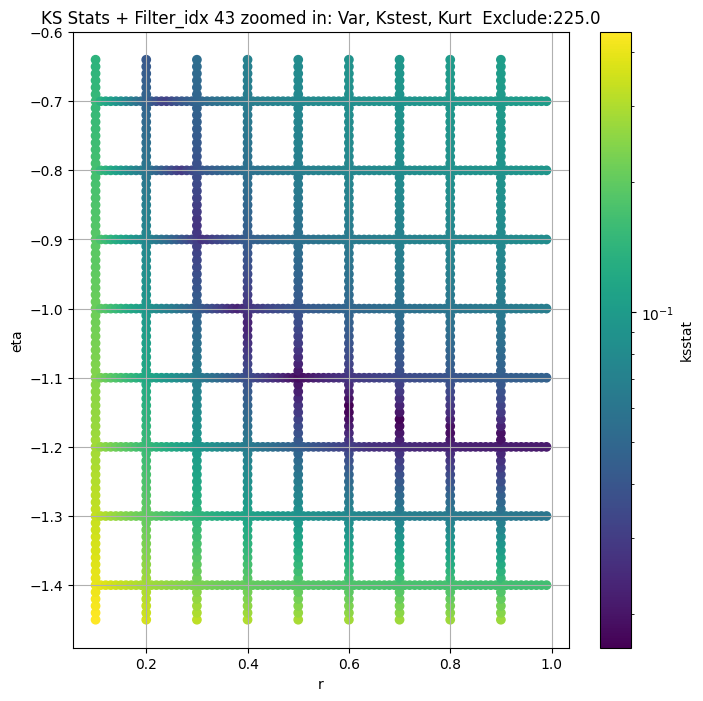

Filter_idx 44


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 44, 0.0 + 100 = 100, ksstat: 0.019002221556482513, var: 48.53548848999029


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 44, 0.0 + 75 = 75, ksstat: 0.019115730958320643, var: 50.03340647166958


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 44, 0.0 + 50 = 50, ksstat: 0.01913269390240513, var: 51.82108578496918


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 44, 0.0 + 25 = 25, ksstat: 0.01926491547946646, var: 54.14327553075052


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 44, 0.0 + 0 = 0, ksstat: 0.019197829568588454, var: 59.93764812799737
Number of samples: 100000, Without approximation : 480000000.0


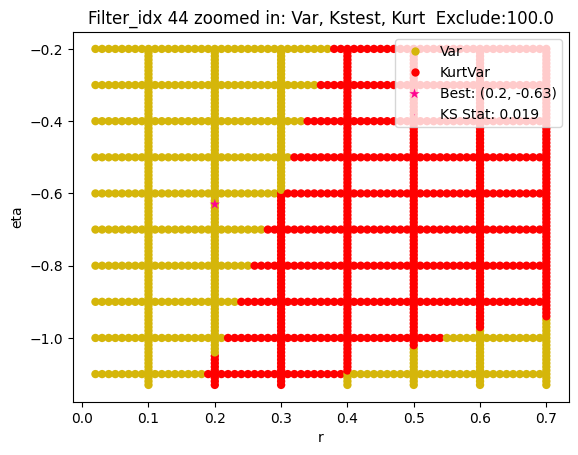

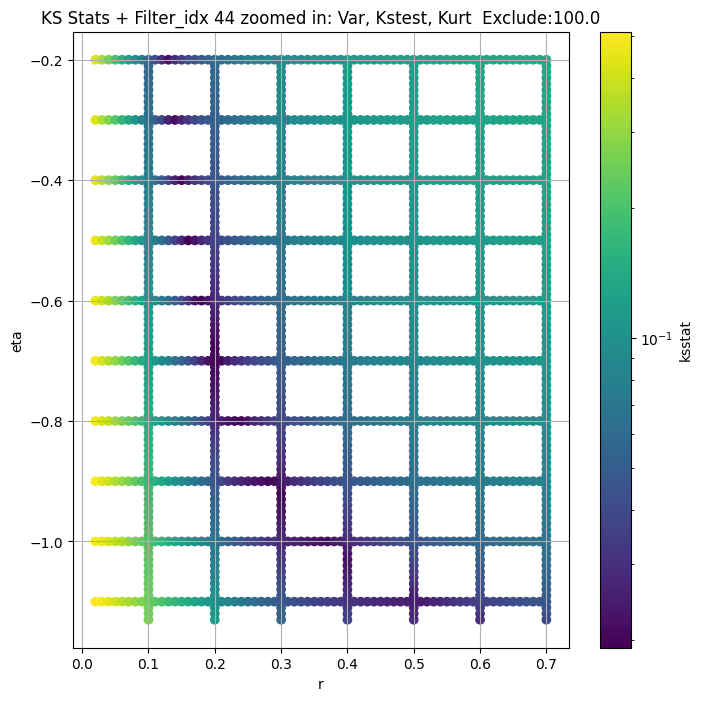

Filter_idx 45


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 45, 50.0 + 100 = 150, ksstat: 0.029678463321860138, var: 30.6729620496317


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 45, 50.0 + 75 = 125, ksstat: 0.02968121204258789, var: 31.34826757221711


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 45, 50.0 + 50 = 100, ksstat: 0.02967764153111002, var: 32.10338023168654


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 45, 50.0 + 25 = 75, ksstat: 0.029677868842569788, var: 32.96791914812624


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 45, 50.0 + 0 = 50, ksstat: 0.029677935197730376, var: 33.99733075133163


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 45, 50.0 + -25 = 25, ksstat: 0.029677903366648273, var: 35.3221393088112


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 45, 50.0 + -50 = 0, ksstat: 0.029680728842084003, var: 38.247326316433096
Number of samples: 100000, Without approximation : 480000000.0


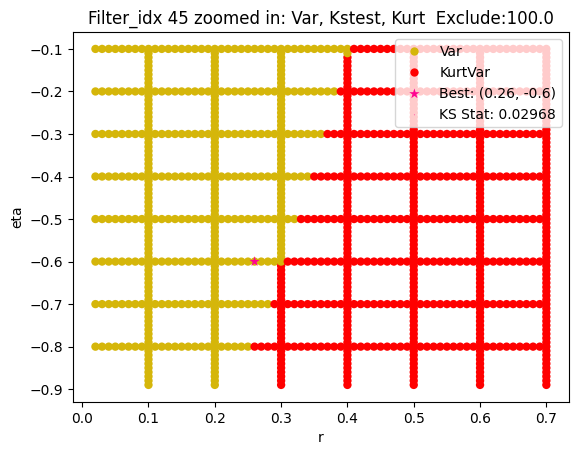

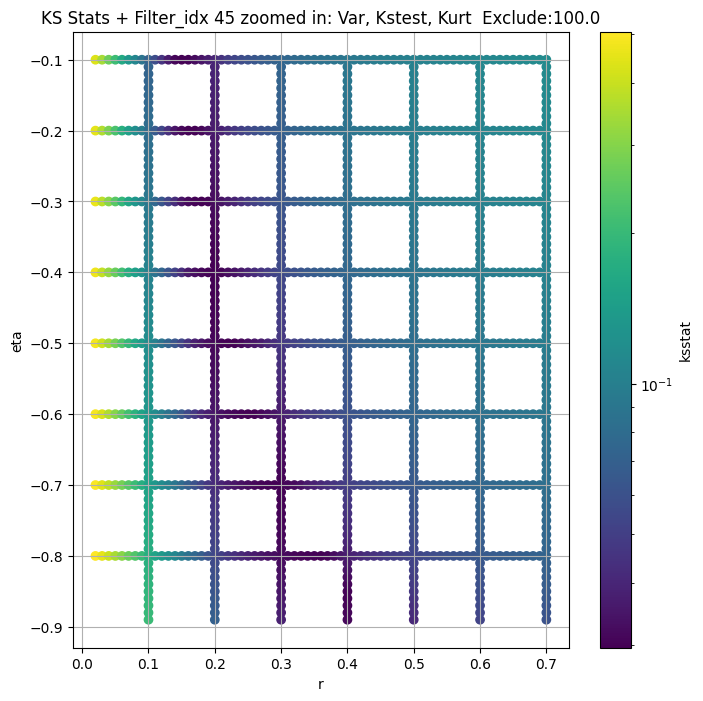

Filter_idx 46


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 46, 50.0 + 100 = 150, ksstat: 0.04433637158811482, var: 21.561176943892296


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 46, 50.0 + 75 = 125, ksstat: 0.04435320860921277, var: 21.944088804016566


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 46, 50.0 + 50 = 100, ksstat: 0.044368901135286576, var: 22.369063350257207


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 46, 50.0 + 25 = 75, ksstat: 0.04436185225290956, var: 22.851255481247062


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 46, 50.0 + 0 = 50, ksstat: 0.044388226778382056, var: 23.418767947234596


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 46, 50.0 + -25 = 25, ksstat: 0.04438236788298944, var: 24.136328838736134


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 46, 50.0 + -50 = 0, ksstat: 0.0443825178827566, var: 25.53210717746388
Number of samples: 100000, Without approximation : 480000000.0


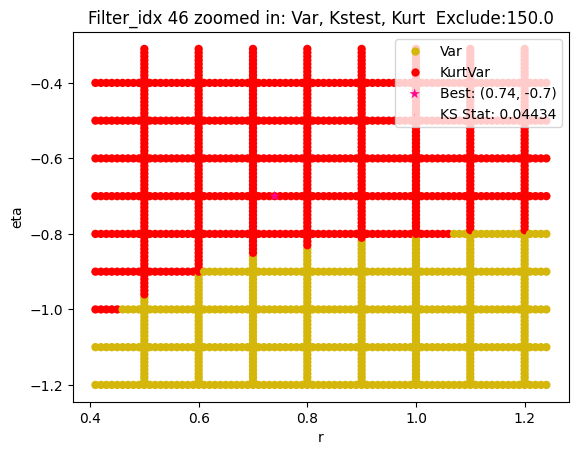

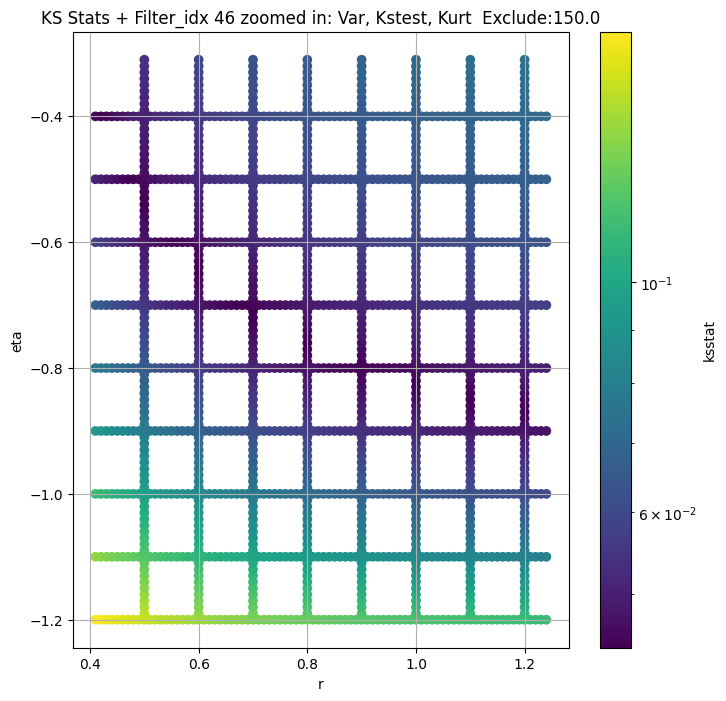

Filter_idx 47


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 47, 200.0 + 100 = 300, ksstat: 0.013492078915233185, var: 37.385833671440146


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 47, 200.0 + 75 = 275, ksstat: 0.013623205926877435, var: 37.904736778148816


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 47, 200.0 + 50 = 250, ksstat: 0.013638271376287037, var: 38.44972265341763


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 47, 200.0 + 25 = 225, ksstat: 0.013563671781380071, var: 39.024426724115706


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 47, 200.0 + 0 = 200, ksstat: 0.013485796974881614, var: 39.63314787522847


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 47, 200.0 + -25 = 175, ksstat: 0.013758614255236723, var: 40.281441962558674


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 47, 200.0 + -50 = 150, ksstat: 0.013672185252912805, var: 40.97682656973


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 47, 200.0 + -75 = 125, ksstat: 0.01358015038161009, var: 41.73000643391613


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 47, 200.0 + -100 = 100, ksstat: 0.013584951674426471, var: 42.556503373529196
Number of samples: 100000, Without approximation : 480000000.0


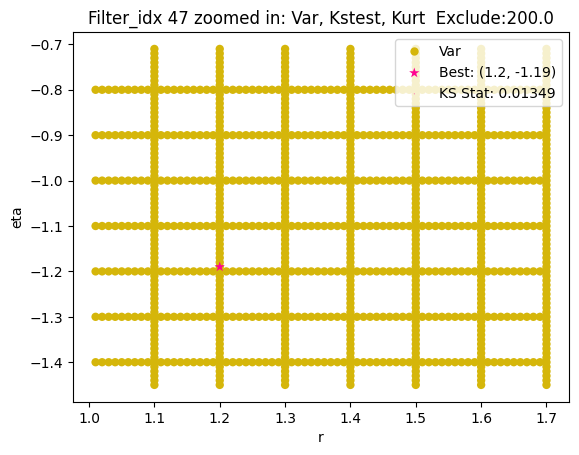

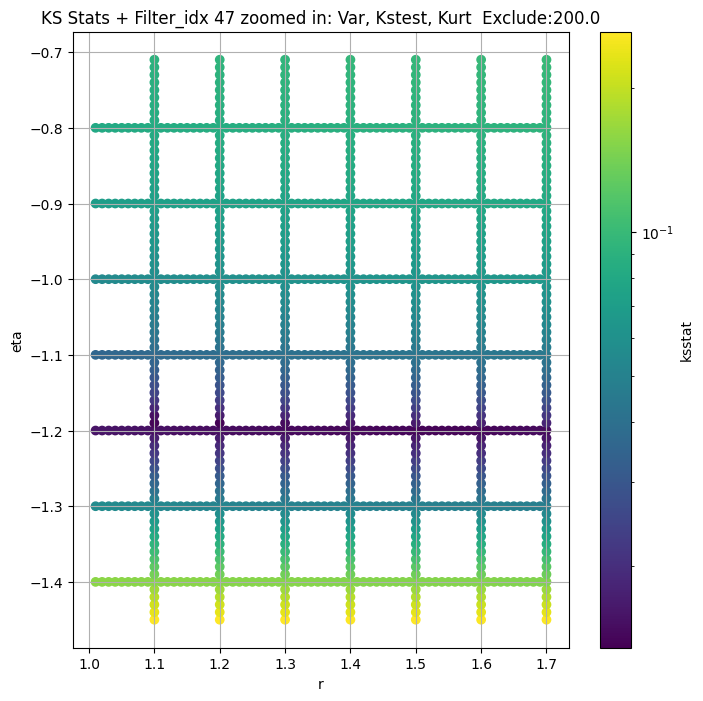

Filter_idx 48


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 50.0 + 100 = 150, ksstat: 0.01454475136736022, var: 15.140934447743524


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 50.0 + 75 = 125, ksstat: 0.013555292083041182, var: 15.532503506358077


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 50.0 + 50 = 100, ksstat: 0.012775258763563446, var: 15.972620119065335


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 50.0 + 25 = 75, ksstat: 0.012318032484605057, var: 16.479488667169324


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 50.0 + 0 = 50, ksstat: 0.011651884779827482, var: 17.087272150112394


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 50.0 + -25 = 25, ksstat: 0.012323748812926305, var: 17.880020742468943


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 50.0 + -50 = 0, ksstat: 0.011454325754135852, var: 19.873367008314258
Number of samples: 100000, Without approximation : 480000000.0


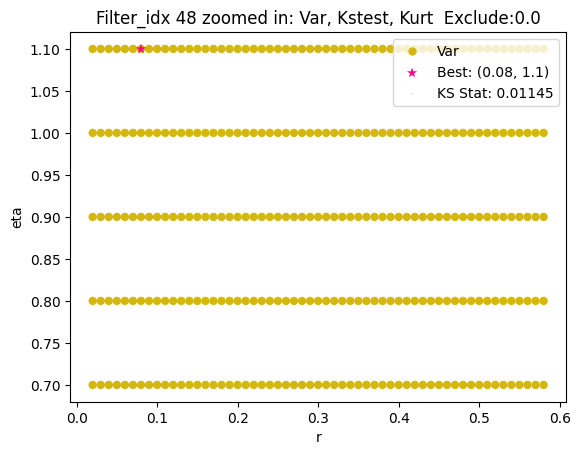

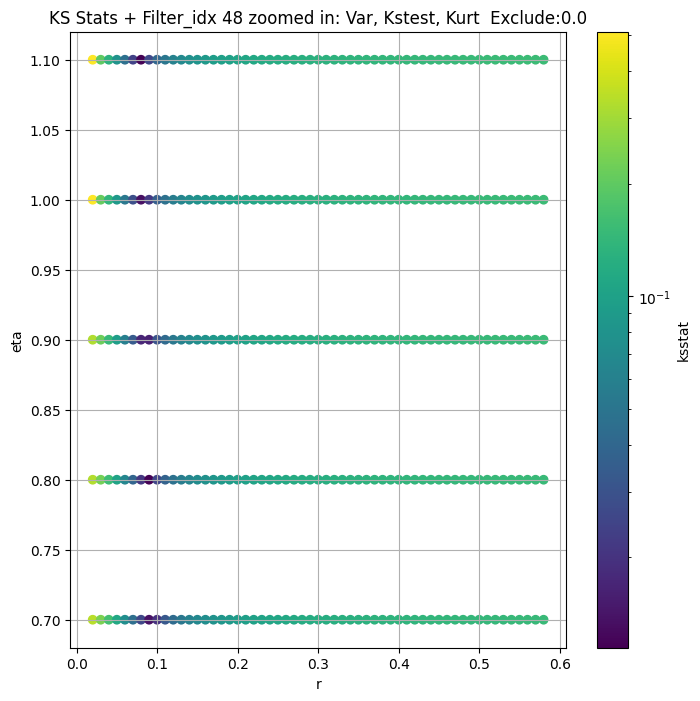

Filter_idx 49


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 49, 0.0 + 100 = 100, ksstat: 0.013802254336745229, var: 62.050744274010206


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 49, 0.0 + 75 = 75, ksstat: 0.014008344062500122, var: 64.12484093815496


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 49, 0.0 + 50 = 50, ksstat: 0.013060983808714025, var: 66.60957126501138


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 49, 0.0 + 25 = 25, ksstat: 0.013859145466808054, var: 69.83237564860397


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 49, 0.0 + 0 = 0, ksstat: 0.013023912488219214, var: 76.5977280890017
Number of samples: 100000, Without approximation : 480000000.0


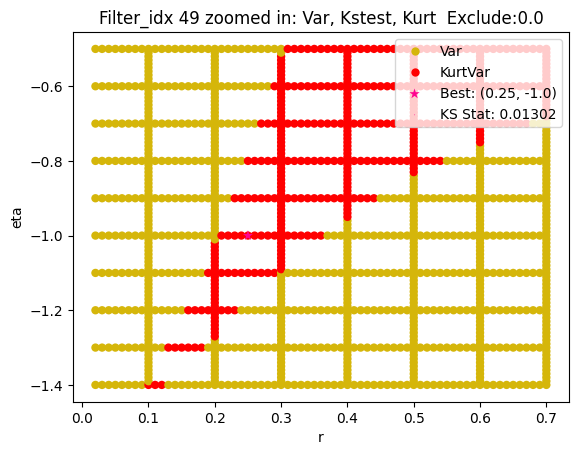

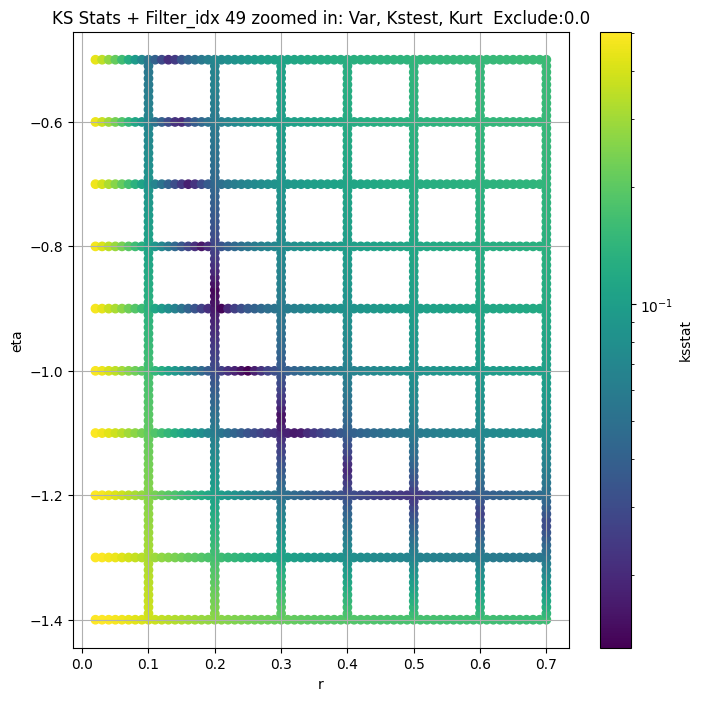

Filter_idx 50


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 50, 200.0 + 100 = 300, ksstat: 0.02028166747256055, var: 41.86817564022047


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 50, 200.0 + 75 = 275, ksstat: 0.02059715554413666, var: 42.57647130628008


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 50, 200.0 + 50 = 250, ksstat: 0.02029055703434246, var: 43.326790658821345


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 50, 200.0 + 25 = 225, ksstat: 0.020373654183238887, var: 44.12548194512377


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 50, 200.0 + 0 = 200, ksstat: 0.020396099751427088, var: 44.980454670419576


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 50, 200.0 + -25 = 175, ksstat: 0.0195047789817957, var: 45.901926374550676


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 50, 200.0 + -50 = 150, ksstat: 0.019506936546314524, var: 46.90416647005264


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 50, 200.0 + -75 = 125, ksstat: 0.0193717299545772, var: 48.00643519525904


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 50, 200.0 + -100 = 100, ksstat: 0.019375614936502583, var: 49.23804999145312
Number of samples: 100000, Without approximation : 480000000.0


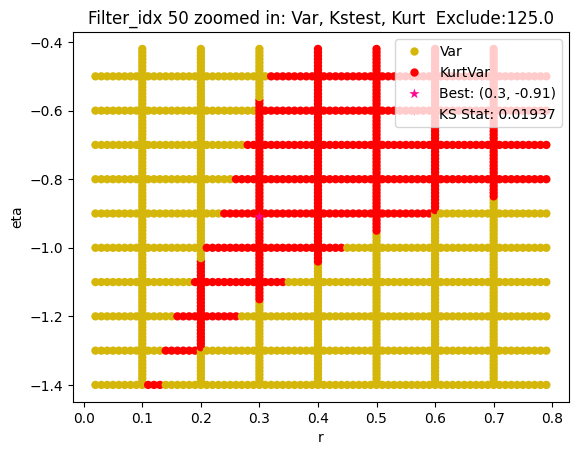

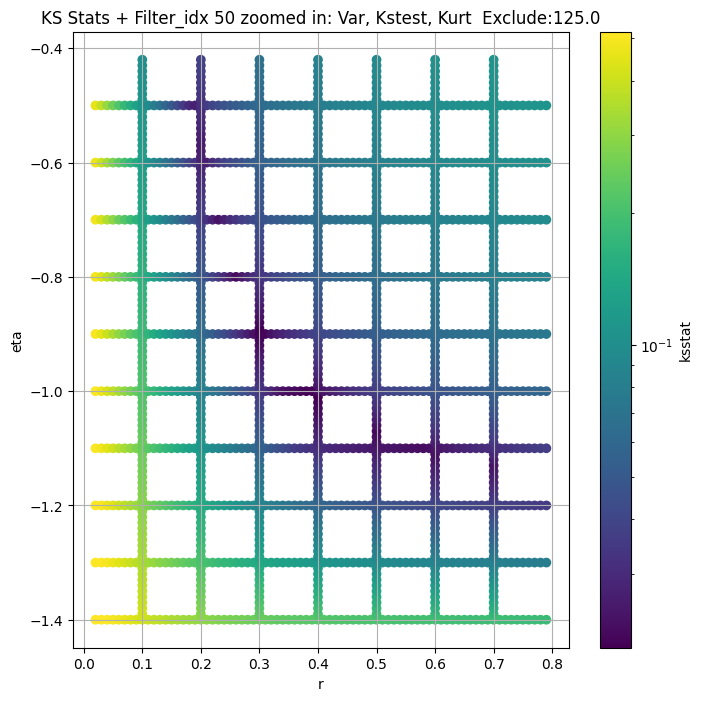

Filter_idx 52


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 100 = 300, ksstat: 0.017199961495133587, var: 33.19665370089988


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 75 = 275, ksstat: 0.017245744863742973, var: 33.53044629409941


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 50 = 250, ksstat: 0.017291349381485466, var: 33.881160300613075


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 25 = 225, ksstat: 0.017336137579811117, var: 34.25172960710402


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 0 = 200, ksstat: 0.017379144480191067, var: 34.645678581720496


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + -25 = 175, ksstat: 0.017418857762616424, var: 35.067489962178364


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + -50 = 150, ksstat: 0.017453267316614673, var: 35.52380739136283


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + -75 = 125, ksstat: 0.01747943059522994, var: 36.02411630563828


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + -100 = 100, ksstat: 0.017382614460564272, var: 36.58273614435795
Number of samples: 100000, Without approximation : 480000000.0


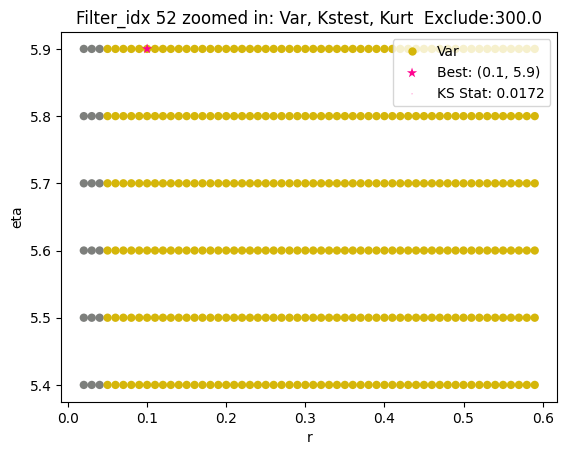

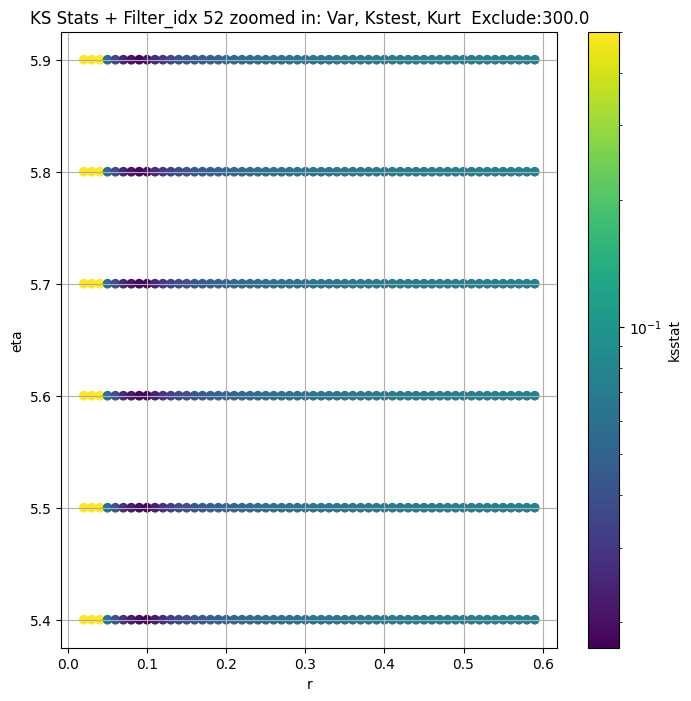

Filter_idx 54


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 54, 50.0 + 100 = 150, ksstat: 0.004418198243741789, var: 4.72945165789997


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 54, 50.0 + 75 = 125, ksstat: 0.004076512111284014, var: 4.838246147758739


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 54, 50.0 + 50 = 100, ksstat: 0.004051973520209806, var: 4.96229327212874


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 54, 50.0 + 25 = 75, ksstat: 0.0035123509058877234, var: 5.107812507842511


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 54, 50.0 + 0 = 50, ksstat: 0.003924868047606889, var: 5.287061585995803


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 54, 50.0 + -25 = 25, ksstat: 0.004425052528945761, var: 5.530450740845037


  0%|          | 0/879 [00:00<?, ?it/s]

Finding Minimum after computing 879 CDFs
filter_idx 54, 50.0 + -50 = 0, ksstat: 0.0057591013899699894, var: 6.529077828183722
Number of samples: 100000, Without approximation : 480000000.0


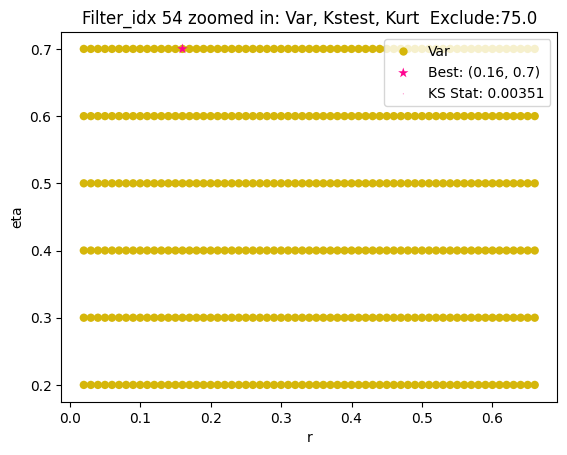

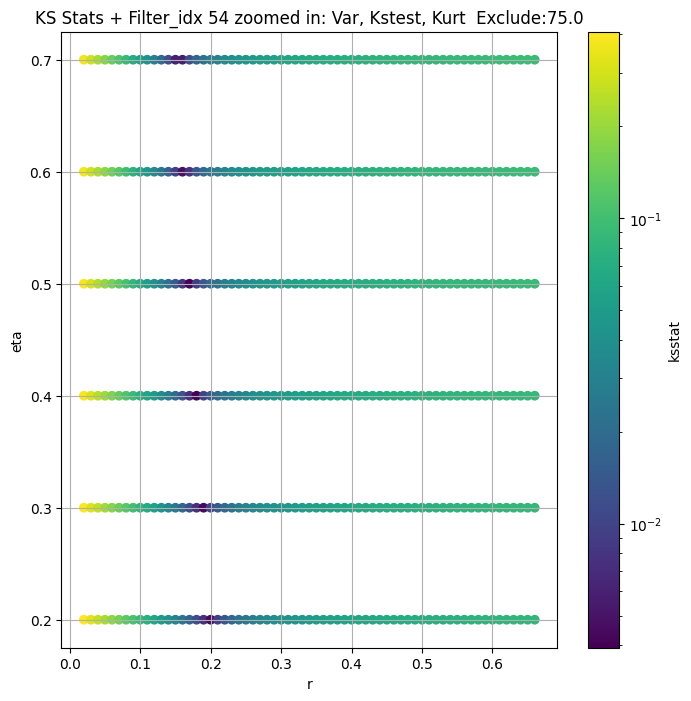

Filter_idx 55


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 55, 0.0 + 100 = 100, ksstat: 0.008058177277570855, var: 24.731492335073938


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 55, 0.0 + 75 = 75, ksstat: 0.006923088170808778, var: 25.612476017687754


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 55, 0.0 + 50 = 50, ksstat: 0.007157560650667527, var: 26.68851865852578


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 55, 0.0 + 25 = 25, ksstat: 0.006928623400605405, var: 28.126938860880355


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 55, 0.0 + 0 = 0, ksstat: 0.0063728537888603776, var: 31.917315459019385
Number of samples: 100000, Without approximation : 480000000.0


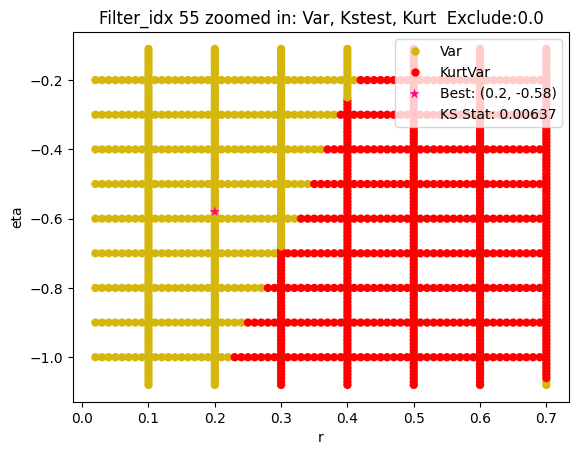

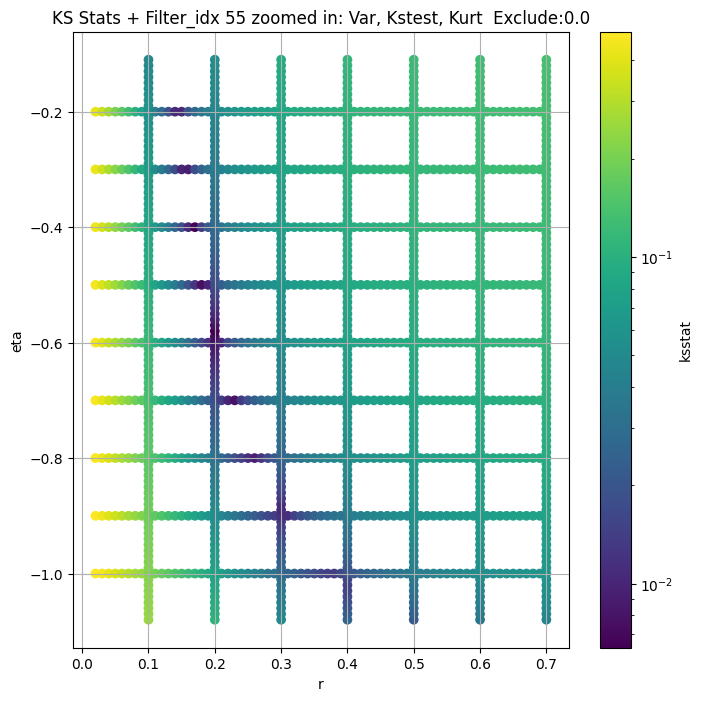

Filter_idx 56


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 56, 100.0 + 100 = 200, ksstat: 0.01473299853753407, var: 50.44076424530852


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 56, 100.0 + 75 = 175, ksstat: 0.014436189360365614, var: 51.48633916564041


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 56, 100.0 + 50 = 150, ksstat: 0.01475658135432445, var: 52.61910142322749


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 56, 100.0 + 25 = 125, ksstat: 0.014745774288694169, var: 53.85953274680115


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 56, 100.0 + 0 = 100, ksstat: 0.015061495010820214, var: 55.238446074192744


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 56, 100.0 + -25 = 75, ksstat: 0.014865199579160326, var: 56.80591480642884


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 56, 100.0 + -50 = 50, ksstat: 0.015167863688337446, var: 58.652725953662916


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 56, 100.0 + -75 = 25, ksstat: 0.014893072108951633, var: 60.990036147245526


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 56, 100.0 + -100 = 0, ksstat: 0.014435517929571345, var: 65.71891184267646
Number of samples: 100000, Without approximation : 480000000.0


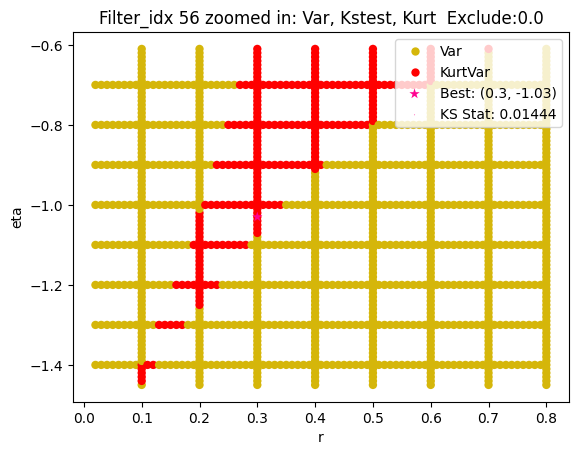

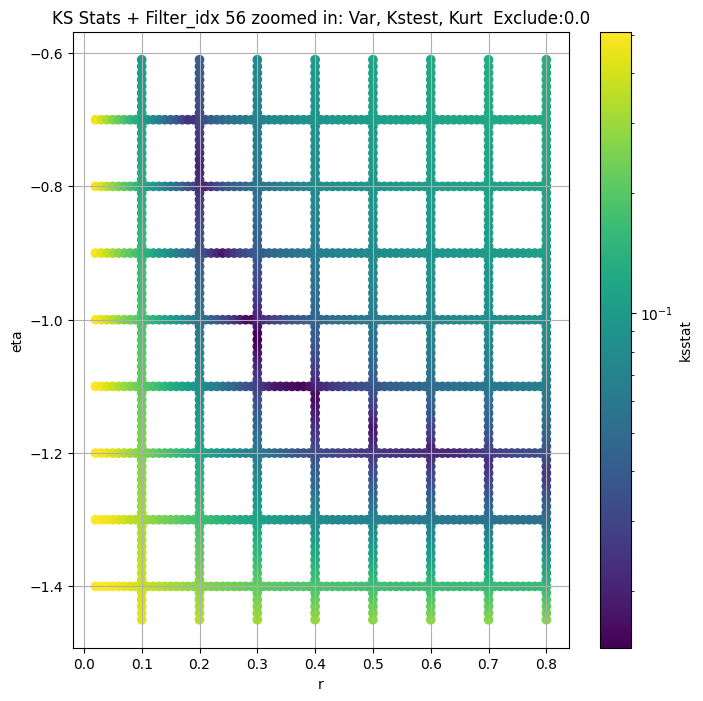

Filter_idx 57


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 57, 50.0 + 100 = 150, ksstat: 0.01288754737529102, var: 38.21613578120979


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 57, 50.0 + 75 = 125, ksstat: 0.012319789541623036, var: 39.14011403409026


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 57, 50.0 + 50 = 100, ksstat: 0.012143871551863694, var: 40.176444931728675


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 57, 50.0 + 25 = 75, ksstat: 0.011491294694293996, var: 41.36732179537948


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 57, 50.0 + 0 = 50, ksstat: 0.011512392617106681, var: 42.79186603012281


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 57, 50.0 + -25 = 25, ksstat: 0.011426560574518296, var: 44.63982995062483


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 57, 50.0 + -50 = 0, ksstat: 0.010630626056605696, var: 49.04221990353983
Number of samples: 100000, Without approximation : 480000000.0


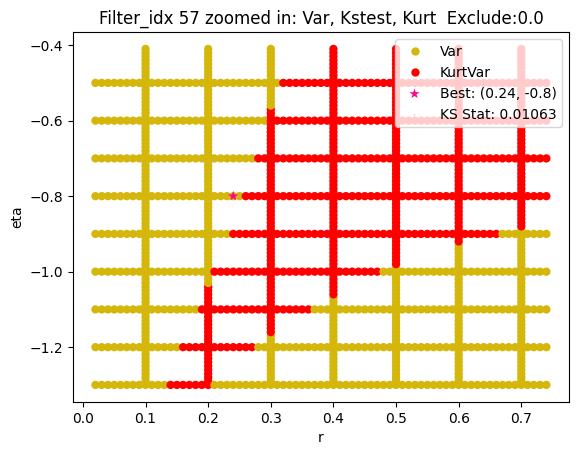

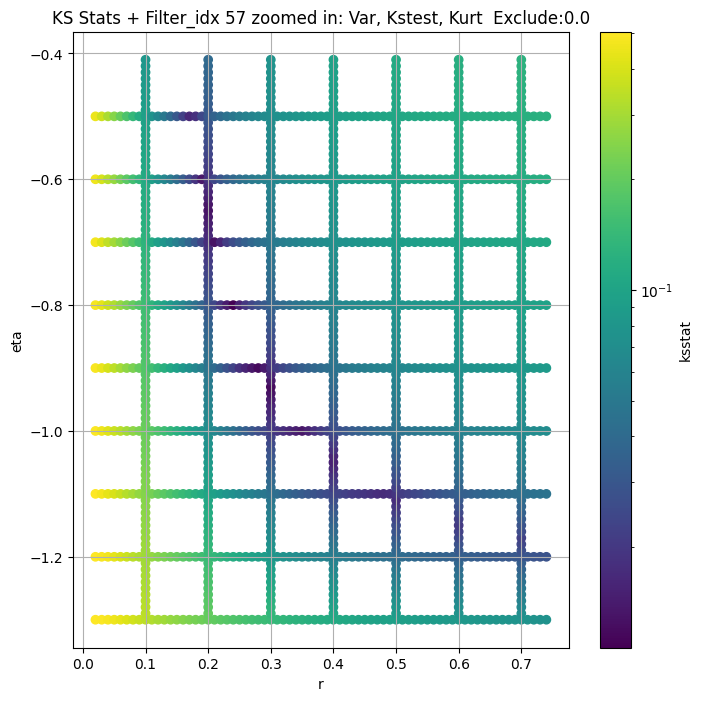

Filter_idx 58


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + 100 = 300, ksstat: 0.028368284924610854, var: 18.267054822653


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + 75 = 275, ksstat: 0.028460166095953088, var: 18.444727472499014


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + 50 = 250, ksstat: 0.0285032585649323, var: 18.63166353379917


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + 25 = 225, ksstat: 0.028551801947890976, var: 18.829217994215185


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + 0 = 200, ksstat: 0.02865907417730923, var: 19.039150386550713


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + -25 = 175, ksstat: 0.02867230279562527, var: 19.263713492934755


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + -50 = 150, ksstat: 0.028746110499928923, var: 19.505931907935313


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + -75 = 125, ksstat: 0.028848386594363618, var: 19.769890950699377


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 58, 200.0 + -100 = 100, ksstat: 0.028920905924022966, var: 20.061698259100698
Number of samples: 100000, Without approximation : 480000000.0


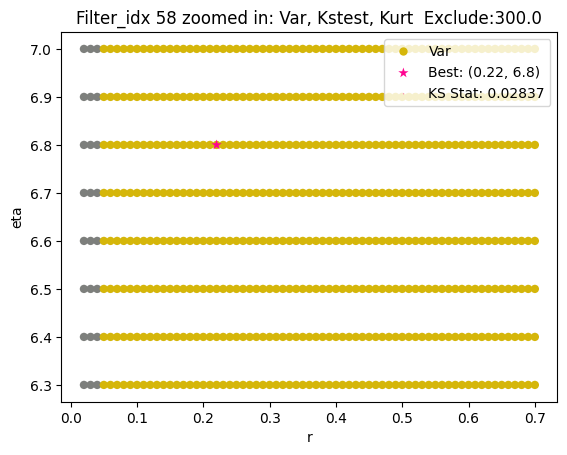

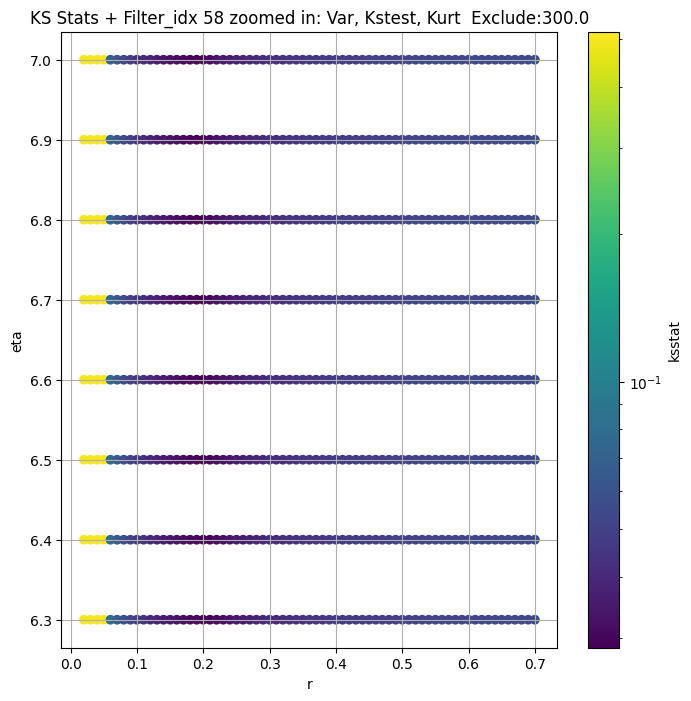

Filter_idx 59


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 59, 200.0 + 100 = 300, ksstat: 0.013704138013997169, var: 60.23810214951547


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 59, 200.0 + 75 = 275, ksstat: 0.013951376459249043, var: 61.114198741043964


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 59, 200.0 + 50 = 250, ksstat: 0.013920832976088315, var: 62.03704182816044


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 59, 200.0 + 25 = 225, ksstat: 0.013924758855459518, var: 63.01344201200891


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 59, 200.0 + 0 = 200, ksstat: 0.013949131261950909, var: 64.05197506921688


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 59, 200.0 + -25 = 175, ksstat: 0.013959548793369636, var: 65.16333996337019


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 59, 200.0 + -50 = 150, ksstat: 0.013994902240256568, var: 66.36218973982233


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 59, 200.0 + -75 = 125, ksstat: 0.014037256615807514, var: 67.66887170197688


  0%|          | 0/587 [00:00<?, ?it/s]

Finding Minimum after computing 587 CDFs
filter_idx 59, 200.0 + -100 = 100, ksstat: 0.014084148011959008, var: 69.11267087970396
Number of samples: 100000, Without approximation : 480000000.0


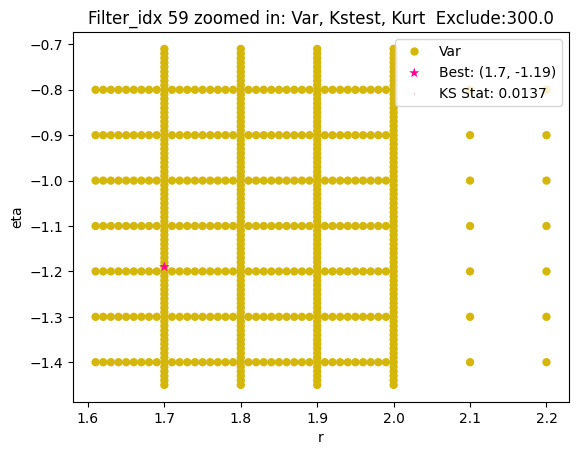

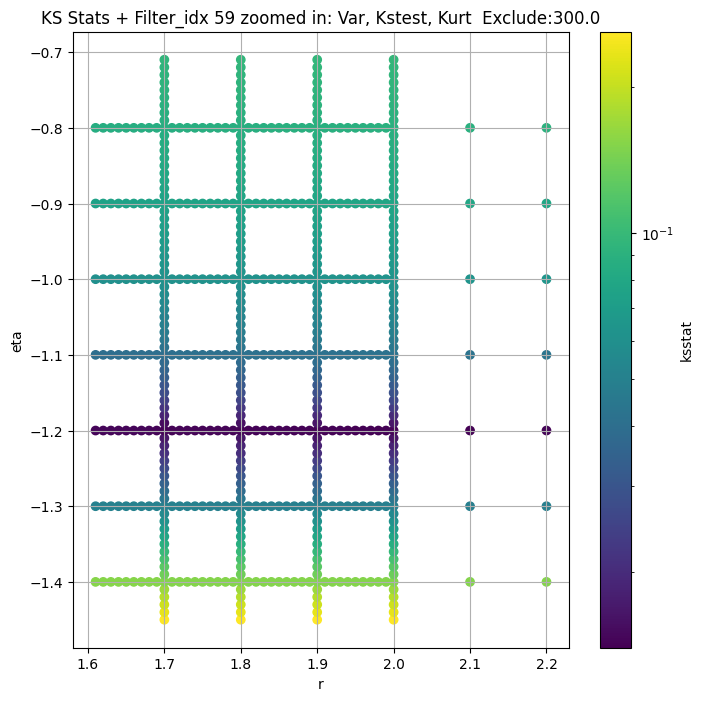

Filter_idx 60


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 100 = 300, ksstat: 0.01040741971294007, var: 3.76755731114473


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 75 = 275, ksstat: 0.010412509721114016, var: 3.821248338667234


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 50 = 250, ksstat: 0.010406922655994688, var: 3.8782159225944226


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 25 = 225, ksstat: 0.010412350409014837, var: 3.938971641293103


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 0 = 200, ksstat: 0.010410193321072903, var: 4.004164149917366


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -25 = 175, ksstat: 0.01042405443246508, var: 4.0746401981400835


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -50 = 150, ksstat: 0.010409893360233291, var: 4.151577310137113


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -75 = 125, ksstat: 0.010406861753081142, var: 4.236631501781719


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -100 = 100, ksstat: 0.010426648268315963, var: 4.3323063798977985
Number of samples: 100000, Without approximation : 480000000.0


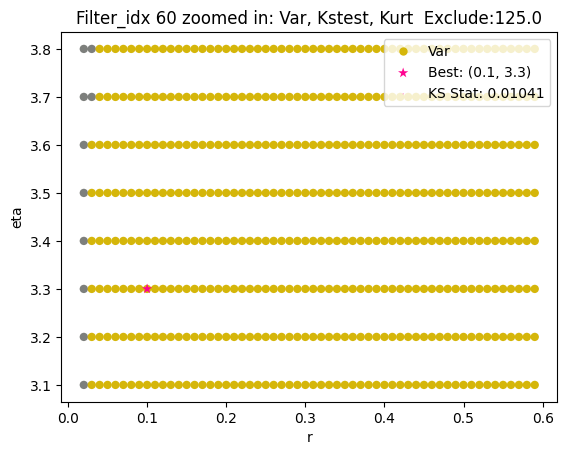

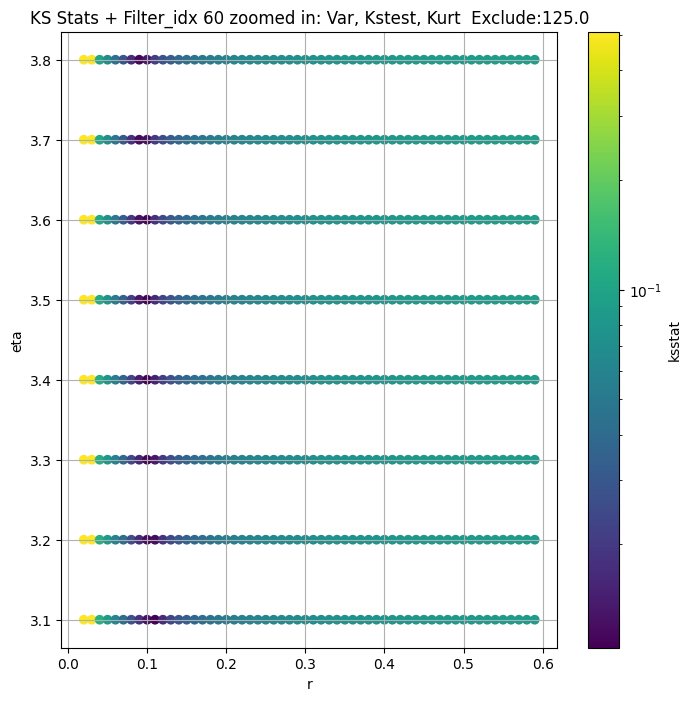

Filter_idx 61


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + 100 = 200, ksstat: 0.011466940492763755, var: 15.397509884541643


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + 75 = 175, ksstat: 0.011062565845298855, var: 15.704001217157824


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + 50 = 150, ksstat: 0.011488306465370468, var: 16.037787981614777


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + 25 = 125, ksstat: 0.011285610079899255, var: 16.40571256155186


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + 0 = 100, ksstat: 0.011146171927063908, var: 16.818241958849438


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + -25 = 75, ksstat: 0.010858690797347359, var: 17.292557307512617


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + -50 = 50, ksstat: 0.010528035581688577, var: 17.860867392365737


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + -75 = 25, ksstat: 0.010584872841808146, var: 18.59980403727921


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 61, 100.0 + -100 = 0, ksstat: 0.01087706625007967, var: 20.290319875974852
Number of samples: 100000, Without approximation : 480000000.0


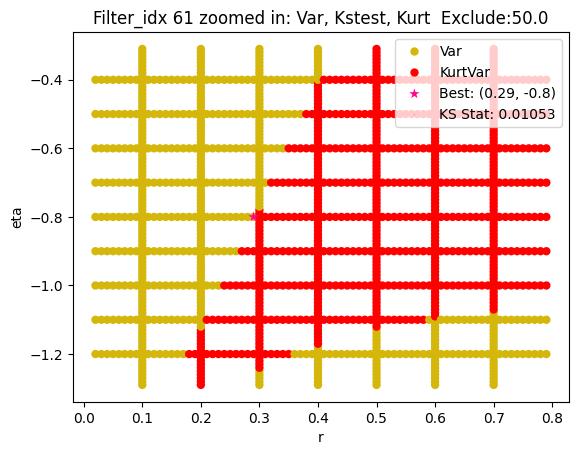

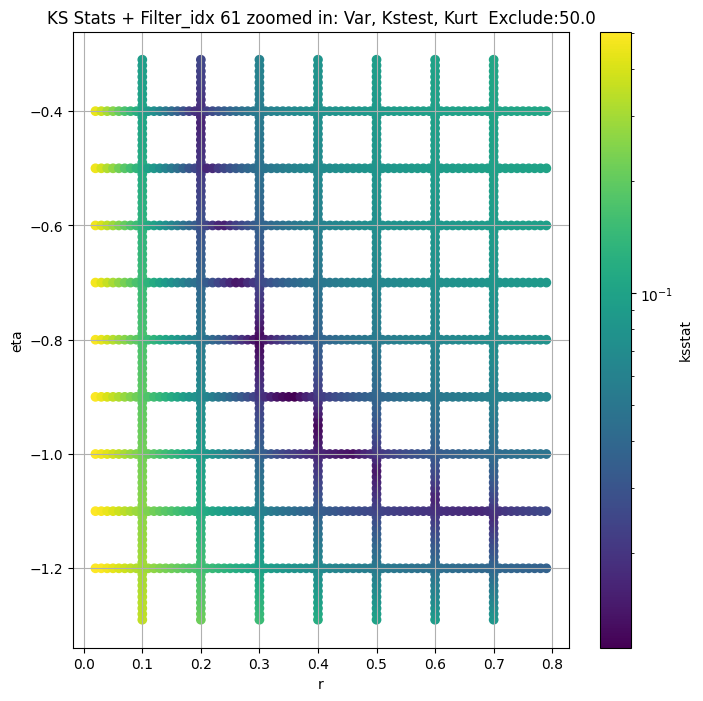

Filter_idx 62


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 62, 50.0 + 100 = 150, ksstat: 0.034607734651884714, var: 50.31552325010145


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 62, 50.0 + 75 = 125, ksstat: 0.03460152391072141, var: 51.342470964141626


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 62, 50.0 + 50 = 100, ksstat: 0.03460348706923644, var: 52.47972420830983


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 62, 50.0 + 25 = 75, ksstat: 0.03460286636439436, var: 53.76798116855424


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 62, 50.0 + 0 = 50, ksstat: 0.03460396511532171, var: 55.279509039152536


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 62, 50.0 + -25 = 25, ksstat: 0.034600477440744015, var: 57.18263627518128


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 62, 50.0 + -50 = 0, ksstat: 0.034601258936959756, var: 60.90431571509468
Number of samples: 100000, Without approximation : 480000000.0


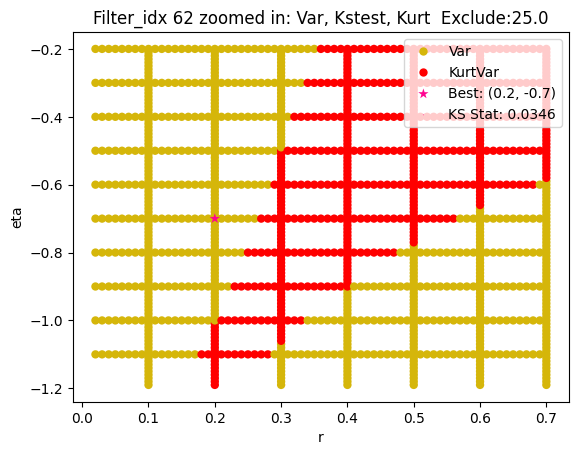

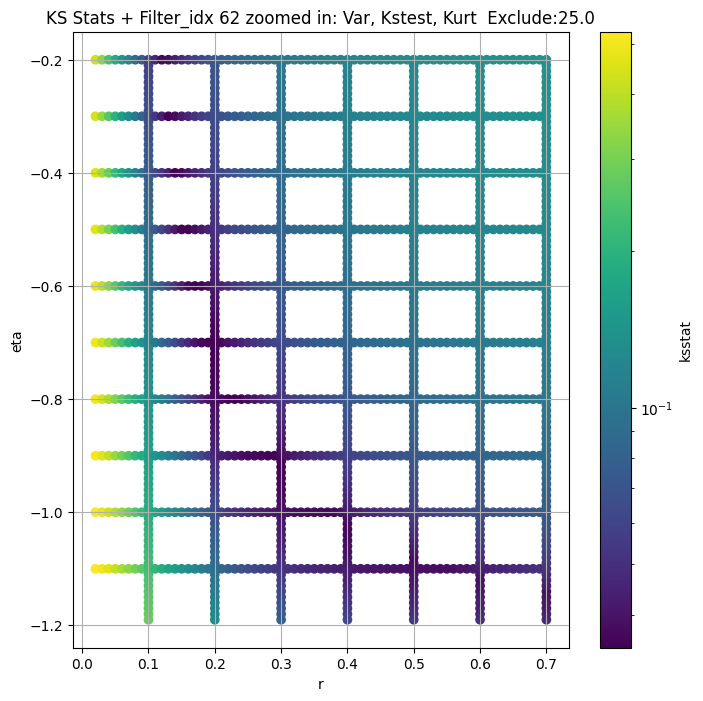

Filter_idx 63


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 50.0 + 100 = 150, ksstat: 0.005276221032627801, var: 11.602162246974089


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 50.0 + 75 = 125, ksstat: 0.004258663278358998, var: 11.904964740751652


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 50.0 + 50 = 100, ksstat: 0.0036675915311224494, var: 12.250818791143669


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 50.0 + 25 = 75, ksstat: 0.0030039542066929784, var: 12.657301628718052


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 50.0 + 0 = 50, ksstat: 0.0030687392534544666, var: 13.157286553928335


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 50.0 + -25 = 25, ksstat: 0.0032893587344819397, var: 13.833544886111694


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 50.0 + -50 = 0, ksstat: 0.005058622133858048, var: 15.903836474724766
Number of samples: 100000, Without approximation : 480000000.0


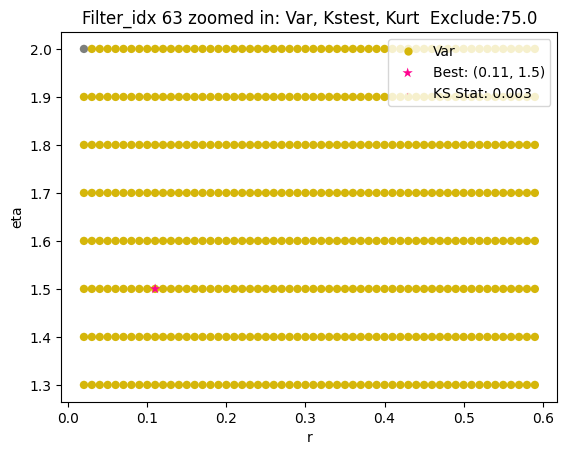

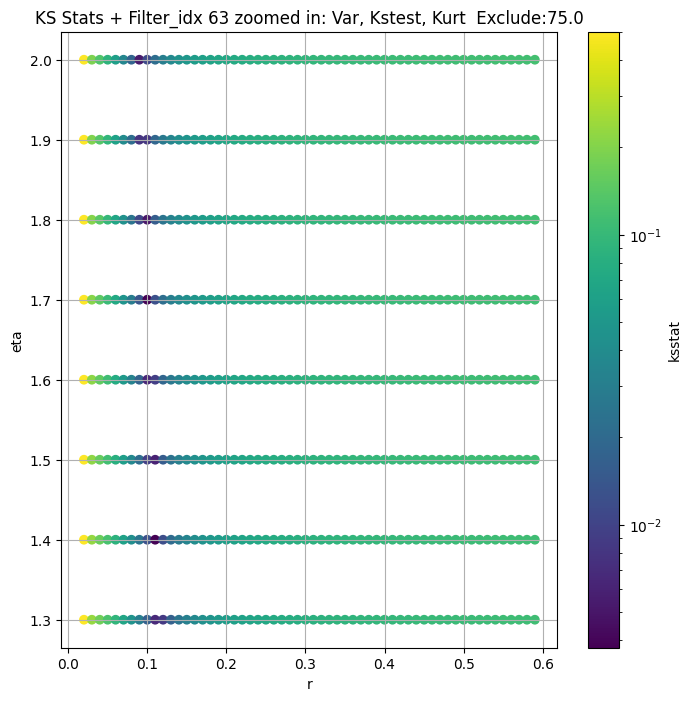

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,57.214930,36.411798,123.231320,41.285444,8.164086,290.107658,480000000.0,dual_color,0.026880,0.1,...,1.639573e-12,50.0,52.401895,0.000062,0.026836,0.10,0.30,1.711720e-12,25.0,2605
2,82.084655,53.717774,153.965127,37.569183,8.917034,238.811972,480000000.0,dual_color,0.011517,0.2,...,1.943767e-02,0.0,82.084655,0.000062,0.011517,0.20,-0.80,1.943767e-02,0.0,14648
3,22.611322,14.994184,56.104513,71.905866,6.891111,399.202547,480000000.0,single_edge,0.007990,0.2,...,1.495458e-03,0.0,22.611322,0.000062,0.007194,0.22,-0.60,8.160054e-03,0.0,37077
4,94.077089,65.025735,156.865921,21.475630,7.446571,115.107643,480000000.0,dual_color,0.014987,0.3,...,3.057587e+00,100.0,88.601841,0.000062,0.013989,0.29,-1.00,2.592521e+00,25.0,9268
5,57.483240,41.660774,87.700814,15.550781,5.322732,125.788486,480000000.0,dual_color,0.026122,0.4,...,1.090008e+01,50.0,50.044837,0.000062,0.025951,0.40,-0.99,9.903198e+00,125.0,2746
6,43.728233,28.124144,96.209185,43.878386,6.806653,310.438016,480000000.0,single_edge,0.017838,0.5,...,2.673523e+01,50.0,43.728233,0.000062,0.014399,0.30,-0.95,1.329371e+00,0.0,9268
7,24.626245,18.353888,40.167357,15.670190,3.287687,146.797712,480000000.0,inside_out,0.041974,1.1,...,2.484352e+01,100.0,22.317552,0.000062,0.041935,0.90,-0.42,1.744598e+01,75.0,1029
8,1.924674,1.357594,6.607376,122.928559,3.710739,541.449082,480000000.0,misc,0.018556,0.2,...,1.399414e-06,50.0,1.924674,0.000062,0.018555,0.21,1.00,7.386035e-06,0.0,5493
9,9.369960,5.267412,83.557988,993.476242,6.442853,796.346524,480000000.0,multi_edge,0.003558,0.2,...,9.661795e-05,50.0,7.065595,0.000062,0.003376,0.16,0.40,4.086458e-07,50.0,166852


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group} zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

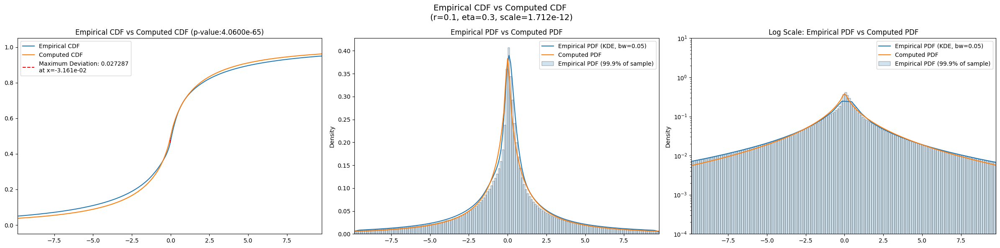

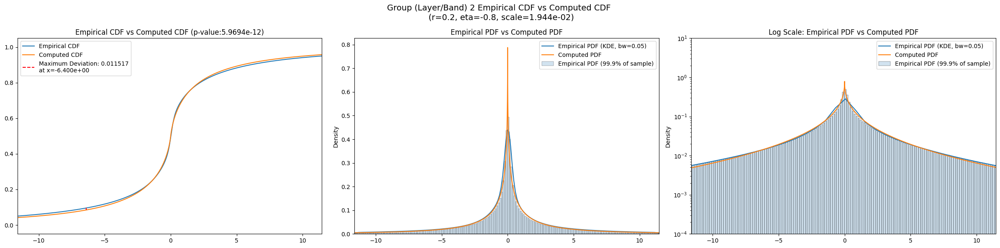

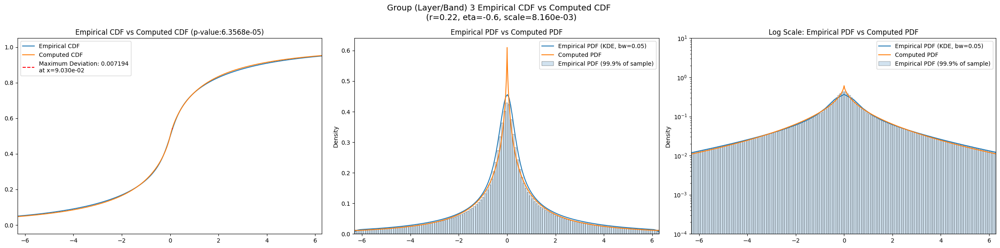

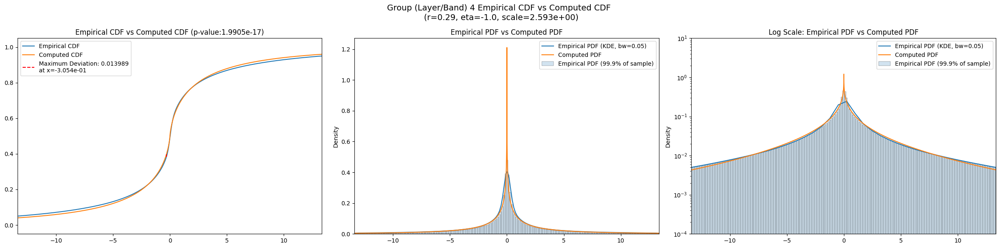

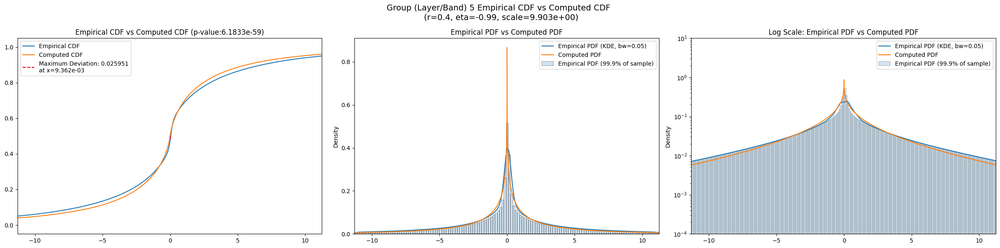

...

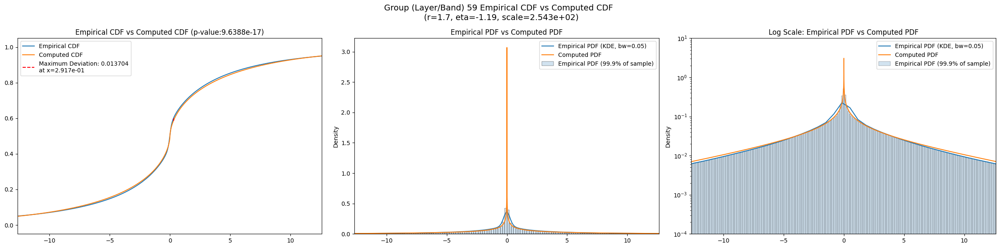

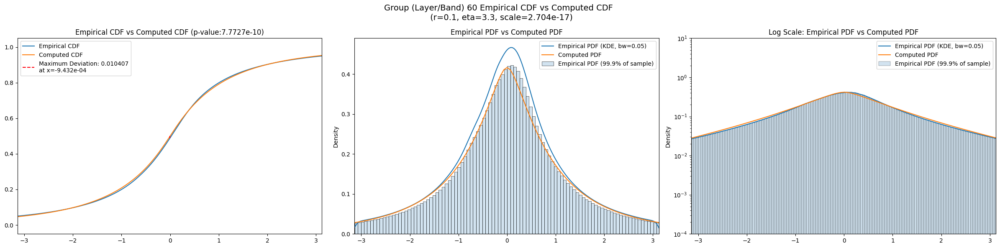

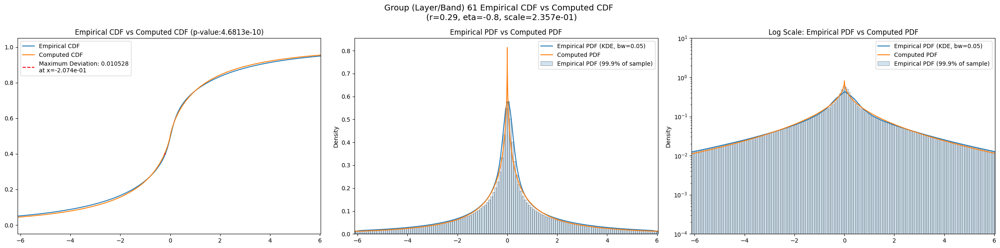

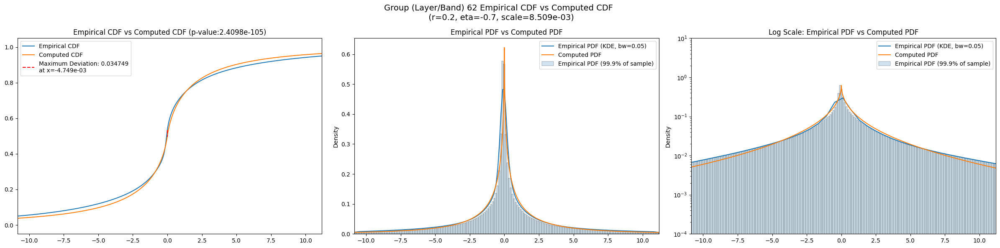

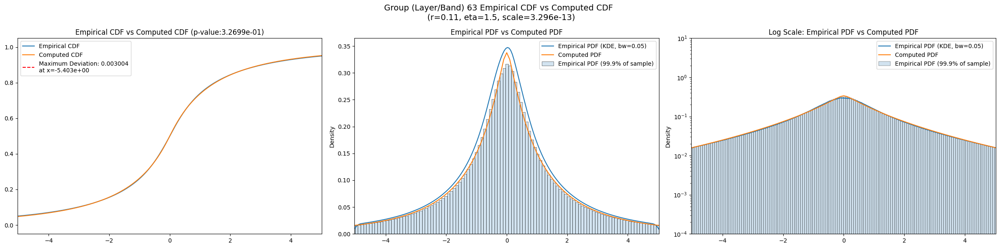

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = group)
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,57.214930,36.411798,123.231320,41.285444,8.164086,290.107658,480000000.0,dual_color,0.026880,0.1,...,2.779190,0.076758,0.0,2.434230,0.049791,0.0,1.886400,0.051386,0.0,0.0
2,82.084655,53.717774,153.965127,37.569183,8.917034,238.811972,480000000.0,dual_color,0.011517,0.2,...,2.786320,0.085988,0.0,2.395510,0.061546,0.0,1.839430,0.061715,0.0,0.0
3,22.611322,14.994184,56.104513,71.905866,6.891111,399.202547,480000000.0,single_edge,0.007990,0.2,...,1.989780,0.069080,0.0,1.735280,0.042087,0.0,1.373020,0.042951,0.0,0.0
4,94.077089,65.025735,156.865921,21.475630,7.446571,115.107643,480000000.0,dual_color,0.014987,0.3,...,3.145090,0.088376,0.0,2.677340,0.064769,0.0,2.044420,0.065445,0.0,0.0
5,57.483240,41.660774,87.700814,15.550781,5.322732,125.788486,480000000.0,dual_color,0.026122,0.4,...,3.375410,0.078217,0.0,2.747020,0.058324,0.0,2.181130,0.061584,0.0,0.0
6,43.728233,28.124144,96.209185,43.878386,6.806653,310.438016,480000000.0,single_edge,0.017838,0.5,...,2.480330,0.080557,0.0,2.078250,0.057393,0.0,1.633830,0.060160,0.0,0.0
7,24.626245,18.353888,40.167357,15.670190,3.287687,146.797712,480000000.0,inside_out,0.041974,1.1,...,3.208530,0.048627,0.0,3.393110,0.041939,0.0,2.555190,0.042036,0.0,0.0
8,1.924674,1.357594,6.607376,122.928559,3.710739,541.449082,480000000.0,misc,0.018556,0.2,...,0.881042,0.039469,0.0,0.816759,0.019022,0.0,0.609287,0.018574,0.0,0.0
9,9.369960,5.267412,83.557988,993.476242,6.442853,796.346524,480000000.0,multi_edge,0.003558,0.2,...,1.441000,0.052486,0.0,1.268280,0.025209,0.0,1.010570,0.024557,0.0,0.0


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.026880,0.000062,0.026836,0.076758,0.049791,0.051386
2,0.011517,0.000062,0.011517,0.085988,0.061546,0.061715
3,0.007990,0.000062,0.007194,0.069080,0.042087,0.042951
4,0.014987,0.000062,0.013989,0.088376,0.064769,0.065445
5,0.026122,0.000062,0.025951,0.078217,0.058324,0.061584
6,0.017838,0.000062,0.014399,0.080557,0.057393,0.060160
7,0.041974,0.000062,0.041935,0.048627,0.041939,0.042036
8,0.018556,0.000062,0.018555,0.039469,0.019022,0.018574
9,0.003558,0.000062,0.003376,0.052486,0.025209,0.024557


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,52.401895,0.026836,0.10,0.30,1.711720e-12,25.0
2,82.084655,0.011517,0.20,-0.80,1.943767e-02,0.0
3,22.611322,0.007194,0.22,-0.60,8.160054e-03,0.0
4,88.601841,0.013989,0.29,-1.00,2.592521e+00,25.0
5,50.044837,0.025951,0.40,-0.99,9.903198e+00,125.0
6,43.728233,0.014399,0.30,-0.95,1.329371e+00,0.0
7,22.317552,0.041935,0.90,-0.42,1.744598e+01,75.0
8,1.924674,0.018555,0.21,1.00,7.386035e-06,0.0
9,7.065595,0.003376,0.16,0.40,4.086458e-07,50.0
